In [1]:
from __future__ import division
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.nn.parameter import Parameter
import torch.nn.functional as F
import torchvision.transforms as transforms
import torch.utils.data as data
import os, copy
from torch.autograd import Variable
import re
import pickle
import matplotlib.pyplot as plt
import seaborn as sns
torch.manual_seed(0)
from sklearn import metrics
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
## View available features
df = pd.read_csv('~/df_train.csv')
print(df.columns)

Index(['DATE', 'X_MSO', 'Y_MSO', 'Z_MSO', 'BX_MSO', 'BY_MSO', 'BZ_MSO',
       'DBX_MSO', 'DBY_MSO', 'DBZ_MSO', 'RHO_DIPOLE', 'PHI_DIPOLE',
       'THETA_DIPOLE', 'BABS_DIPOLE', 'BX_DIPOLE', 'BY_DIPOLE', 'BZ_DIPOLE',
       'RHO', 'RXY', 'X', 'Y', 'Z', 'VX', 'VY', 'VZ', 'VABS', 'D', 'COSALPHA',
       'EXTREMA', 'ORBIT', 'LABEL'],
      dtype='object')


In [4]:
len(df)

102342541

In [ ]:
# "TRAIN" or "APPLY"
mode = "TRAIN"

In [ ]:
df[df.labels == 'MP-crossing']

### Data class
inherits pytorch Dataset class
returns selected features, and corresponding labels

In [2]:
class Magnetometer_data(data.Dataset):
    def __init__(self,  csv_file , features, sample_rate = 1, transform = None, root = ''):
        """Args:
           root (string): Base path
           features (list): selected features
           csv_file (string): Path to csv file with sensor data
           transform (callable, optional): Transforms to be applied.
        """
        assert len(features) % 3 == 0
        self.data_path = os.path.join(root, csv_file)
        self.feature_cols = features
        self.sample_rate = sample_rate
        self.data = pd.read_csv(self.data_path, usecols = self.feature_cols, nrows = 20000000).dropna()
        # self.data = self.__normalise__(self.data)
        self.transform = transform
        try:
            self.labels = pd.read_csv(self.data_path, usecols = ['LABEL'])
        except ValueError as e:
            self.labels = None
    
    def __len__(self):
        return len(self.data)
    
    def __label_to_int(self, label):
        label_ord = {'IMF': 0, 'BS-crossing': 1, 'MP-crossing' : 2, 'magnetosheath': 3, 'magnetosphere': 4}
        return label_ord[label]
    
    def __normalise__(self, features):
        mean = np.mean(features)
        std = np.std(features)
        return (features - mean)/std
    
    def __reshape__(self, x):
        ##reshape bands, features
        return x.reshape(-1,3)
        #return torch.unsqueeze(x,0)
    
    def __getitem__(self, idx):
       
        coords = self.__reshape__(torch.tensor(self.data.iloc[idx].values))
        if self.transform:
            coords = self.transform(coords)
        
        if self.labels is not None:
            #label_int = torch.tensor(self.__label_to_int(self.labels.iloc[idx]['labels']))
            label_int = self.labels.iloc[idx]['LABEL']
            sample = {'coords': coords, 'labels': label_int}
            return sample
        else:
            sample = {'coords': coords}
            return sample

### Define model

In [3]:
class CNN(nn.Module):
    def __init__(self, input_dim = 3, bands = 1):
        """
        Description: 
        3 layer simple CNN followed by 2 FC layers. 
        Args:
        input_dim: dimensions in the data, default = 3 for X, Y,Z
        bands : number of features/channels. eg: Aircraft position --> 1
        """
        super(CNN, self).__init__()
        self.bands = bands
        self.conv1 = nn.Conv1d(input_dim, 32, 1)
        self.conv2 = nn.Conv1d(32, 64, 1)
        self.conv3 = nn.Conv1d(64, 128, 1)
        self.fc1 = nn.Linear(128 * self.bands , 64)
        self.fc2 = nn.Linear(64, 5)
        self.activation = nn.LogSoftmax(dim = 1)
        
    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = x.reshape(-1, 128 * self.bands)
        x = F.relu(self.fc1(x))
        x = self.activation(self.fc2(x))
      
        return x

In [4]:
### Simple n layer LSTM network, modified from nn.LSTM
class LSTM(nn.Module):
    def __init__(self, input_dim, hidden_dim, layer_dim, output_dim):
        """
        Description: 
        Simple LSTM with recurrence 
        Args:
        input_dim: dimensions in the data, default
        layer_dim: number of layers
        output_dim: output units
        """
        super(LSTM, self).__init__()
        # Hidden dimensions
        self.hidden_dim = hidden_dim

        # Number of hidden layers
        self.layer_dim = layer_dim

        # batch_first=True causes input/output tensors to be of shape
        # (batch_dim, seq_dim, feature_dim)
        self.lstm = nn.LSTM(input_dim, hidden_dim, layer_dim, batch_first=True)

        # Readout layer
        self.fc = nn.Linear(hidden_dim*2, output_dim)

    def forward(self, x):
        b = x.size(0)
        # Initialize hidden state with zeros
        h0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim, device = device,).requires_grad_()

        # Initialize cell state
        c0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim, device = device).requires_grad_()

        # We need to detach for backpropagation through time (BPTT)
        # If we don't, we'll backprop all the way to the start even after going through another batch
        out, (hn, cn) = self.lstm(x, (h0.detach(), c0.detach()))
        # Index hidden state of last time step
        out = self.fc(torch.reshape(out,(b,-1)))
        return out

In [5]:
###https://github.com/Holmeyoung/crnn-pytorch/blob/master/models/crnn.py###

class BidirectionalLSTM(nn.Module):

    def __init__(self, nIn, nHidden, nOut):
        super(BidirectionalLSTM, self).__init__()

        self.rnn = nn.LSTM(nIn, nHidden, bidirectional=True)
        self.embedding = nn.Linear(nHidden * 2 * 3, nOut)

    def forward(self, input):
        recurrent, _ = self.rnn(input)
        T, b, h = recurrent.size()
        t_rec = recurrent.view(T , b * h)

        output = self.embedding(t_rec)  # [T * b, nOut]
        output = output.view(T, -1)

        return output


class CRNN(nn.Module):

    def __init__(self, features, nc, nclass, nh, n_rnn=2, leakyRelu=False):
        super(CRNN, self).__init__()
        assert features % 16 == 0, 'features has to be a multiple of 16'

        ks = [3, 3, 3, 3, 3, 3, 2]
        ps = [1, 1, 1, 1, 1, 1, 0]
        ss = [1, 1, 1, 1, 1, 1, 1]
        nm = [64, 128, 256, 256, 512, 512, 512]

        cnn = nn.Sequential()

        def convRelu(i, batchNormalization=False):
            nIn = nc if i == 0 else nm[i - 1]
            nOut = nm[i]
            cnn.add_module('conv{0}'.format(i),
                           nn.Conv2d(nIn, nOut, ks[i], ss[i], ps[i]))
            if batchNormalization:
                cnn.add_module('batchnorm{0}'.format(i), nn.BatchNorm2d(nOut))
            if leakyRelu:
                cnn.add_module('relu{0}'.format(i),
                               nn.LeakyReLU(0.2, inplace=True))
            else:
                cnn.add_module('relu{0}'.format(i), nn.ReLU(True))

        convRelu(0)
        cnn.add_module('pooling{0}'.format(0), nn.MaxPool2d(2, 2))  # 64x16x64
        convRelu(1)
        cnn.add_module('pooling{0}'.format(1), nn.MaxPool2d(2, 2))  # 128x8x32
        convRelu(2, True)
        convRelu(3)
        cnn.add_module('pooling{0}'.format(2),
                       nn.MaxPool2d((2, 2), (2, 1), (0, 1)))  # 256x4x16
        convRelu(4, True)
        convRelu(5)
        cnn.add_module('pooling{0}'.format(3),
                       nn.MaxPool2d((2, 2), (2, 1), (0, 1)))  # 512x2x16
        convRelu(6, True)  # 512x1x16

        self.cnn = cnn
        self.rnn = nn.Sequential(
            BidirectionalLSTM(512, nh, nh),
            BidirectionalLSTM(nh, nh, nclass))
        self.fc = nn.Linear()

    def forward(self, input):
        # conv features
        conv = self.cnn(input)
        b, c, h, w = conv.size()
        assert h == 1, "the height of conv must be 1"
        conv = conv.squeeze(2)
        conv = conv.permute(2, 0, 1)  # [w, b, c]

        # rnn features
        bottleneck = self.rnn(conv)
        output = self.fc(bottleneck)

        return output

In [6]:
def train(model, optimizer , train_loader, val_loader,criterion = nn.CrossEntropyLoss(),save = False, epochs = 1):
    # iteration_loss = []
    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        for i,sample in enumerate(train_loader,0):
            ## load inputs and labels
            inputs = sample['coords'].float().to(device)
            labels = sample['labels'].long().to(device)
            # labels = torch.nn.functional.one_hot(labels_int)

            ## set grad to 0
            optimizer.zero_grad()
            
            ## forward propagate
            output = model(inputs.transpose(1,2))
            
            ## Calculate classification output
            _, predicted = torch.max(output, 1)
            loss = criterion(output, labels)
            
            ## backward + optimize only if in training phase
            loss.backward()
            
            ## update the weights
            optimizer.step()
            
            ## print statistics
            running_loss += loss.item()
            if i % 10 == 9:    # print every 10 mini-batches
                    print('[Epoch: %d, Batch: %4d / %4d], loss: %.3f' %
                        (epoch + 1, i + 1, len(train_loader), running_loss / 10))
                    running_loss = 0.0
            # iteration_loss.append(running_loss)
        model.eval()
        correct = total = 0
        
        ## validation
        if val_loader:
            with torch.no_grad():
                for sample in val_loader:
                    inputs = sample['coords'].float().to(device)
                    labels = sample['labels'].long().to(device)
                    output = model(inputs.transpose(1,2))
                    _, predicted = torch.max(output, 1)
                    total += labels.size(0)
                    correct += (predicted == labels).sum().item()
            val_acc = 100. * correct / total
            print('Valid accuracy: %d %%' % val_acc)
                    
        ## save
        if save:
            torch.save(model.state_dict(), "save_"+str(epoch)+".pth")

In [7]:
# Load device
device = torch.device("cuda:2" if torch.cuda.is_available() else "cpu") 

In [8]:
if device.type != 'cuda':
 raise Exception()

### Training params

In [9]:
# Parameters
params = {'batch_size': 4096,
          'shuffle': True,
          'num_workers': 32}

## add or remove columns for feature selection
features = ['X_MSO', 'Y_MSO', 'Z_MSO','BX_MSO', 'BY_MSO', 'BZ_MSO', 'VX', 'VY', 'VZ', 'EXTREMA', 'COSALPHA', 'RHO_DIPOLE']

### Switch to eval mode. no backprop.

In [10]:
mode = 'TRAIN'

In [18]:
len(xdata)

1000000

In [11]:
if mode == "TRAIN":
    # Create data instance
    csv = '~/df_train.csv'
    xdata = Magnetometer_data(csv, features)
    
    # Train, validation split
    # 80/20 split
    #train_set, val_set = xdata[: 80], xdata[int(len(xdata)*0.8):]
    train_set, val_set = torch.utils.data.random_split(xdata, [int(len(xdata)*0.8), int(len(xdata)*0.2)])
    
    # Create dataloader
    train_loader = torch.utils.data.DataLoader(train_set, **params)
    validation_loader = torch.utils.data.DataLoader(val_set, **params)
    
    model = CNN(3,4)
    model.to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
    train(model, optimizer, train_loader, validation_loader,epochs = 100, save = False)
    pickle.dump(model, open('model.bin', 'wb'))
    
elif mode == "APPLY":
    model = pickle.load(open('model.bin', 'rb'))
    model.eval()
    with torch.no_grad():
        for orbit in range(40):
            csv = f'../04-data/orbits/messenger-{orbit:04d}.csv'
            if os.path.isfile(csv):
                xdata = Magnetometer_data(csv, features)
                application_loader = torch.utils.data.DataLoader(xdata, **params)
                res = []
                for i, sample in enumerate(application_loader):
                    inputs = sample['coords'].float().to(device)
                    output = model(inputs.transpose(1,2))
                    _, predicted = torch.max(output, 1)
                    res += list(predicted.float().cpu().numpy())
                print("Orbit", orbit)
                pickle.dump(res, open(f'../05-result/result/annotation-{orbit:04d}.bin', 'wb'))

[Epoch: 1, Batch:   10 / 3907], loss: 12.845
[Epoch: 1, Batch:   20 / 3907], loss: 6.522
[Epoch: 1, Batch:   30 / 3907], loss: 4.303
[Epoch: 1, Batch:   40 / 3907], loss: 2.777
[Epoch: 1, Batch:   50 / 3907], loss: 1.893
[Epoch: 1, Batch:   60 / 3907], loss: 1.585
[Epoch: 1, Batch:   70 / 3907], loss: 1.254
[Epoch: 1, Batch:   80 / 3907], loss: 1.086
[Epoch: 1, Batch:   90 / 3907], loss: 0.956
[Epoch: 1, Batch:  100 / 3907], loss: 0.850
[Epoch: 1, Batch:  110 / 3907], loss: 0.786
[Epoch: 1, Batch:  120 / 3907], loss: 0.726
[Epoch: 1, Batch:  130 / 3907], loss: 0.673
[Epoch: 1, Batch:  140 / 3907], loss: 0.611
[Epoch: 1, Batch:  150 / 3907], loss: 0.564
[Epoch: 1, Batch:  160 / 3907], loss: 0.551
[Epoch: 1, Batch:  170 / 3907], loss: 0.524
[Epoch: 1, Batch:  180 / 3907], loss: 0.508
[Epoch: 1, Batch:  190 / 3907], loss: 0.482
[Epoch: 1, Batch:  200 / 3907], loss: 0.468
[Epoch: 1, Batch:  210 / 3907], loss: 0.452
[Epoch: 1, Batch:  220 / 3907], loss: 0.437
[Epoch: 1, Batch:  230 / 3907],

[Epoch: 1, Batch: 1880 / 3907], loss: 0.180
[Epoch: 1, Batch: 1890 / 3907], loss: 0.180
[Epoch: 1, Batch: 1900 / 3907], loss: 0.186
[Epoch: 1, Batch: 1910 / 3907], loss: 0.185
[Epoch: 1, Batch: 1920 / 3907], loss: 0.186
[Epoch: 1, Batch: 1930 / 3907], loss: 0.181
[Epoch: 1, Batch: 1940 / 3907], loss: 0.192
[Epoch: 1, Batch: 1950 / 3907], loss: 0.178
[Epoch: 1, Batch: 1960 / 3907], loss: 0.186
[Epoch: 1, Batch: 1970 / 3907], loss: 0.181
[Epoch: 1, Batch: 1980 / 3907], loss: 0.207
[Epoch: 1, Batch: 1990 / 3907], loss: 0.203
[Epoch: 1, Batch: 2000 / 3907], loss: 0.184
[Epoch: 1, Batch: 2010 / 3907], loss: 0.177
[Epoch: 1, Batch: 2020 / 3907], loss: 0.176
[Epoch: 1, Batch: 2030 / 3907], loss: 0.175
[Epoch: 1, Batch: 2040 / 3907], loss: 0.173
[Epoch: 1, Batch: 2050 / 3907], loss: 0.190
[Epoch: 1, Batch: 2060 / 3907], loss: 0.213
[Epoch: 1, Batch: 2070 / 3907], loss: 0.200
[Epoch: 1, Batch: 2080 / 3907], loss: 0.335
[Epoch: 1, Batch: 2090 / 3907], loss: 0.792
[Epoch: 1, Batch: 2100 / 3907], 

[Epoch: 1, Batch: 3760 / 3907], loss: 0.168
[Epoch: 1, Batch: 3770 / 3907], loss: 0.162
[Epoch: 1, Batch: 3780 / 3907], loss: 0.160
[Epoch: 1, Batch: 3790 / 3907], loss: 0.164
[Epoch: 1, Batch: 3800 / 3907], loss: 0.165
[Epoch: 1, Batch: 3810 / 3907], loss: 0.171
[Epoch: 1, Batch: 3820 / 3907], loss: 0.168
[Epoch: 1, Batch: 3830 / 3907], loss: 0.167
[Epoch: 1, Batch: 3840 / 3907], loss: 0.171
[Epoch: 1, Batch: 3850 / 3907], loss: 0.168
[Epoch: 1, Batch: 3860 / 3907], loss: 0.165
[Epoch: 1, Batch: 3870 / 3907], loss: 0.164
[Epoch: 1, Batch: 3880 / 3907], loss: 0.159
[Epoch: 1, Batch: 3890 / 3907], loss: 0.154
[Epoch: 1, Batch: 3900 / 3907], loss: 0.153
Valid accuracy: 93 %
[Epoch: 2, Batch:   10 / 3907], loss: 0.170
[Epoch: 2, Batch:   20 / 3907], loss: 0.178
[Epoch: 2, Batch:   30 / 3907], loss: 0.180
[Epoch: 2, Batch:   40 / 3907], loss: 0.163
[Epoch: 2, Batch:   50 / 3907], loss: 0.163
[Epoch: 2, Batch:   60 / 3907], loss: 0.170
[Epoch: 2, Batch:   70 / 3907], loss: 0.166
[Epoch: 2, 

[Epoch: 2, Batch: 1720 / 3907], loss: 0.152
[Epoch: 2, Batch: 1730 / 3907], loss: 0.155
[Epoch: 2, Batch: 1740 / 3907], loss: 0.166
[Epoch: 2, Batch: 1750 / 3907], loss: 0.173
[Epoch: 2, Batch: 1760 / 3907], loss: 0.174
[Epoch: 2, Batch: 1770 / 3907], loss: 0.163
[Epoch: 2, Batch: 1780 / 3907], loss: 0.177
[Epoch: 2, Batch: 1790 / 3907], loss: 0.165
[Epoch: 2, Batch: 1800 / 3907], loss: 0.155
[Epoch: 2, Batch: 1810 / 3907], loss: 0.158
[Epoch: 2, Batch: 1820 / 3907], loss: 0.184
[Epoch: 2, Batch: 1830 / 3907], loss: 0.181
[Epoch: 2, Batch: 1840 / 3907], loss: 0.165
[Epoch: 2, Batch: 1850 / 3907], loss: 0.160
[Epoch: 2, Batch: 1860 / 3907], loss: 0.149
[Epoch: 2, Batch: 1870 / 3907], loss: 0.157
[Epoch: 2, Batch: 1880 / 3907], loss: 0.157
[Epoch: 2, Batch: 1890 / 3907], loss: 0.148
[Epoch: 2, Batch: 1900 / 3907], loss: 0.152
[Epoch: 2, Batch: 1910 / 3907], loss: 0.151
[Epoch: 2, Batch: 1920 / 3907], loss: 0.152
[Epoch: 2, Batch: 1930 / 3907], loss: 0.151
[Epoch: 2, Batch: 1940 / 3907], 

[Epoch: 2, Batch: 3600 / 3907], loss: 0.154
[Epoch: 2, Batch: 3610 / 3907], loss: 0.150
[Epoch: 2, Batch: 3620 / 3907], loss: 0.147
[Epoch: 2, Batch: 3630 / 3907], loss: 0.151
[Epoch: 2, Batch: 3640 / 3907], loss: 0.145
[Epoch: 2, Batch: 3650 / 3907], loss: 0.142
[Epoch: 2, Batch: 3660 / 3907], loss: 0.158
[Epoch: 2, Batch: 3670 / 3907], loss: 0.171
[Epoch: 2, Batch: 3680 / 3907], loss: 0.158
[Epoch: 2, Batch: 3690 / 3907], loss: 0.154
[Epoch: 2, Batch: 3700 / 3907], loss: 0.153
[Epoch: 2, Batch: 3710 / 3907], loss: 0.161
[Epoch: 2, Batch: 3720 / 3907], loss: 0.160
[Epoch: 2, Batch: 3730 / 3907], loss: 0.162
[Epoch: 2, Batch: 3740 / 3907], loss: 0.157
[Epoch: 2, Batch: 3750 / 3907], loss: 0.165
[Epoch: 2, Batch: 3760 / 3907], loss: 0.154
[Epoch: 2, Batch: 3770 / 3907], loss: 0.145
[Epoch: 2, Batch: 3780 / 3907], loss: 0.154
[Epoch: 2, Batch: 3790 / 3907], loss: 0.165
[Epoch: 2, Batch: 3800 / 3907], loss: 0.155
[Epoch: 2, Batch: 3810 / 3907], loss: 0.141
[Epoch: 2, Batch: 3820 / 3907], 

[Epoch: 3, Batch: 1560 / 3907], loss: 0.146
[Epoch: 3, Batch: 1570 / 3907], loss: 0.145
[Epoch: 3, Batch: 1580 / 3907], loss: 0.146
[Epoch: 3, Batch: 1590 / 3907], loss: 0.142
[Epoch: 3, Batch: 1600 / 3907], loss: 0.137
[Epoch: 3, Batch: 1610 / 3907], loss: 0.142
[Epoch: 3, Batch: 1620 / 3907], loss: 0.139
[Epoch: 3, Batch: 1630 / 3907], loss: 0.145
[Epoch: 3, Batch: 1640 / 3907], loss: 0.152
[Epoch: 3, Batch: 1650 / 3907], loss: 0.145
[Epoch: 3, Batch: 1660 / 3907], loss: 0.141
[Epoch: 3, Batch: 1670 / 3907], loss: 0.141
[Epoch: 3, Batch: 1680 / 3907], loss: 0.144
[Epoch: 3, Batch: 1690 / 3907], loss: 0.145
[Epoch: 3, Batch: 1700 / 3907], loss: 0.153
[Epoch: 3, Batch: 1710 / 3907], loss: 0.145
[Epoch: 3, Batch: 1720 / 3907], loss: 0.149
[Epoch: 3, Batch: 1730 / 3907], loss: 0.141
[Epoch: 3, Batch: 1740 / 3907], loss: 0.141
[Epoch: 3, Batch: 1750 / 3907], loss: 0.142
[Epoch: 3, Batch: 1760 / 3907], loss: 0.140
[Epoch: 3, Batch: 1770 / 3907], loss: 0.138
[Epoch: 3, Batch: 1780 / 3907], 

[Epoch: 3, Batch: 3440 / 3907], loss: 0.142
[Epoch: 3, Batch: 3450 / 3907], loss: 0.142
[Epoch: 3, Batch: 3460 / 3907], loss: 0.144
[Epoch: 3, Batch: 3470 / 3907], loss: 0.144
[Epoch: 3, Batch: 3480 / 3907], loss: 0.149
[Epoch: 3, Batch: 3490 / 3907], loss: 0.162
[Epoch: 3, Batch: 3500 / 3907], loss: 0.145
[Epoch: 3, Batch: 3510 / 3907], loss: 0.136
[Epoch: 3, Batch: 3520 / 3907], loss: 0.139
[Epoch: 3, Batch: 3530 / 3907], loss: 0.140
[Epoch: 3, Batch: 3540 / 3907], loss: 0.136
[Epoch: 3, Batch: 3550 / 3907], loss: 0.139
[Epoch: 3, Batch: 3560 / 3907], loss: 0.139
[Epoch: 3, Batch: 3570 / 3907], loss: 0.141
[Epoch: 3, Batch: 3580 / 3907], loss: 0.145
[Epoch: 3, Batch: 3590 / 3907], loss: 0.159
[Epoch: 3, Batch: 3600 / 3907], loss: 0.163
[Epoch: 3, Batch: 3610 / 3907], loss: 0.151
[Epoch: 3, Batch: 3620 / 3907], loss: 0.134
[Epoch: 3, Batch: 3630 / 3907], loss: 0.134
[Epoch: 3, Batch: 3640 / 3907], loss: 0.134
[Epoch: 3, Batch: 3650 / 3907], loss: 0.139
[Epoch: 3, Batch: 3660 / 3907], 

[Epoch: 4, Batch: 1410 / 3907], loss: 0.130
[Epoch: 4, Batch: 1420 / 3907], loss: 0.134
[Epoch: 4, Batch: 1430 / 3907], loss: 0.135
[Epoch: 4, Batch: 1440 / 3907], loss: 0.133
[Epoch: 4, Batch: 1450 / 3907], loss: 0.132
[Epoch: 4, Batch: 1460 / 3907], loss: 0.130
[Epoch: 4, Batch: 1470 / 3907], loss: 0.132
[Epoch: 4, Batch: 1480 / 3907], loss: 0.136
[Epoch: 4, Batch: 1490 / 3907], loss: 0.139
[Epoch: 4, Batch: 1500 / 3907], loss: 0.138
[Epoch: 4, Batch: 1510 / 3907], loss: 0.134
[Epoch: 4, Batch: 1520 / 3907], loss: 0.150
[Epoch: 4, Batch: 1530 / 3907], loss: 0.164
[Epoch: 4, Batch: 1540 / 3907], loss: 0.151
[Epoch: 4, Batch: 1550 / 3907], loss: 0.141
[Epoch: 4, Batch: 1560 / 3907], loss: 0.138
[Epoch: 4, Batch: 1570 / 3907], loss: 0.145
[Epoch: 4, Batch: 1580 / 3907], loss: 0.137
[Epoch: 4, Batch: 1590 / 3907], loss: 0.130
[Epoch: 4, Batch: 1600 / 3907], loss: 0.132
[Epoch: 4, Batch: 1610 / 3907], loss: 0.137
[Epoch: 4, Batch: 1620 / 3907], loss: 0.141
[Epoch: 4, Batch: 1630 / 3907], 

[Epoch: 4, Batch: 3290 / 3907], loss: 0.132
[Epoch: 4, Batch: 3300 / 3907], loss: 0.139
[Epoch: 4, Batch: 3310 / 3907], loss: 0.134
[Epoch: 4, Batch: 3320 / 3907], loss: 0.132
[Epoch: 4, Batch: 3330 / 3907], loss: 0.128
[Epoch: 4, Batch: 3340 / 3907], loss: 0.130
[Epoch: 4, Batch: 3350 / 3907], loss: 0.134
[Epoch: 4, Batch: 3360 / 3907], loss: 0.138
[Epoch: 4, Batch: 3370 / 3907], loss: 0.137
[Epoch: 4, Batch: 3380 / 3907], loss: 0.135
[Epoch: 4, Batch: 3390 / 3907], loss: 0.124
[Epoch: 4, Batch: 3400 / 3907], loss: 0.130
[Epoch: 4, Batch: 3410 / 3907], loss: 0.135
[Epoch: 4, Batch: 3420 / 3907], loss: 0.128
[Epoch: 4, Batch: 3430 / 3907], loss: 0.129
[Epoch: 4, Batch: 3440 / 3907], loss: 0.129
[Epoch: 4, Batch: 3450 / 3907], loss: 0.127
[Epoch: 4, Batch: 3460 / 3907], loss: 0.129
[Epoch: 4, Batch: 3470 / 3907], loss: 0.143
[Epoch: 4, Batch: 3480 / 3907], loss: 0.134
[Epoch: 4, Batch: 3490 / 3907], loss: 0.134
[Epoch: 4, Batch: 3500 / 3907], loss: 0.141
[Epoch: 4, Batch: 3510 / 3907], 

[Epoch: 5, Batch: 1250 / 3907], loss: 0.126
[Epoch: 5, Batch: 1260 / 3907], loss: 0.129
[Epoch: 5, Batch: 1270 / 3907], loss: 0.127
[Epoch: 5, Batch: 1280 / 3907], loss: 0.127
[Epoch: 5, Batch: 1290 / 3907], loss: 0.127
[Epoch: 5, Batch: 1300 / 3907], loss: 0.130
[Epoch: 5, Batch: 1310 / 3907], loss: 0.135
[Epoch: 5, Batch: 1320 / 3907], loss: 0.126
[Epoch: 5, Batch: 1330 / 3907], loss: 0.128
[Epoch: 5, Batch: 1340 / 3907], loss: 0.127
[Epoch: 5, Batch: 1350 / 3907], loss: 0.129
[Epoch: 5, Batch: 1360 / 3907], loss: 0.127
[Epoch: 5, Batch: 1370 / 3907], loss: 0.125
[Epoch: 5, Batch: 1380 / 3907], loss: 0.130
[Epoch: 5, Batch: 1390 / 3907], loss: 0.129
[Epoch: 5, Batch: 1400 / 3907], loss: 0.126
[Epoch: 5, Batch: 1410 / 3907], loss: 0.123
[Epoch: 5, Batch: 1420 / 3907], loss: 0.127
[Epoch: 5, Batch: 1430 / 3907], loss: 0.127
[Epoch: 5, Batch: 1440 / 3907], loss: 0.123
[Epoch: 5, Batch: 1450 / 3907], loss: 0.124
[Epoch: 5, Batch: 1460 / 3907], loss: 0.124
[Epoch: 5, Batch: 1470 / 3907], 

[Epoch: 5, Batch: 3130 / 3907], loss: 0.123
[Epoch: 5, Batch: 3140 / 3907], loss: 0.127
[Epoch: 5, Batch: 3150 / 3907], loss: 0.141
[Epoch: 5, Batch: 3160 / 3907], loss: 0.134
[Epoch: 5, Batch: 3170 / 3907], loss: 0.125
[Epoch: 5, Batch: 3180 / 3907], loss: 0.126
[Epoch: 5, Batch: 3190 / 3907], loss: 0.120
[Epoch: 5, Batch: 3200 / 3907], loss: 0.125
[Epoch: 5, Batch: 3210 / 3907], loss: 0.123
[Epoch: 5, Batch: 3220 / 3907], loss: 0.125
[Epoch: 5, Batch: 3230 / 3907], loss: 0.127
[Epoch: 5, Batch: 3240 / 3907], loss: 0.131
[Epoch: 5, Batch: 3250 / 3907], loss: 0.128
[Epoch: 5, Batch: 3260 / 3907], loss: 0.132
[Epoch: 5, Batch: 3270 / 3907], loss: 0.131
[Epoch: 5, Batch: 3280 / 3907], loss: 0.125
[Epoch: 5, Batch: 3290 / 3907], loss: 0.129
[Epoch: 5, Batch: 3300 / 3907], loss: 0.137
[Epoch: 5, Batch: 3310 / 3907], loss: 0.132
[Epoch: 5, Batch: 3320 / 3907], loss: 0.122
[Epoch: 5, Batch: 3330 / 3907], loss: 0.127
[Epoch: 5, Batch: 3340 / 3907], loss: 0.130
[Epoch: 5, Batch: 3350 / 3907], 

[Epoch: 6, Batch: 1090 / 3907], loss: 0.123
[Epoch: 6, Batch: 1100 / 3907], loss: 0.122
[Epoch: 6, Batch: 1110 / 3907], loss: 0.126
[Epoch: 6, Batch: 1120 / 3907], loss: 0.131
[Epoch: 6, Batch: 1130 / 3907], loss: 0.132
[Epoch: 6, Batch: 1140 / 3907], loss: 0.122
[Epoch: 6, Batch: 1150 / 3907], loss: 0.119
[Epoch: 6, Batch: 1160 / 3907], loss: 0.121
[Epoch: 6, Batch: 1170 / 3907], loss: 0.126
[Epoch: 6, Batch: 1180 / 3907], loss: 0.122
[Epoch: 6, Batch: 1190 / 3907], loss: 0.123
[Epoch: 6, Batch: 1200 / 3907], loss: 0.122
[Epoch: 6, Batch: 1210 / 3907], loss: 0.130
[Epoch: 6, Batch: 1220 / 3907], loss: 0.123
[Epoch: 6, Batch: 1230 / 3907], loss: 0.127
[Epoch: 6, Batch: 1240 / 3907], loss: 0.128
[Epoch: 6, Batch: 1250 / 3907], loss: 0.126
[Epoch: 6, Batch: 1260 / 3907], loss: 0.126
[Epoch: 6, Batch: 1270 / 3907], loss: 0.127
[Epoch: 6, Batch: 1280 / 3907], loss: 0.126
[Epoch: 6, Batch: 1290 / 3907], loss: 0.131
[Epoch: 6, Batch: 1300 / 3907], loss: 0.120
[Epoch: 6, Batch: 1310 / 3907], 

[Epoch: 6, Batch: 2960 / 3907], loss: 0.119
[Epoch: 6, Batch: 2970 / 3907], loss: 0.121
[Epoch: 6, Batch: 2980 / 3907], loss: 0.125
[Epoch: 6, Batch: 2990 / 3907], loss: 0.120
[Epoch: 6, Batch: 3000 / 3907], loss: 0.133
[Epoch: 6, Batch: 3010 / 3907], loss: 0.157
[Epoch: 6, Batch: 3020 / 3907], loss: 0.136
[Epoch: 6, Batch: 3030 / 3907], loss: 0.124
[Epoch: 6, Batch: 3040 / 3907], loss: 0.125
[Epoch: 6, Batch: 3050 / 3907], loss: 0.125
[Epoch: 6, Batch: 3060 / 3907], loss: 0.122
[Epoch: 6, Batch: 3070 / 3907], loss: 0.123
[Epoch: 6, Batch: 3080 / 3907], loss: 0.121
[Epoch: 6, Batch: 3090 / 3907], loss: 0.118
[Epoch: 6, Batch: 3100 / 3907], loss: 0.121
[Epoch: 6, Batch: 3110 / 3907], loss: 0.122
[Epoch: 6, Batch: 3120 / 3907], loss: 0.120
[Epoch: 6, Batch: 3130 / 3907], loss: 0.122
[Epoch: 6, Batch: 3140 / 3907], loss: 0.123
[Epoch: 6, Batch: 3150 / 3907], loss: 0.121
[Epoch: 6, Batch: 3160 / 3907], loss: 0.125
[Epoch: 6, Batch: 3170 / 3907], loss: 0.120
[Epoch: 6, Batch: 3180 / 3907], 

[Epoch: 7, Batch:  930 / 3907], loss: 0.129
[Epoch: 7, Batch:  940 / 3907], loss: 0.126
[Epoch: 7, Batch:  950 / 3907], loss: 0.129
[Epoch: 7, Batch:  960 / 3907], loss: 0.127
[Epoch: 7, Batch:  970 / 3907], loss: 0.123
[Epoch: 7, Batch:  980 / 3907], loss: 0.122
[Epoch: 7, Batch:  990 / 3907], loss: 0.124
[Epoch: 7, Batch: 1000 / 3907], loss: 0.118
[Epoch: 7, Batch: 1010 / 3907], loss: 0.127
[Epoch: 7, Batch: 1020 / 3907], loss: 0.137
[Epoch: 7, Batch: 1030 / 3907], loss: 0.137
[Epoch: 7, Batch: 1040 / 3907], loss: 0.128
[Epoch: 7, Batch: 1050 / 3907], loss: 0.126
[Epoch: 7, Batch: 1060 / 3907], loss: 0.119
[Epoch: 7, Batch: 1070 / 3907], loss: 0.117
[Epoch: 7, Batch: 1080 / 3907], loss: 0.119
[Epoch: 7, Batch: 1090 / 3907], loss: 0.116
[Epoch: 7, Batch: 1100 / 3907], loss: 0.119
[Epoch: 7, Batch: 1110 / 3907], loss: 0.122
[Epoch: 7, Batch: 1120 / 3907], loss: 0.122
[Epoch: 7, Batch: 1130 / 3907], loss: 0.119
[Epoch: 7, Batch: 1140 / 3907], loss: 0.119
[Epoch: 7, Batch: 1150 / 3907], 

[Epoch: 7, Batch: 2800 / 3907], loss: 0.128
[Epoch: 7, Batch: 2810 / 3907], loss: 0.126
[Epoch: 7, Batch: 2820 / 3907], loss: 0.133
[Epoch: 7, Batch: 2830 / 3907], loss: 0.132
[Epoch: 7, Batch: 2840 / 3907], loss: 0.120
[Epoch: 7, Batch: 2850 / 3907], loss: 0.117
[Epoch: 7, Batch: 2860 / 3907], loss: 0.117
[Epoch: 7, Batch: 2870 / 3907], loss: 0.118
[Epoch: 7, Batch: 2880 / 3907], loss: 0.117
[Epoch: 7, Batch: 2890 / 3907], loss: 0.116
[Epoch: 7, Batch: 2900 / 3907], loss: 0.120
[Epoch: 7, Batch: 2910 / 3907], loss: 0.116
[Epoch: 7, Batch: 2920 / 3907], loss: 0.119
[Epoch: 7, Batch: 2930 / 3907], loss: 0.120
[Epoch: 7, Batch: 2940 / 3907], loss: 0.119
[Epoch: 7, Batch: 2950 / 3907], loss: 0.112
[Epoch: 7, Batch: 2960 / 3907], loss: 0.119
[Epoch: 7, Batch: 2970 / 3907], loss: 0.117
[Epoch: 7, Batch: 2980 / 3907], loss: 0.118
[Epoch: 7, Batch: 2990 / 3907], loss: 0.125
[Epoch: 7, Batch: 3000 / 3907], loss: 0.124
[Epoch: 7, Batch: 3010 / 3907], loss: 0.121
[Epoch: 7, Batch: 3020 / 3907], 

[Epoch: 8, Batch:  760 / 3907], loss: 0.114
[Epoch: 8, Batch:  770 / 3907], loss: 0.121
[Epoch: 8, Batch:  780 / 3907], loss: 0.120
[Epoch: 8, Batch:  790 / 3907], loss: 0.120
[Epoch: 8, Batch:  800 / 3907], loss: 0.122
[Epoch: 8, Batch:  810 / 3907], loss: 0.121
[Epoch: 8, Batch:  820 / 3907], loss: 0.120
[Epoch: 8, Batch:  830 / 3907], loss: 0.124
[Epoch: 8, Batch:  840 / 3907], loss: 0.117
[Epoch: 8, Batch:  850 / 3907], loss: 0.119
[Epoch: 8, Batch:  860 / 3907], loss: 0.120
[Epoch: 8, Batch:  870 / 3907], loss: 0.120
[Epoch: 8, Batch:  880 / 3907], loss: 0.114
[Epoch: 8, Batch:  890 / 3907], loss: 0.119
[Epoch: 8, Batch:  900 / 3907], loss: 0.116
[Epoch: 8, Batch:  910 / 3907], loss: 0.116
[Epoch: 8, Batch:  920 / 3907], loss: 0.119
[Epoch: 8, Batch:  930 / 3907], loss: 0.119
[Epoch: 8, Batch:  940 / 3907], loss: 0.121
[Epoch: 8, Batch:  950 / 3907], loss: 0.119
[Epoch: 8, Batch:  960 / 3907], loss: 0.121
[Epoch: 8, Batch:  970 / 3907], loss: 0.123
[Epoch: 8, Batch:  980 / 3907], 

[Epoch: 8, Batch: 2630 / 3907], loss: 0.110
[Epoch: 8, Batch: 2640 / 3907], loss: 0.119
[Epoch: 8, Batch: 2650 / 3907], loss: 0.112
[Epoch: 8, Batch: 2660 / 3907], loss: 0.117
[Epoch: 8, Batch: 2670 / 3907], loss: 0.118
[Epoch: 8, Batch: 2680 / 3907], loss: 0.115
[Epoch: 8, Batch: 2690 / 3907], loss: 0.122
[Epoch: 8, Batch: 2700 / 3907], loss: 0.118
[Epoch: 8, Batch: 2710 / 3907], loss: 0.113
[Epoch: 8, Batch: 2720 / 3907], loss: 0.113
[Epoch: 8, Batch: 2730 / 3907], loss: 0.115
[Epoch: 8, Batch: 2740 / 3907], loss: 0.113
[Epoch: 8, Batch: 2750 / 3907], loss: 0.114
[Epoch: 8, Batch: 2760 / 3907], loss: 0.122
[Epoch: 8, Batch: 2770 / 3907], loss: 0.113
[Epoch: 8, Batch: 2780 / 3907], loss: 0.118
[Epoch: 8, Batch: 2790 / 3907], loss: 0.118
[Epoch: 8, Batch: 2800 / 3907], loss: 0.114
[Epoch: 8, Batch: 2810 / 3907], loss: 0.115
[Epoch: 8, Batch: 2820 / 3907], loss: 0.113
[Epoch: 8, Batch: 2830 / 3907], loss: 0.114
[Epoch: 8, Batch: 2840 / 3907], loss: 0.115
[Epoch: 8, Batch: 2850 / 3907], 

[Epoch: 9, Batch:  590 / 3907], loss: 0.120
[Epoch: 9, Batch:  600 / 3907], loss: 0.113
[Epoch: 9, Batch:  610 / 3907], loss: 0.113
[Epoch: 9, Batch:  620 / 3907], loss: 0.111
[Epoch: 9, Batch:  630 / 3907], loss: 0.114
[Epoch: 9, Batch:  640 / 3907], loss: 0.122
[Epoch: 9, Batch:  650 / 3907], loss: 0.124
[Epoch: 9, Batch:  660 / 3907], loss: 0.120
[Epoch: 9, Batch:  670 / 3907], loss: 0.116
[Epoch: 9, Batch:  680 / 3907], loss: 0.113
[Epoch: 9, Batch:  690 / 3907], loss: 0.122
[Epoch: 9, Batch:  700 / 3907], loss: 0.116
[Epoch: 9, Batch:  710 / 3907], loss: 0.115
[Epoch: 9, Batch:  720 / 3907], loss: 0.117
[Epoch: 9, Batch:  730 / 3907], loss: 0.118
[Epoch: 9, Batch:  740 / 3907], loss: 0.111
[Epoch: 9, Batch:  750 / 3907], loss: 0.107
[Epoch: 9, Batch:  760 / 3907], loss: 0.112
[Epoch: 9, Batch:  770 / 3907], loss: 0.115
[Epoch: 9, Batch:  780 / 3907], loss: 0.117
[Epoch: 9, Batch:  790 / 3907], loss: 0.119
[Epoch: 9, Batch:  800 / 3907], loss: 0.121
[Epoch: 9, Batch:  810 / 3907], 

[Epoch: 9, Batch: 2460 / 3907], loss: 0.113
[Epoch: 9, Batch: 2470 / 3907], loss: 0.113
[Epoch: 9, Batch: 2480 / 3907], loss: 0.119
[Epoch: 9, Batch: 2490 / 3907], loss: 0.113
[Epoch: 9, Batch: 2500 / 3907], loss: 0.116
[Epoch: 9, Batch: 2510 / 3907], loss: 0.119
[Epoch: 9, Batch: 2520 / 3907], loss: 0.116
[Epoch: 9, Batch: 2530 / 3907], loss: 0.113
[Epoch: 9, Batch: 2540 / 3907], loss: 0.112
[Epoch: 9, Batch: 2550 / 3907], loss: 0.109
[Epoch: 9, Batch: 2560 / 3907], loss: 0.113
[Epoch: 9, Batch: 2570 / 3907], loss: 0.112
[Epoch: 9, Batch: 2580 / 3907], loss: 0.116
[Epoch: 9, Batch: 2590 / 3907], loss: 0.119
[Epoch: 9, Batch: 2600 / 3907], loss: 0.114
[Epoch: 9, Batch: 2610 / 3907], loss: 0.113
[Epoch: 9, Batch: 2620 / 3907], loss: 0.114
[Epoch: 9, Batch: 2630 / 3907], loss: 0.116
[Epoch: 9, Batch: 2640 / 3907], loss: 0.117
[Epoch: 9, Batch: 2650 / 3907], loss: 0.113
[Epoch: 9, Batch: 2660 / 3907], loss: 0.110
[Epoch: 9, Batch: 2670 / 3907], loss: 0.115
[Epoch: 9, Batch: 2680 / 3907], 

[Epoch: 10, Batch:  420 / 3907], loss: 0.116
[Epoch: 10, Batch:  430 / 3907], loss: 0.115
[Epoch: 10, Batch:  440 / 3907], loss: 0.115
[Epoch: 10, Batch:  450 / 3907], loss: 0.114
[Epoch: 10, Batch:  460 / 3907], loss: 0.113
[Epoch: 10, Batch:  470 / 3907], loss: 0.109
[Epoch: 10, Batch:  480 / 3907], loss: 0.110
[Epoch: 10, Batch:  490 / 3907], loss: 0.114
[Epoch: 10, Batch:  500 / 3907], loss: 0.113
[Epoch: 10, Batch:  510 / 3907], loss: 0.112
[Epoch: 10, Batch:  520 / 3907], loss: 0.108
[Epoch: 10, Batch:  530 / 3907], loss: 0.112
[Epoch: 10, Batch:  540 / 3907], loss: 0.114
[Epoch: 10, Batch:  550 / 3907], loss: 0.115
[Epoch: 10, Batch:  560 / 3907], loss: 0.117
[Epoch: 10, Batch:  570 / 3907], loss: 0.115
[Epoch: 10, Batch:  580 / 3907], loss: 0.107
[Epoch: 10, Batch:  590 / 3907], loss: 0.113
[Epoch: 10, Batch:  600 / 3907], loss: 0.117
[Epoch: 10, Batch:  610 / 3907], loss: 0.113
[Epoch: 10, Batch:  620 / 3907], loss: 0.115
[Epoch: 10, Batch:  630 / 3907], loss: 0.109
[Epoch: 10

[Epoch: 10, Batch: 2250 / 3907], loss: 0.112
[Epoch: 10, Batch: 2260 / 3907], loss: 0.111
[Epoch: 10, Batch: 2270 / 3907], loss: 0.110
[Epoch: 10, Batch: 2280 / 3907], loss: 0.114
[Epoch: 10, Batch: 2290 / 3907], loss: 0.111
[Epoch: 10, Batch: 2300 / 3907], loss: 0.111
[Epoch: 10, Batch: 2310 / 3907], loss: 0.110
[Epoch: 10, Batch: 2320 / 3907], loss: 0.108
[Epoch: 10, Batch: 2330 / 3907], loss: 0.114
[Epoch: 10, Batch: 2340 / 3907], loss: 0.113
[Epoch: 10, Batch: 2350 / 3907], loss: 0.115
[Epoch: 10, Batch: 2360 / 3907], loss: 0.113
[Epoch: 10, Batch: 2370 / 3907], loss: 0.116
[Epoch: 10, Batch: 2380 / 3907], loss: 0.111
[Epoch: 10, Batch: 2390 / 3907], loss: 0.111
[Epoch: 10, Batch: 2400 / 3907], loss: 0.112
[Epoch: 10, Batch: 2410 / 3907], loss: 0.111
[Epoch: 10, Batch: 2420 / 3907], loss: 0.110
[Epoch: 10, Batch: 2430 / 3907], loss: 0.110
[Epoch: 10, Batch: 2440 / 3907], loss: 0.112
[Epoch: 10, Batch: 2450 / 3907], loss: 0.112
[Epoch: 10, Batch: 2460 / 3907], loss: 0.121
[Epoch: 10

[Epoch: 11, Batch:  170 / 3907], loss: 0.110
[Epoch: 11, Batch:  180 / 3907], loss: 0.113
[Epoch: 11, Batch:  190 / 3907], loss: 0.110
[Epoch: 11, Batch:  200 / 3907], loss: 0.113
[Epoch: 11, Batch:  210 / 3907], loss: 0.109
[Epoch: 11, Batch:  220 / 3907], loss: 0.109
[Epoch: 11, Batch:  230 / 3907], loss: 0.110
[Epoch: 11, Batch:  240 / 3907], loss: 0.112
[Epoch: 11, Batch:  250 / 3907], loss: 0.109
[Epoch: 11, Batch:  260 / 3907], loss: 0.107
[Epoch: 11, Batch:  270 / 3907], loss: 0.114
[Epoch: 11, Batch:  280 / 3907], loss: 0.115
[Epoch: 11, Batch:  290 / 3907], loss: 0.111
[Epoch: 11, Batch:  300 / 3907], loss: 0.109
[Epoch: 11, Batch:  310 / 3907], loss: 0.112
[Epoch: 11, Batch:  320 / 3907], loss: 0.115
[Epoch: 11, Batch:  330 / 3907], loss: 0.113
[Epoch: 11, Batch:  340 / 3907], loss: 0.111
[Epoch: 11, Batch:  350 / 3907], loss: 0.109
[Epoch: 11, Batch:  360 / 3907], loss: 0.113
[Epoch: 11, Batch:  370 / 3907], loss: 0.120
[Epoch: 11, Batch:  380 / 3907], loss: 0.117
[Epoch: 11

[Epoch: 11, Batch: 2000 / 3907], loss: 0.114
[Epoch: 11, Batch: 2010 / 3907], loss: 0.110
[Epoch: 11, Batch: 2020 / 3907], loss: 0.109
[Epoch: 11, Batch: 2030 / 3907], loss: 0.108
[Epoch: 11, Batch: 2040 / 3907], loss: 0.113
[Epoch: 11, Batch: 2050 / 3907], loss: 0.110
[Epoch: 11, Batch: 2060 / 3907], loss: 0.107
[Epoch: 11, Batch: 2070 / 3907], loss: 0.107
[Epoch: 11, Batch: 2080 / 3907], loss: 0.104
[Epoch: 11, Batch: 2090 / 3907], loss: 0.109
[Epoch: 11, Batch: 2100 / 3907], loss: 0.109
[Epoch: 11, Batch: 2110 / 3907], loss: 0.109
[Epoch: 11, Batch: 2120 / 3907], loss: 0.108
[Epoch: 11, Batch: 2130 / 3907], loss: 0.111
[Epoch: 11, Batch: 2140 / 3907], loss: 0.109
[Epoch: 11, Batch: 2150 / 3907], loss: 0.110
[Epoch: 11, Batch: 2160 / 3907], loss: 0.108
[Epoch: 11, Batch: 2170 / 3907], loss: 0.106
[Epoch: 11, Batch: 2180 / 3907], loss: 0.111
[Epoch: 11, Batch: 2190 / 3907], loss: 0.109
[Epoch: 11, Batch: 2200 / 3907], loss: 0.109
[Epoch: 11, Batch: 2210 / 3907], loss: 0.118
[Epoch: 11

[Epoch: 11, Batch: 3830 / 3907], loss: 0.115
[Epoch: 11, Batch: 3840 / 3907], loss: 0.108
[Epoch: 11, Batch: 3850 / 3907], loss: 0.110
[Epoch: 11, Batch: 3860 / 3907], loss: 0.108
[Epoch: 11, Batch: 3870 / 3907], loss: 0.105
[Epoch: 11, Batch: 3880 / 3907], loss: 0.112
[Epoch: 11, Batch: 3890 / 3907], loss: 0.110
[Epoch: 11, Batch: 3900 / 3907], loss: 0.109
Valid accuracy: 95 %
[Epoch: 12, Batch:   10 / 3907], loss: 0.114
[Epoch: 12, Batch:   20 / 3907], loss: 0.111
[Epoch: 12, Batch:   30 / 3907], loss: 0.109
[Epoch: 12, Batch:   40 / 3907], loss: 0.105
[Epoch: 12, Batch:   50 / 3907], loss: 0.109
[Epoch: 12, Batch:   60 / 3907], loss: 0.109
[Epoch: 12, Batch:   70 / 3907], loss: 0.106
[Epoch: 12, Batch:   80 / 3907], loss: 0.104
[Epoch: 12, Batch:   90 / 3907], loss: 0.108
[Epoch: 12, Batch:  100 / 3907], loss: 0.111
[Epoch: 12, Batch:  110 / 3907], loss: 0.106
[Epoch: 12, Batch:  120 / 3907], loss: 0.109
[Epoch: 12, Batch:  130 / 3907], loss: 0.108
[Epoch: 12, Batch:  140 / 3907], l

[Epoch: 12, Batch: 1760 / 3907], loss: 0.105
[Epoch: 12, Batch: 1770 / 3907], loss: 0.107
[Epoch: 12, Batch: 1780 / 3907], loss: 0.108
[Epoch: 12, Batch: 1790 / 3907], loss: 0.115
[Epoch: 12, Batch: 1800 / 3907], loss: 0.112
[Epoch: 12, Batch: 1810 / 3907], loss: 0.112
[Epoch: 12, Batch: 1820 / 3907], loss: 0.111
[Epoch: 12, Batch: 1830 / 3907], loss: 0.105
[Epoch: 12, Batch: 1840 / 3907], loss: 0.105
[Epoch: 12, Batch: 1850 / 3907], loss: 0.110
[Epoch: 12, Batch: 1860 / 3907], loss: 0.111
[Epoch: 12, Batch: 1870 / 3907], loss: 0.117
[Epoch: 12, Batch: 1880 / 3907], loss: 0.113
[Epoch: 12, Batch: 1890 / 3907], loss: 0.105
[Epoch: 12, Batch: 1900 / 3907], loss: 0.110
[Epoch: 12, Batch: 1910 / 3907], loss: 0.107
[Epoch: 12, Batch: 1920 / 3907], loss: 0.110
[Epoch: 12, Batch: 1930 / 3907], loss: 0.111
[Epoch: 12, Batch: 1940 / 3907], loss: 0.109
[Epoch: 12, Batch: 1950 / 3907], loss: 0.115
[Epoch: 12, Batch: 1960 / 3907], loss: 0.106
[Epoch: 12, Batch: 1970 / 3907], loss: 0.109
[Epoch: 12

[Epoch: 12, Batch: 3590 / 3907], loss: 0.107
[Epoch: 12, Batch: 3600 / 3907], loss: 0.110
[Epoch: 12, Batch: 3610 / 3907], loss: 0.105
[Epoch: 12, Batch: 3620 / 3907], loss: 0.103
[Epoch: 12, Batch: 3630 / 3907], loss: 0.106
[Epoch: 12, Batch: 3640 / 3907], loss: 0.108
[Epoch: 12, Batch: 3650 / 3907], loss: 0.106
[Epoch: 12, Batch: 3660 / 3907], loss: 0.104
[Epoch: 12, Batch: 3670 / 3907], loss: 0.105
[Epoch: 12, Batch: 3680 / 3907], loss: 0.103
[Epoch: 12, Batch: 3690 / 3907], loss: 0.106
[Epoch: 12, Batch: 3700 / 3907], loss: 0.107
[Epoch: 12, Batch: 3710 / 3907], loss: 0.108
[Epoch: 12, Batch: 3720 / 3907], loss: 0.108
[Epoch: 12, Batch: 3730 / 3907], loss: 0.106
[Epoch: 12, Batch: 3740 / 3907], loss: 0.110
[Epoch: 12, Batch: 3750 / 3907], loss: 0.108
[Epoch: 12, Batch: 3760 / 3907], loss: 0.106
[Epoch: 12, Batch: 3770 / 3907], loss: 0.108
[Epoch: 12, Batch: 3780 / 3907], loss: 0.107
[Epoch: 12, Batch: 3790 / 3907], loss: 0.107
[Epoch: 12, Batch: 3800 / 3907], loss: 0.103
[Epoch: 12

[Epoch: 13, Batch: 1510 / 3907], loss: 0.106
[Epoch: 13, Batch: 1520 / 3907], loss: 0.107
[Epoch: 13, Batch: 1530 / 3907], loss: 0.107
[Epoch: 13, Batch: 1540 / 3907], loss: 0.107
[Epoch: 13, Batch: 1550 / 3907], loss: 0.107
[Epoch: 13, Batch: 1560 / 3907], loss: 0.107
[Epoch: 13, Batch: 1570 / 3907], loss: 0.105
[Epoch: 13, Batch: 1580 / 3907], loss: 0.105
[Epoch: 13, Batch: 1590 / 3907], loss: 0.105
[Epoch: 13, Batch: 1600 / 3907], loss: 0.106
[Epoch: 13, Batch: 1610 / 3907], loss: 0.104
[Epoch: 13, Batch: 1620 / 3907], loss: 0.112
[Epoch: 13, Batch: 1630 / 3907], loss: 0.106
[Epoch: 13, Batch: 1640 / 3907], loss: 0.103
[Epoch: 13, Batch: 1650 / 3907], loss: 0.104
[Epoch: 13, Batch: 1660 / 3907], loss: 0.106
[Epoch: 13, Batch: 1670 / 3907], loss: 0.106
[Epoch: 13, Batch: 1680 / 3907], loss: 0.105
[Epoch: 13, Batch: 1690 / 3907], loss: 0.102
[Epoch: 13, Batch: 1700 / 3907], loss: 0.104
[Epoch: 13, Batch: 1710 / 3907], loss: 0.101
[Epoch: 13, Batch: 1720 / 3907], loss: 0.107
[Epoch: 13

[Epoch: 13, Batch: 3340 / 3907], loss: 0.108
[Epoch: 13, Batch: 3350 / 3907], loss: 0.113
[Epoch: 13, Batch: 3360 / 3907], loss: 0.113
[Epoch: 13, Batch: 3370 / 3907], loss: 0.107
[Epoch: 13, Batch: 3380 / 3907], loss: 0.106
[Epoch: 13, Batch: 3390 / 3907], loss: 0.103
[Epoch: 13, Batch: 3400 / 3907], loss: 0.102
[Epoch: 13, Batch: 3410 / 3907], loss: 0.102
[Epoch: 13, Batch: 3420 / 3907], loss: 0.106
[Epoch: 13, Batch: 3430 / 3907], loss: 0.108
[Epoch: 13, Batch: 3440 / 3907], loss: 0.110
[Epoch: 13, Batch: 3450 / 3907], loss: 0.110
[Epoch: 13, Batch: 3460 / 3907], loss: 0.106
[Epoch: 13, Batch: 3470 / 3907], loss: 0.104
[Epoch: 13, Batch: 3480 / 3907], loss: 0.106
[Epoch: 13, Batch: 3490 / 3907], loss: 0.108
[Epoch: 13, Batch: 3500 / 3907], loss: 0.105
[Epoch: 13, Batch: 3510 / 3907], loss: 0.100
[Epoch: 13, Batch: 3520 / 3907], loss: 0.105
[Epoch: 13, Batch: 3530 / 3907], loss: 0.105
[Epoch: 13, Batch: 3540 / 3907], loss: 0.104
[Epoch: 13, Batch: 3550 / 3907], loss: 0.105
[Epoch: 13

[Epoch: 14, Batch: 1260 / 3907], loss: 0.103
[Epoch: 14, Batch: 1270 / 3907], loss: 0.104
[Epoch: 14, Batch: 1280 / 3907], loss: 0.104
[Epoch: 14, Batch: 1290 / 3907], loss: 0.106
[Epoch: 14, Batch: 1300 / 3907], loss: 0.103
[Epoch: 14, Batch: 1310 / 3907], loss: 0.102
[Epoch: 14, Batch: 1320 / 3907], loss: 0.108
[Epoch: 14, Batch: 1330 / 3907], loss: 0.113
[Epoch: 14, Batch: 1340 / 3907], loss: 0.105
[Epoch: 14, Batch: 1350 / 3907], loss: 0.103
[Epoch: 14, Batch: 1360 / 3907], loss: 0.103
[Epoch: 14, Batch: 1370 / 3907], loss: 0.104
[Epoch: 14, Batch: 1380 / 3907], loss: 0.105
[Epoch: 14, Batch: 1390 / 3907], loss: 0.109
[Epoch: 14, Batch: 1400 / 3907], loss: 0.105
[Epoch: 14, Batch: 1410 / 3907], loss: 0.109
[Epoch: 14, Batch: 1420 / 3907], loss: 0.106
[Epoch: 14, Batch: 1430 / 3907], loss: 0.106
[Epoch: 14, Batch: 1440 / 3907], loss: 0.100
[Epoch: 14, Batch: 1450 / 3907], loss: 0.105
[Epoch: 14, Batch: 1460 / 3907], loss: 0.110
[Epoch: 14, Batch: 1470 / 3907], loss: 0.110
[Epoch: 14

[Epoch: 14, Batch: 3090 / 3907], loss: 0.102
[Epoch: 14, Batch: 3100 / 3907], loss: 0.104
[Epoch: 14, Batch: 3110 / 3907], loss: 0.104
[Epoch: 14, Batch: 3120 / 3907], loss: 0.103
[Epoch: 14, Batch: 3130 / 3907], loss: 0.110
[Epoch: 14, Batch: 3140 / 3907], loss: 0.107
[Epoch: 14, Batch: 3150 / 3907], loss: 0.106
[Epoch: 14, Batch: 3160 / 3907], loss: 0.105
[Epoch: 14, Batch: 3170 / 3907], loss: 0.103
[Epoch: 14, Batch: 3180 / 3907], loss: 0.106
[Epoch: 14, Batch: 3190 / 3907], loss: 0.109
[Epoch: 14, Batch: 3200 / 3907], loss: 0.103
[Epoch: 14, Batch: 3210 / 3907], loss: 0.105
[Epoch: 14, Batch: 3220 / 3907], loss: 0.102
[Epoch: 14, Batch: 3230 / 3907], loss: 0.103
[Epoch: 14, Batch: 3240 / 3907], loss: 0.111
[Epoch: 14, Batch: 3250 / 3907], loss: 0.109
[Epoch: 14, Batch: 3260 / 3907], loss: 0.106
[Epoch: 14, Batch: 3270 / 3907], loss: 0.104
[Epoch: 14, Batch: 3280 / 3907], loss: 0.103
[Epoch: 14, Batch: 3290 / 3907], loss: 0.100
[Epoch: 14, Batch: 3300 / 3907], loss: 0.100
[Epoch: 14

[Epoch: 15, Batch: 1010 / 3907], loss: 0.104
[Epoch: 15, Batch: 1020 / 3907], loss: 0.103
[Epoch: 15, Batch: 1030 / 3907], loss: 0.108
[Epoch: 15, Batch: 1040 / 3907], loss: 0.098
[Epoch: 15, Batch: 1050 / 3907], loss: 0.101
[Epoch: 15, Batch: 1060 / 3907], loss: 0.102
[Epoch: 15, Batch: 1070 / 3907], loss: 0.100
[Epoch: 15, Batch: 1080 / 3907], loss: 0.104
[Epoch: 15, Batch: 1090 / 3907], loss: 0.104
[Epoch: 15, Batch: 1100 / 3907], loss: 0.107
[Epoch: 15, Batch: 1110 / 3907], loss: 0.102
[Epoch: 15, Batch: 1120 / 3907], loss: 0.100
[Epoch: 15, Batch: 1130 / 3907], loss: 0.103
[Epoch: 15, Batch: 1140 / 3907], loss: 0.101
[Epoch: 15, Batch: 1150 / 3907], loss: 0.101
[Epoch: 15, Batch: 1160 / 3907], loss: 0.106
[Epoch: 15, Batch: 1170 / 3907], loss: 0.104
[Epoch: 15, Batch: 1180 / 3907], loss: 0.101
[Epoch: 15, Batch: 1190 / 3907], loss: 0.102
[Epoch: 15, Batch: 1200 / 3907], loss: 0.106
[Epoch: 15, Batch: 1210 / 3907], loss: 0.102
[Epoch: 15, Batch: 1220 / 3907], loss: 0.103
[Epoch: 15

[Epoch: 15, Batch: 2840 / 3907], loss: 0.102
[Epoch: 15, Batch: 2850 / 3907], loss: 0.102
[Epoch: 15, Batch: 2860 / 3907], loss: 0.101
[Epoch: 15, Batch: 2870 / 3907], loss: 0.105
[Epoch: 15, Batch: 2880 / 3907], loss: 0.109
[Epoch: 15, Batch: 2890 / 3907], loss: 0.107
[Epoch: 15, Batch: 2900 / 3907], loss: 0.101
[Epoch: 15, Batch: 2910 / 3907], loss: 0.096
[Epoch: 15, Batch: 2920 / 3907], loss: 0.100
[Epoch: 15, Batch: 2930 / 3907], loss: 0.103
[Epoch: 15, Batch: 2940 / 3907], loss: 0.110
[Epoch: 15, Batch: 2950 / 3907], loss: 0.105
[Epoch: 15, Batch: 2960 / 3907], loss: 0.104
[Epoch: 15, Batch: 2970 / 3907], loss: 0.103
[Epoch: 15, Batch: 2980 / 3907], loss: 0.102
[Epoch: 15, Batch: 2990 / 3907], loss: 0.102
[Epoch: 15, Batch: 3000 / 3907], loss: 0.097
[Epoch: 15, Batch: 3010 / 3907], loss: 0.102
[Epoch: 15, Batch: 3020 / 3907], loss: 0.102
[Epoch: 15, Batch: 3030 / 3907], loss: 0.109
[Epoch: 15, Batch: 3040 / 3907], loss: 0.105
[Epoch: 15, Batch: 3050 / 3907], loss: 0.100
[Epoch: 15

[Epoch: 16, Batch:  760 / 3907], loss: 0.100
[Epoch: 16, Batch:  770 / 3907], loss: 0.104
[Epoch: 16, Batch:  780 / 3907], loss: 0.106
[Epoch: 16, Batch:  790 / 3907], loss: 0.101
[Epoch: 16, Batch:  800 / 3907], loss: 0.102
[Epoch: 16, Batch:  810 / 3907], loss: 0.102
[Epoch: 16, Batch:  820 / 3907], loss: 0.106
[Epoch: 16, Batch:  830 / 3907], loss: 0.102
[Epoch: 16, Batch:  840 / 3907], loss: 0.102
[Epoch: 16, Batch:  850 / 3907], loss: 0.101
[Epoch: 16, Batch:  860 / 3907], loss: 0.102
[Epoch: 16, Batch:  870 / 3907], loss: 0.105
[Epoch: 16, Batch:  880 / 3907], loss: 0.104
[Epoch: 16, Batch:  890 / 3907], loss: 0.110
[Epoch: 16, Batch:  900 / 3907], loss: 0.102
[Epoch: 16, Batch:  910 / 3907], loss: 0.098
[Epoch: 16, Batch:  920 / 3907], loss: 0.104
[Epoch: 16, Batch:  930 / 3907], loss: 0.099
[Epoch: 16, Batch:  940 / 3907], loss: 0.103
[Epoch: 16, Batch:  950 / 3907], loss: 0.101
[Epoch: 16, Batch:  960 / 3907], loss: 0.097
[Epoch: 16, Batch:  970 / 3907], loss: 0.102
[Epoch: 16

[Epoch: 16, Batch: 2590 / 3907], loss: 0.099
[Epoch: 16, Batch: 2600 / 3907], loss: 0.097
[Epoch: 16, Batch: 2610 / 3907], loss: 0.100
[Epoch: 16, Batch: 2620 / 3907], loss: 0.098
[Epoch: 16, Batch: 2630 / 3907], loss: 0.102
[Epoch: 16, Batch: 2640 / 3907], loss: 0.101
[Epoch: 16, Batch: 2650 / 3907], loss: 0.097
[Epoch: 16, Batch: 2660 / 3907], loss: 0.103
[Epoch: 16, Batch: 2670 / 3907], loss: 0.102
[Epoch: 16, Batch: 2680 / 3907], loss: 0.104
[Epoch: 16, Batch: 2690 / 3907], loss: 0.101
[Epoch: 16, Batch: 2700 / 3907], loss: 0.098
[Epoch: 16, Batch: 2710 / 3907], loss: 0.104
[Epoch: 16, Batch: 2720 / 3907], loss: 0.102
[Epoch: 16, Batch: 2730 / 3907], loss: 0.096
[Epoch: 16, Batch: 2740 / 3907], loss: 0.103
[Epoch: 16, Batch: 2750 / 3907], loss: 0.105
[Epoch: 16, Batch: 2760 / 3907], loss: 0.104
[Epoch: 16, Batch: 2770 / 3907], loss: 0.099
[Epoch: 16, Batch: 2780 / 3907], loss: 0.100
[Epoch: 16, Batch: 2790 / 3907], loss: 0.103
[Epoch: 16, Batch: 2800 / 3907], loss: 0.099
[Epoch: 16

[Epoch: 17, Batch:  510 / 3907], loss: 0.101
[Epoch: 17, Batch:  520 / 3907], loss: 0.104
[Epoch: 17, Batch:  530 / 3907], loss: 0.100
[Epoch: 17, Batch:  540 / 3907], loss: 0.102
[Epoch: 17, Batch:  550 / 3907], loss: 0.100
[Epoch: 17, Batch:  560 / 3907], loss: 0.103
[Epoch: 17, Batch:  570 / 3907], loss: 0.099
[Epoch: 17, Batch:  580 / 3907], loss: 0.096
[Epoch: 17, Batch:  590 / 3907], loss: 0.098
[Epoch: 17, Batch:  600 / 3907], loss: 0.099
[Epoch: 17, Batch:  610 / 3907], loss: 0.100
[Epoch: 17, Batch:  620 / 3907], loss: 0.101
[Epoch: 17, Batch:  630 / 3907], loss: 0.099
[Epoch: 17, Batch:  640 / 3907], loss: 0.099
[Epoch: 17, Batch:  650 / 3907], loss: 0.099
[Epoch: 17, Batch:  660 / 3907], loss: 0.102
[Epoch: 17, Batch:  670 / 3907], loss: 0.099
[Epoch: 17, Batch:  680 / 3907], loss: 0.097
[Epoch: 17, Batch:  690 / 3907], loss: 0.098
[Epoch: 17, Batch:  700 / 3907], loss: 0.100
[Epoch: 17, Batch:  710 / 3907], loss: 0.098
[Epoch: 17, Batch:  720 / 3907], loss: 0.099
[Epoch: 17

[Epoch: 17, Batch: 2340 / 3907], loss: 0.101
[Epoch: 17, Batch: 2350 / 3907], loss: 0.102
[Epoch: 17, Batch: 2360 / 3907], loss: 0.099
[Epoch: 17, Batch: 2370 / 3907], loss: 0.100
[Epoch: 17, Batch: 2380 / 3907], loss: 0.097
[Epoch: 17, Batch: 2390 / 3907], loss: 0.100
[Epoch: 17, Batch: 2400 / 3907], loss: 0.100
[Epoch: 17, Batch: 2410 / 3907], loss: 0.100
[Epoch: 17, Batch: 2420 / 3907], loss: 0.096
[Epoch: 17, Batch: 2430 / 3907], loss: 0.100
[Epoch: 17, Batch: 2440 / 3907], loss: 0.098
[Epoch: 17, Batch: 2450 / 3907], loss: 0.100
[Epoch: 17, Batch: 2460 / 3907], loss: 0.100
[Epoch: 17, Batch: 2470 / 3907], loss: 0.102
[Epoch: 17, Batch: 2480 / 3907], loss: 0.103
[Epoch: 17, Batch: 2490 / 3907], loss: 0.103
[Epoch: 17, Batch: 2500 / 3907], loss: 0.098
[Epoch: 17, Batch: 2510 / 3907], loss: 0.105
[Epoch: 17, Batch: 2520 / 3907], loss: 0.101
[Epoch: 17, Batch: 2530 / 3907], loss: 0.101
[Epoch: 17, Batch: 2540 / 3907], loss: 0.102
[Epoch: 17, Batch: 2550 / 3907], loss: 0.098
[Epoch: 17

[Epoch: 18, Batch:  260 / 3907], loss: 0.099
[Epoch: 18, Batch:  270 / 3907], loss: 0.098
[Epoch: 18, Batch:  280 / 3907], loss: 0.096
[Epoch: 18, Batch:  290 / 3907], loss: 0.096
[Epoch: 18, Batch:  300 / 3907], loss: 0.102
[Epoch: 18, Batch:  310 / 3907], loss: 0.103
[Epoch: 18, Batch:  320 / 3907], loss: 0.104
[Epoch: 18, Batch:  330 / 3907], loss: 0.100
[Epoch: 18, Batch:  340 / 3907], loss: 0.103
[Epoch: 18, Batch:  350 / 3907], loss: 0.098
[Epoch: 18, Batch:  360 / 3907], loss: 0.103
[Epoch: 18, Batch:  370 / 3907], loss: 0.102
[Epoch: 18, Batch:  380 / 3907], loss: 0.100
[Epoch: 18, Batch:  390 / 3907], loss: 0.097
[Epoch: 18, Batch:  400 / 3907], loss: 0.099
[Epoch: 18, Batch:  410 / 3907], loss: 0.102
[Epoch: 18, Batch:  420 / 3907], loss: 0.101
[Epoch: 18, Batch:  430 / 3907], loss: 0.100
[Epoch: 18, Batch:  440 / 3907], loss: 0.098
[Epoch: 18, Batch:  450 / 3907], loss: 0.096
[Epoch: 18, Batch:  460 / 3907], loss: 0.100
[Epoch: 18, Batch:  470 / 3907], loss: 0.101
[Epoch: 18

[Epoch: 18, Batch: 2090 / 3907], loss: 0.100
[Epoch: 18, Batch: 2100 / 3907], loss: 0.098
[Epoch: 18, Batch: 2110 / 3907], loss: 0.098
[Epoch: 18, Batch: 2120 / 3907], loss: 0.101
[Epoch: 18, Batch: 2130 / 3907], loss: 0.101
[Epoch: 18, Batch: 2140 / 3907], loss: 0.098
[Epoch: 18, Batch: 2150 / 3907], loss: 0.098
[Epoch: 18, Batch: 2160 / 3907], loss: 0.097
[Epoch: 18, Batch: 2170 / 3907], loss: 0.097
[Epoch: 18, Batch: 2180 / 3907], loss: 0.095
[Epoch: 18, Batch: 2190 / 3907], loss: 0.096
[Epoch: 18, Batch: 2200 / 3907], loss: 0.089
[Epoch: 18, Batch: 2210 / 3907], loss: 0.097
[Epoch: 18, Batch: 2220 / 3907], loss: 0.099
[Epoch: 18, Batch: 2230 / 3907], loss: 0.100
[Epoch: 18, Batch: 2240 / 3907], loss: 0.101
[Epoch: 18, Batch: 2250 / 3907], loss: 0.099
[Epoch: 18, Batch: 2260 / 3907], loss: 0.100
[Epoch: 18, Batch: 2270 / 3907], loss: 0.099
[Epoch: 18, Batch: 2280 / 3907], loss: 0.098
[Epoch: 18, Batch: 2290 / 3907], loss: 0.100
[Epoch: 18, Batch: 2300 / 3907], loss: 0.098
[Epoch: 18

[Epoch: 19, Batch:   10 / 3907], loss: 0.102
[Epoch: 19, Batch:   20 / 3907], loss: 0.100
[Epoch: 19, Batch:   30 / 3907], loss: 0.099
[Epoch: 19, Batch:   40 / 3907], loss: 0.096
[Epoch: 19, Batch:   50 / 3907], loss: 0.097
[Epoch: 19, Batch:   60 / 3907], loss: 0.096
[Epoch: 19, Batch:   70 / 3907], loss: 0.093
[Epoch: 19, Batch:   80 / 3907], loss: 0.098
[Epoch: 19, Batch:   90 / 3907], loss: 0.095
[Epoch: 19, Batch:  100 / 3907], loss: 0.102
[Epoch: 19, Batch:  110 / 3907], loss: 0.105
[Epoch: 19, Batch:  120 / 3907], loss: 0.095
[Epoch: 19, Batch:  130 / 3907], loss: 0.098
[Epoch: 19, Batch:  140 / 3907], loss: 0.100
[Epoch: 19, Batch:  150 / 3907], loss: 0.102
[Epoch: 19, Batch:  160 / 3907], loss: 0.099
[Epoch: 19, Batch:  170 / 3907], loss: 0.098
[Epoch: 19, Batch:  180 / 3907], loss: 0.095
[Epoch: 19, Batch:  190 / 3907], loss: 0.096
[Epoch: 19, Batch:  200 / 3907], loss: 0.096
[Epoch: 19, Batch:  210 / 3907], loss: 0.096
[Epoch: 19, Batch:  220 / 3907], loss: 0.095
[Epoch: 19

[Epoch: 19, Batch: 1840 / 3907], loss: 0.098
[Epoch: 19, Batch: 1850 / 3907], loss: 0.099
[Epoch: 19, Batch: 1860 / 3907], loss: 0.101
[Epoch: 19, Batch: 1870 / 3907], loss: 0.100
[Epoch: 19, Batch: 1880 / 3907], loss: 0.099
[Epoch: 19, Batch: 1890 / 3907], loss: 0.097
[Epoch: 19, Batch: 1900 / 3907], loss: 0.100
[Epoch: 19, Batch: 1910 / 3907], loss: 0.098
[Epoch: 19, Batch: 1920 / 3907], loss: 0.098
[Epoch: 19, Batch: 1930 / 3907], loss: 0.096
[Epoch: 19, Batch: 1940 / 3907], loss: 0.096
[Epoch: 19, Batch: 1950 / 3907], loss: 0.097
[Epoch: 19, Batch: 1960 / 3907], loss: 0.097
[Epoch: 19, Batch: 1970 / 3907], loss: 0.100
[Epoch: 19, Batch: 1980 / 3907], loss: 0.098
[Epoch: 19, Batch: 1990 / 3907], loss: 0.097
[Epoch: 19, Batch: 2000 / 3907], loss: 0.099
[Epoch: 19, Batch: 2010 / 3907], loss: 0.095
[Epoch: 19, Batch: 2020 / 3907], loss: 0.098
[Epoch: 19, Batch: 2030 / 3907], loss: 0.093
[Epoch: 19, Batch: 2040 / 3907], loss: 0.097
[Epoch: 19, Batch: 2050 / 3907], loss: 0.099
[Epoch: 19

[Epoch: 19, Batch: 3670 / 3907], loss: 0.098
[Epoch: 19, Batch: 3680 / 3907], loss: 0.098
[Epoch: 19, Batch: 3690 / 3907], loss: 0.098
[Epoch: 19, Batch: 3700 / 3907], loss: 0.098
[Epoch: 19, Batch: 3710 / 3907], loss: 0.098
[Epoch: 19, Batch: 3720 / 3907], loss: 0.097
[Epoch: 19, Batch: 3730 / 3907], loss: 0.100
[Epoch: 19, Batch: 3740 / 3907], loss: 0.098
[Epoch: 19, Batch: 3750 / 3907], loss: 0.094
[Epoch: 19, Batch: 3760 / 3907], loss: 0.099
[Epoch: 19, Batch: 3770 / 3907], loss: 0.095
[Epoch: 19, Batch: 3780 / 3907], loss: 0.097
[Epoch: 19, Batch: 3790 / 3907], loss: 0.096
[Epoch: 19, Batch: 3800 / 3907], loss: 0.098
[Epoch: 19, Batch: 3810 / 3907], loss: 0.096
[Epoch: 19, Batch: 3820 / 3907], loss: 0.096
[Epoch: 19, Batch: 3830 / 3907], loss: 0.093
[Epoch: 19, Batch: 3840 / 3907], loss: 0.093
[Epoch: 19, Batch: 3850 / 3907], loss: 0.099
[Epoch: 19, Batch: 3860 / 3907], loss: 0.098
[Epoch: 19, Batch: 3870 / 3907], loss: 0.098
[Epoch: 19, Batch: 3880 / 3907], loss: 0.095
[Epoch: 19

[Epoch: 20, Batch: 1600 / 3907], loss: 0.098
[Epoch: 20, Batch: 1610 / 3907], loss: 0.093
[Epoch: 20, Batch: 1620 / 3907], loss: 0.096
[Epoch: 20, Batch: 1630 / 3907], loss: 0.099
[Epoch: 20, Batch: 1640 / 3907], loss: 0.102
[Epoch: 20, Batch: 1650 / 3907], loss: 0.095
[Epoch: 20, Batch: 1660 / 3907], loss: 0.097
[Epoch: 20, Batch: 1670 / 3907], loss: 0.095
[Epoch: 20, Batch: 1680 / 3907], loss: 0.097
[Epoch: 20, Batch: 1690 / 3907], loss: 0.095
[Epoch: 20, Batch: 1700 / 3907], loss: 0.098
[Epoch: 20, Batch: 1710 / 3907], loss: 0.100
[Epoch: 20, Batch: 1720 / 3907], loss: 0.098
[Epoch: 20, Batch: 1730 / 3907], loss: 0.098
[Epoch: 20, Batch: 1740 / 3907], loss: 0.096
[Epoch: 20, Batch: 1750 / 3907], loss: 0.098
[Epoch: 20, Batch: 1760 / 3907], loss: 0.096
[Epoch: 20, Batch: 1770 / 3907], loss: 0.099
[Epoch: 20, Batch: 1780 / 3907], loss: 0.097
[Epoch: 20, Batch: 1790 / 3907], loss: 0.103
[Epoch: 20, Batch: 1800 / 3907], loss: 0.099
[Epoch: 20, Batch: 1810 / 3907], loss: 0.094
[Epoch: 20

[Epoch: 20, Batch: 3430 / 3907], loss: 0.097
[Epoch: 20, Batch: 3440 / 3907], loss: 0.097
[Epoch: 20, Batch: 3450 / 3907], loss: 0.098
[Epoch: 20, Batch: 3460 / 3907], loss: 0.098
[Epoch: 20, Batch: 3470 / 3907], loss: 0.100
[Epoch: 20, Batch: 3480 / 3907], loss: 0.097
[Epoch: 20, Batch: 3490 / 3907], loss: 0.096
[Epoch: 20, Batch: 3500 / 3907], loss: 0.092
[Epoch: 20, Batch: 3510 / 3907], loss: 0.095
[Epoch: 20, Batch: 3520 / 3907], loss: 0.098
[Epoch: 20, Batch: 3530 / 3907], loss: 0.102
[Epoch: 20, Batch: 3540 / 3907], loss: 0.101
[Epoch: 20, Batch: 3550 / 3907], loss: 0.096
[Epoch: 20, Batch: 3560 / 3907], loss: 0.097
[Epoch: 20, Batch: 3570 / 3907], loss: 0.097
[Epoch: 20, Batch: 3580 / 3907], loss: 0.091
[Epoch: 20, Batch: 3590 / 3907], loss: 0.097
[Epoch: 20, Batch: 3600 / 3907], loss: 0.100
[Epoch: 20, Batch: 3610 / 3907], loss: 0.095
[Epoch: 20, Batch: 3620 / 3907], loss: 0.094
[Epoch: 20, Batch: 3630 / 3907], loss: 0.094
[Epoch: 20, Batch: 3640 / 3907], loss: 0.100
[Epoch: 20

[Epoch: 21, Batch: 1350 / 3907], loss: 0.095
[Epoch: 21, Batch: 1360 / 3907], loss: 0.098
[Epoch: 21, Batch: 1370 / 3907], loss: 0.099
[Epoch: 21, Batch: 1380 / 3907], loss: 0.094
[Epoch: 21, Batch: 1390 / 3907], loss: 0.098
[Epoch: 21, Batch: 1400 / 3907], loss: 0.094
[Epoch: 21, Batch: 1410 / 3907], loss: 0.099
[Epoch: 21, Batch: 1420 / 3907], loss: 0.098
[Epoch: 21, Batch: 1430 / 3907], loss: 0.096
[Epoch: 21, Batch: 1440 / 3907], loss: 0.100
[Epoch: 21, Batch: 1450 / 3907], loss: 0.093
[Epoch: 21, Batch: 1460 / 3907], loss: 0.098
[Epoch: 21, Batch: 1470 / 3907], loss: 0.094
[Epoch: 21, Batch: 1480 / 3907], loss: 0.094
[Epoch: 21, Batch: 1490 / 3907], loss: 0.094
[Epoch: 21, Batch: 1500 / 3907], loss: 0.101
[Epoch: 21, Batch: 1510 / 3907], loss: 0.099
[Epoch: 21, Batch: 1520 / 3907], loss: 0.100
[Epoch: 21, Batch: 1530 / 3907], loss: 0.095
[Epoch: 21, Batch: 1540 / 3907], loss: 0.096
[Epoch: 21, Batch: 1550 / 3907], loss: 0.097
[Epoch: 21, Batch: 1560 / 3907], loss: 0.092
[Epoch: 21

[Epoch: 21, Batch: 3180 / 3907], loss: 0.097
[Epoch: 21, Batch: 3190 / 3907], loss: 0.094
[Epoch: 21, Batch: 3200 / 3907], loss: 0.091
[Epoch: 21, Batch: 3210 / 3907], loss: 0.095
[Epoch: 21, Batch: 3220 / 3907], loss: 0.097
[Epoch: 21, Batch: 3230 / 3907], loss: 0.095
[Epoch: 21, Batch: 3240 / 3907], loss: 0.094
[Epoch: 21, Batch: 3250 / 3907], loss: 0.098
[Epoch: 21, Batch: 3260 / 3907], loss: 0.095
[Epoch: 21, Batch: 3270 / 3907], loss: 0.094
[Epoch: 21, Batch: 3280 / 3907], loss: 0.092
[Epoch: 21, Batch: 3290 / 3907], loss: 0.092
[Epoch: 21, Batch: 3300 / 3907], loss: 0.100
[Epoch: 21, Batch: 3310 / 3907], loss: 0.092
[Epoch: 21, Batch: 3320 / 3907], loss: 0.095
[Epoch: 21, Batch: 3330 / 3907], loss: 0.096
[Epoch: 21, Batch: 3340 / 3907], loss: 0.094
[Epoch: 21, Batch: 3350 / 3907], loss: 0.094
[Epoch: 21, Batch: 3360 / 3907], loss: 0.093
[Epoch: 21, Batch: 3370 / 3907], loss: 0.093
[Epoch: 21, Batch: 3380 / 3907], loss: 0.096
[Epoch: 21, Batch: 3390 / 3907], loss: 0.094
[Epoch: 21

[Epoch: 22, Batch: 1100 / 3907], loss: 0.094
[Epoch: 22, Batch: 1110 / 3907], loss: 0.099
[Epoch: 22, Batch: 1120 / 3907], loss: 0.096
[Epoch: 22, Batch: 1130 / 3907], loss: 0.101
[Epoch: 22, Batch: 1140 / 3907], loss: 0.094
[Epoch: 22, Batch: 1150 / 3907], loss: 0.094
[Epoch: 22, Batch: 1160 / 3907], loss: 0.095
[Epoch: 22, Batch: 1170 / 3907], loss: 0.092
[Epoch: 22, Batch: 1180 / 3907], loss: 0.094
[Epoch: 22, Batch: 1190 / 3907], loss: 0.098
[Epoch: 22, Batch: 1200 / 3907], loss: 0.097
[Epoch: 22, Batch: 1210 / 3907], loss: 0.096
[Epoch: 22, Batch: 1220 / 3907], loss: 0.097
[Epoch: 22, Batch: 1230 / 3907], loss: 0.095
[Epoch: 22, Batch: 1240 / 3907], loss: 0.095
[Epoch: 22, Batch: 1250 / 3907], loss: 0.093
[Epoch: 22, Batch: 1260 / 3907], loss: 0.095
[Epoch: 22, Batch: 1270 / 3907], loss: 0.095
[Epoch: 22, Batch: 1280 / 3907], loss: 0.096
[Epoch: 22, Batch: 1290 / 3907], loss: 0.093
[Epoch: 22, Batch: 1300 / 3907], loss: 0.096
[Epoch: 22, Batch: 1310 / 3907], loss: 0.098
[Epoch: 22

[Epoch: 22, Batch: 2930 / 3907], loss: 0.099
[Epoch: 22, Batch: 2940 / 3907], loss: 0.097
[Epoch: 22, Batch: 2950 / 3907], loss: 0.093
[Epoch: 22, Batch: 2960 / 3907], loss: 0.096
[Epoch: 22, Batch: 2970 / 3907], loss: 0.094
[Epoch: 22, Batch: 2980 / 3907], loss: 0.096
[Epoch: 22, Batch: 2990 / 3907], loss: 0.099
[Epoch: 22, Batch: 3000 / 3907], loss: 0.092
[Epoch: 22, Batch: 3010 / 3907], loss: 0.095
[Epoch: 22, Batch: 3020 / 3907], loss: 0.094
[Epoch: 22, Batch: 3030 / 3907], loss: 0.095
[Epoch: 22, Batch: 3040 / 3907], loss: 0.097
[Epoch: 22, Batch: 3050 / 3907], loss: 0.101
[Epoch: 22, Batch: 3060 / 3907], loss: 0.094
[Epoch: 22, Batch: 3070 / 3907], loss: 0.094
[Epoch: 22, Batch: 3080 / 3907], loss: 0.093
[Epoch: 22, Batch: 3090 / 3907], loss: 0.095
[Epoch: 22, Batch: 3100 / 3907], loss: 0.101
[Epoch: 22, Batch: 3110 / 3907], loss: 0.095
[Epoch: 22, Batch: 3120 / 3907], loss: 0.096
[Epoch: 22, Batch: 3130 / 3907], loss: 0.090
[Epoch: 22, Batch: 3140 / 3907], loss: 0.096
[Epoch: 22

[Epoch: 23, Batch:  860 / 3907], loss: 0.098
[Epoch: 23, Batch:  870 / 3907], loss: 0.096
[Epoch: 23, Batch:  880 / 3907], loss: 0.094
[Epoch: 23, Batch:  890 / 3907], loss: 0.095
[Epoch: 23, Batch:  900 / 3907], loss: 0.095
[Epoch: 23, Batch:  910 / 3907], loss: 0.093
[Epoch: 23, Batch:  920 / 3907], loss: 0.088
[Epoch: 23, Batch:  930 / 3907], loss: 0.092
[Epoch: 23, Batch:  940 / 3907], loss: 0.091
[Epoch: 23, Batch:  950 / 3907], loss: 0.093
[Epoch: 23, Batch:  960 / 3907], loss: 0.097
[Epoch: 23, Batch:  970 / 3907], loss: 0.098
[Epoch: 23, Batch:  980 / 3907], loss: 0.094
[Epoch: 23, Batch:  990 / 3907], loss: 0.095
[Epoch: 23, Batch: 1000 / 3907], loss: 0.093
[Epoch: 23, Batch: 1010 / 3907], loss: 0.093
[Epoch: 23, Batch: 1020 / 3907], loss: 0.094
[Epoch: 23, Batch: 1030 / 3907], loss: 0.096
[Epoch: 23, Batch: 1040 / 3907], loss: 0.093
[Epoch: 23, Batch: 1050 / 3907], loss: 0.091
[Epoch: 23, Batch: 1060 / 3907], loss: 0.092
[Epoch: 23, Batch: 1070 / 3907], loss: 0.094
[Epoch: 23

[Epoch: 23, Batch: 2690 / 3907], loss: 0.090
[Epoch: 23, Batch: 2700 / 3907], loss: 0.097
[Epoch: 23, Batch: 2710 / 3907], loss: 0.091
[Epoch: 23, Batch: 2720 / 3907], loss: 0.098
[Epoch: 23, Batch: 2730 / 3907], loss: 0.093
[Epoch: 23, Batch: 2740 / 3907], loss: 0.096
[Epoch: 23, Batch: 2750 / 3907], loss: 0.092
[Epoch: 23, Batch: 2760 / 3907], loss: 0.093
[Epoch: 23, Batch: 2770 / 3907], loss: 0.092
[Epoch: 23, Batch: 2780 / 3907], loss: 0.094
[Epoch: 23, Batch: 2790 / 3907], loss: 0.092
[Epoch: 23, Batch: 2800 / 3907], loss: 0.094
[Epoch: 23, Batch: 2810 / 3907], loss: 0.099
[Epoch: 23, Batch: 2820 / 3907], loss: 0.096
[Epoch: 23, Batch: 2830 / 3907], loss: 0.096
[Epoch: 23, Batch: 2840 / 3907], loss: 0.095
[Epoch: 23, Batch: 2850 / 3907], loss: 0.090
[Epoch: 23, Batch: 2860 / 3907], loss: 0.098
[Epoch: 23, Batch: 2870 / 3907], loss: 0.095
[Epoch: 23, Batch: 2880 / 3907], loss: 0.093
[Epoch: 23, Batch: 2890 / 3907], loss: 0.090
[Epoch: 23, Batch: 2900 / 3907], loss: 0.091
[Epoch: 23

[Epoch: 24, Batch:  620 / 3907], loss: 0.092
[Epoch: 24, Batch:  630 / 3907], loss: 0.089
[Epoch: 24, Batch:  640 / 3907], loss: 0.095
[Epoch: 24, Batch:  650 / 3907], loss: 0.094
[Epoch: 24, Batch:  660 / 3907], loss: 0.094
[Epoch: 24, Batch:  670 / 3907], loss: 0.093
[Epoch: 24, Batch:  680 / 3907], loss: 0.096
[Epoch: 24, Batch:  690 / 3907], loss: 0.093
[Epoch: 24, Batch:  700 / 3907], loss: 0.094
[Epoch: 24, Batch:  710 / 3907], loss: 0.092
[Epoch: 24, Batch:  720 / 3907], loss: 0.094
[Epoch: 24, Batch:  730 / 3907], loss: 0.095
[Epoch: 24, Batch:  740 / 3907], loss: 0.093
[Epoch: 24, Batch:  750 / 3907], loss: 0.097
[Epoch: 24, Batch:  760 / 3907], loss: 0.093
[Epoch: 24, Batch:  770 / 3907], loss: 0.095
[Epoch: 24, Batch:  780 / 3907], loss: 0.095
[Epoch: 24, Batch:  790 / 3907], loss: 0.093
[Epoch: 24, Batch:  800 / 3907], loss: 0.093
[Epoch: 24, Batch:  810 / 3907], loss: 0.100
[Epoch: 24, Batch:  820 / 3907], loss: 0.097
[Epoch: 24, Batch:  830 / 3907], loss: 0.097
[Epoch: 24

[Epoch: 24, Batch: 2460 / 3907], loss: 0.089
[Epoch: 24, Batch: 2470 / 3907], loss: 0.090
[Epoch: 24, Batch: 2480 / 3907], loss: 0.087
[Epoch: 24, Batch: 2490 / 3907], loss: 0.096
[Epoch: 24, Batch: 2500 / 3907], loss: 0.095
[Epoch: 24, Batch: 2510 / 3907], loss: 0.091
[Epoch: 24, Batch: 2520 / 3907], loss: 0.094
[Epoch: 24, Batch: 2530 / 3907], loss: 0.094
[Epoch: 24, Batch: 2540 / 3907], loss: 0.096
[Epoch: 24, Batch: 2550 / 3907], loss: 0.092
[Epoch: 24, Batch: 2560 / 3907], loss: 0.093
[Epoch: 24, Batch: 2570 / 3907], loss: 0.092
[Epoch: 24, Batch: 2580 / 3907], loss: 0.093
[Epoch: 24, Batch: 2590 / 3907], loss: 0.094
[Epoch: 24, Batch: 2600 / 3907], loss: 0.089
[Epoch: 24, Batch: 2610 / 3907], loss: 0.094
[Epoch: 24, Batch: 2620 / 3907], loss: 0.092
[Epoch: 24, Batch: 2630 / 3907], loss: 0.094
[Epoch: 24, Batch: 2640 / 3907], loss: 0.096
[Epoch: 24, Batch: 2650 / 3907], loss: 0.093
[Epoch: 24, Batch: 2660 / 3907], loss: 0.094
[Epoch: 24, Batch: 2670 / 3907], loss: 0.089
[Epoch: 24

[Epoch: 25, Batch:  380 / 3907], loss: 0.091
[Epoch: 25, Batch:  390 / 3907], loss: 0.094
[Epoch: 25, Batch:  400 / 3907], loss: 0.091
[Epoch: 25, Batch:  410 / 3907], loss: 0.098
[Epoch: 25, Batch:  420 / 3907], loss: 0.094
[Epoch: 25, Batch:  430 / 3907], loss: 0.095
[Epoch: 25, Batch:  440 / 3907], loss: 0.092
[Epoch: 25, Batch:  450 / 3907], loss: 0.091
[Epoch: 25, Batch:  460 / 3907], loss: 0.091
[Epoch: 25, Batch:  470 / 3907], loss: 0.093
[Epoch: 25, Batch:  480 / 3907], loss: 0.092
[Epoch: 25, Batch:  490 / 3907], loss: 0.093
[Epoch: 25, Batch:  500 / 3907], loss: 0.094
[Epoch: 25, Batch:  510 / 3907], loss: 0.088
[Epoch: 25, Batch:  520 / 3907], loss: 0.097
[Epoch: 25, Batch:  530 / 3907], loss: 0.093
[Epoch: 25, Batch:  540 / 3907], loss: 0.094
[Epoch: 25, Batch:  550 / 3907], loss: 0.092
[Epoch: 25, Batch:  560 / 3907], loss: 0.092
[Epoch: 25, Batch:  570 / 3907], loss: 0.090
[Epoch: 25, Batch:  580 / 3907], loss: 0.095
[Epoch: 25, Batch:  590 / 3907], loss: 0.091
[Epoch: 25

[Epoch: 25, Batch: 2220 / 3907], loss: 0.091
[Epoch: 25, Batch: 2230 / 3907], loss: 0.095
[Epoch: 25, Batch: 2240 / 3907], loss: 0.090
[Epoch: 25, Batch: 2250 / 3907], loss: 0.092
[Epoch: 25, Batch: 2260 / 3907], loss: 0.096
[Epoch: 25, Batch: 2270 / 3907], loss: 0.092
[Epoch: 25, Batch: 2280 / 3907], loss: 0.095
[Epoch: 25, Batch: 2290 / 3907], loss: 0.091
[Epoch: 25, Batch: 2300 / 3907], loss: 0.095
[Epoch: 25, Batch: 2310 / 3907], loss: 0.090
[Epoch: 25, Batch: 2320 / 3907], loss: 0.096
[Epoch: 25, Batch: 2330 / 3907], loss: 0.092
[Epoch: 25, Batch: 2340 / 3907], loss: 0.094
[Epoch: 25, Batch: 2350 / 3907], loss: 0.093
[Epoch: 25, Batch: 2360 / 3907], loss: 0.093
[Epoch: 25, Batch: 2370 / 3907], loss: 0.091
[Epoch: 25, Batch: 2380 / 3907], loss: 0.098
[Epoch: 25, Batch: 2390 / 3907], loss: 0.091
[Epoch: 25, Batch: 2400 / 3907], loss: 0.090
[Epoch: 25, Batch: 2410 / 3907], loss: 0.092
[Epoch: 25, Batch: 2420 / 3907], loss: 0.092
[Epoch: 25, Batch: 2430 / 3907], loss: 0.089
[Epoch: 25

[Epoch: 26, Batch:  140 / 3907], loss: 0.091
[Epoch: 26, Batch:  150 / 3907], loss: 0.089
[Epoch: 26, Batch:  160 / 3907], loss: 0.093
[Epoch: 26, Batch:  170 / 3907], loss: 0.091
[Epoch: 26, Batch:  180 / 3907], loss: 0.095
[Epoch: 26, Batch:  190 / 3907], loss: 0.089
[Epoch: 26, Batch:  200 / 3907], loss: 0.091
[Epoch: 26, Batch:  210 / 3907], loss: 0.091
[Epoch: 26, Batch:  220 / 3907], loss: 0.088
[Epoch: 26, Batch:  230 / 3907], loss: 0.092
[Epoch: 26, Batch:  240 / 3907], loss: 0.089
[Epoch: 26, Batch:  250 / 3907], loss: 0.092
[Epoch: 26, Batch:  260 / 3907], loss: 0.093
[Epoch: 26, Batch:  270 / 3907], loss: 0.094
[Epoch: 26, Batch:  280 / 3907], loss: 0.093
[Epoch: 26, Batch:  290 / 3907], loss: 0.095
[Epoch: 26, Batch:  300 / 3907], loss: 0.092
[Epoch: 26, Batch:  310 / 3907], loss: 0.093
[Epoch: 26, Batch:  320 / 3907], loss: 0.093
[Epoch: 26, Batch:  330 / 3907], loss: 0.089
[Epoch: 26, Batch:  340 / 3907], loss: 0.093
[Epoch: 26, Batch:  350 / 3907], loss: 0.093
[Epoch: 26

[Epoch: 26, Batch: 1970 / 3907], loss: 0.092
[Epoch: 26, Batch: 1980 / 3907], loss: 0.089
[Epoch: 26, Batch: 1990 / 3907], loss: 0.094
[Epoch: 26, Batch: 2000 / 3907], loss: 0.093
[Epoch: 26, Batch: 2010 / 3907], loss: 0.089
[Epoch: 26, Batch: 2020 / 3907], loss: 0.090
[Epoch: 26, Batch: 2030 / 3907], loss: 0.087
[Epoch: 26, Batch: 2040 / 3907], loss: 0.095
[Epoch: 26, Batch: 2050 / 3907], loss: 0.092
[Epoch: 26, Batch: 2060 / 3907], loss: 0.091
[Epoch: 26, Batch: 2070 / 3907], loss: 0.092
[Epoch: 26, Batch: 2080 / 3907], loss: 0.090
[Epoch: 26, Batch: 2090 / 3907], loss: 0.091
[Epoch: 26, Batch: 2100 / 3907], loss: 0.091
[Epoch: 26, Batch: 2110 / 3907], loss: 0.089
[Epoch: 26, Batch: 2120 / 3907], loss: 0.090
[Epoch: 26, Batch: 2130 / 3907], loss: 0.091
[Epoch: 26, Batch: 2140 / 3907], loss: 0.092
[Epoch: 26, Batch: 2150 / 3907], loss: 0.093
[Epoch: 26, Batch: 2160 / 3907], loss: 0.091
[Epoch: 26, Batch: 2170 / 3907], loss: 0.091
[Epoch: 26, Batch: 2180 / 3907], loss: 0.096
[Epoch: 26

[Epoch: 26, Batch: 3800 / 3907], loss: 0.092
[Epoch: 26, Batch: 3810 / 3907], loss: 0.089
[Epoch: 26, Batch: 3820 / 3907], loss: 0.091
[Epoch: 26, Batch: 3830 / 3907], loss: 0.093
[Epoch: 26, Batch: 3840 / 3907], loss: 0.091
[Epoch: 26, Batch: 3850 / 3907], loss: 0.092
[Epoch: 26, Batch: 3860 / 3907], loss: 0.090
[Epoch: 26, Batch: 3870 / 3907], loss: 0.091
[Epoch: 26, Batch: 3880 / 3907], loss: 0.092
[Epoch: 26, Batch: 3890 / 3907], loss: 0.093
[Epoch: 26, Batch: 3900 / 3907], loss: 0.090
Valid accuracy: 96 %
[Epoch: 27, Batch:   10 / 3907], loss: 0.092
[Epoch: 27, Batch:   20 / 3907], loss: 0.095
[Epoch: 27, Batch:   30 / 3907], loss: 0.092
[Epoch: 27, Batch:   40 / 3907], loss: 0.093
[Epoch: 27, Batch:   50 / 3907], loss: 0.092
[Epoch: 27, Batch:   60 / 3907], loss: 0.091
[Epoch: 27, Batch:   70 / 3907], loss: 0.090
[Epoch: 27, Batch:   80 / 3907], loss: 0.088
[Epoch: 27, Batch:   90 / 3907], loss: 0.091
[Epoch: 27, Batch:  100 / 3907], loss: 0.090
[Epoch: 27, Batch:  110 / 3907], l

[Epoch: 27, Batch: 1730 / 3907], loss: 0.088
[Epoch: 27, Batch: 1740 / 3907], loss: 0.090
[Epoch: 27, Batch: 1750 / 3907], loss: 0.089
[Epoch: 27, Batch: 1760 / 3907], loss: 0.088
[Epoch: 27, Batch: 1770 / 3907], loss: 0.091
[Epoch: 27, Batch: 1780 / 3907], loss: 0.088
[Epoch: 27, Batch: 1790 / 3907], loss: 0.093
[Epoch: 27, Batch: 1800 / 3907], loss: 0.089
[Epoch: 27, Batch: 1810 / 3907], loss: 0.087
[Epoch: 27, Batch: 1820 / 3907], loss: 0.088
[Epoch: 27, Batch: 1830 / 3907], loss: 0.090
[Epoch: 27, Batch: 1840 / 3907], loss: 0.094
[Epoch: 27, Batch: 1850 / 3907], loss: 0.090
[Epoch: 27, Batch: 1860 / 3907], loss: 0.086
[Epoch: 27, Batch: 1870 / 3907], loss: 0.089
[Epoch: 27, Batch: 1880 / 3907], loss: 0.087
[Epoch: 27, Batch: 1890 / 3907], loss: 0.090
[Epoch: 27, Batch: 1900 / 3907], loss: 0.090
[Epoch: 27, Batch: 1910 / 3907], loss: 0.090
[Epoch: 27, Batch: 1920 / 3907], loss: 0.094
[Epoch: 27, Batch: 1930 / 3907], loss: 0.091
[Epoch: 27, Batch: 1940 / 3907], loss: 0.089
[Epoch: 27

[Epoch: 27, Batch: 3560 / 3907], loss: 0.090
[Epoch: 27, Batch: 3570 / 3907], loss: 0.092
[Epoch: 27, Batch: 3580 / 3907], loss: 0.088
[Epoch: 27, Batch: 3590 / 3907], loss: 0.091
[Epoch: 27, Batch: 3600 / 3907], loss: 0.091
[Epoch: 27, Batch: 3610 / 3907], loss: 0.092
[Epoch: 27, Batch: 3620 / 3907], loss: 0.091
[Epoch: 27, Batch: 3630 / 3907], loss: 0.091
[Epoch: 27, Batch: 3640 / 3907], loss: 0.087
[Epoch: 27, Batch: 3650 / 3907], loss: 0.088
[Epoch: 27, Batch: 3660 / 3907], loss: 0.090
[Epoch: 27, Batch: 3670 / 3907], loss: 0.092
[Epoch: 27, Batch: 3680 / 3907], loss: 0.091
[Epoch: 27, Batch: 3690 / 3907], loss: 0.092
[Epoch: 27, Batch: 3700 / 3907], loss: 0.089
[Epoch: 27, Batch: 3710 / 3907], loss: 0.093
[Epoch: 27, Batch: 3720 / 3907], loss: 0.087
[Epoch: 27, Batch: 3730 / 3907], loss: 0.088
[Epoch: 27, Batch: 3740 / 3907], loss: 0.086
[Epoch: 27, Batch: 3750 / 3907], loss: 0.089
[Epoch: 27, Batch: 3760 / 3907], loss: 0.087
[Epoch: 27, Batch: 3770 / 3907], loss: 0.090
[Epoch: 27

[Epoch: 28, Batch: 1480 / 3907], loss: 0.091
[Epoch: 28, Batch: 1490 / 3907], loss: 0.089
[Epoch: 28, Batch: 1500 / 3907], loss: 0.087
[Epoch: 28, Batch: 1510 / 3907], loss: 0.087
[Epoch: 28, Batch: 1520 / 3907], loss: 0.089
[Epoch: 28, Batch: 1530 / 3907], loss: 0.091
[Epoch: 28, Batch: 1540 / 3907], loss: 0.091
[Epoch: 28, Batch: 1550 / 3907], loss: 0.088
[Epoch: 28, Batch: 1560 / 3907], loss: 0.088
[Epoch: 28, Batch: 1570 / 3907], loss: 0.091
[Epoch: 28, Batch: 1580 / 3907], loss: 0.088
[Epoch: 28, Batch: 1590 / 3907], loss: 0.092
[Epoch: 28, Batch: 1600 / 3907], loss: 0.089
[Epoch: 28, Batch: 1610 / 3907], loss: 0.088
[Epoch: 28, Batch: 1620 / 3907], loss: 0.089
[Epoch: 28, Batch: 1630 / 3907], loss: 0.091
[Epoch: 28, Batch: 1640 / 3907], loss: 0.091
[Epoch: 28, Batch: 1650 / 3907], loss: 0.089
[Epoch: 28, Batch: 1660 / 3907], loss: 0.086
[Epoch: 28, Batch: 1670 / 3907], loss: 0.088
[Epoch: 28, Batch: 1680 / 3907], loss: 0.087
[Epoch: 28, Batch: 1690 / 3907], loss: 0.092
[Epoch: 28

[Epoch: 28, Batch: 3310 / 3907], loss: 0.092
[Epoch: 28, Batch: 3320 / 3907], loss: 0.091
[Epoch: 28, Batch: 3330 / 3907], loss: 0.093
[Epoch: 28, Batch: 3340 / 3907], loss: 0.092
[Epoch: 28, Batch: 3350 / 3907], loss: 0.084
[Epoch: 28, Batch: 3360 / 3907], loss: 0.090
[Epoch: 28, Batch: 3370 / 3907], loss: 0.090
[Epoch: 28, Batch: 3380 / 3907], loss: 0.091
[Epoch: 28, Batch: 3390 / 3907], loss: 0.087
[Epoch: 28, Batch: 3400 / 3907], loss: 0.092
[Epoch: 28, Batch: 3410 / 3907], loss: 0.092
[Epoch: 28, Batch: 3420 / 3907], loss: 0.090
[Epoch: 28, Batch: 3430 / 3907], loss: 0.096
[Epoch: 28, Batch: 3440 / 3907], loss: 0.091
[Epoch: 28, Batch: 3450 / 3907], loss: 0.088
[Epoch: 28, Batch: 3460 / 3907], loss: 0.089
[Epoch: 28, Batch: 3470 / 3907], loss: 0.086
[Epoch: 28, Batch: 3480 / 3907], loss: 0.088
[Epoch: 28, Batch: 3490 / 3907], loss: 0.090
[Epoch: 28, Batch: 3500 / 3907], loss: 0.091
[Epoch: 28, Batch: 3510 / 3907], loss: 0.089
[Epoch: 28, Batch: 3520 / 3907], loss: 0.090
[Epoch: 28

[Epoch: 29, Batch: 1230 / 3907], loss: 0.092
[Epoch: 29, Batch: 1240 / 3907], loss: 0.091
[Epoch: 29, Batch: 1250 / 3907], loss: 0.087
[Epoch: 29, Batch: 1260 / 3907], loss: 0.088
[Epoch: 29, Batch: 1270 / 3907], loss: 0.086
[Epoch: 29, Batch: 1280 / 3907], loss: 0.093
[Epoch: 29, Batch: 1290 / 3907], loss: 0.090
[Epoch: 29, Batch: 1300 / 3907], loss: 0.090
[Epoch: 29, Batch: 1310 / 3907], loss: 0.088
[Epoch: 29, Batch: 1320 / 3907], loss: 0.089
[Epoch: 29, Batch: 1330 / 3907], loss: 0.091
[Epoch: 29, Batch: 1340 / 3907], loss: 0.090
[Epoch: 29, Batch: 1350 / 3907], loss: 0.088
[Epoch: 29, Batch: 1360 / 3907], loss: 0.087
[Epoch: 29, Batch: 1370 / 3907], loss: 0.087
[Epoch: 29, Batch: 1380 / 3907], loss: 0.086
[Epoch: 29, Batch: 1390 / 3907], loss: 0.089
[Epoch: 29, Batch: 1400 / 3907], loss: 0.089
[Epoch: 29, Batch: 1410 / 3907], loss: 0.087
[Epoch: 29, Batch: 1420 / 3907], loss: 0.087
[Epoch: 29, Batch: 1430 / 3907], loss: 0.087
[Epoch: 29, Batch: 1440 / 3907], loss: 0.086
[Epoch: 29

[Epoch: 29, Batch: 3060 / 3907], loss: 0.090
[Epoch: 29, Batch: 3070 / 3907], loss: 0.087
[Epoch: 29, Batch: 3080 / 3907], loss: 0.088
[Epoch: 29, Batch: 3090 / 3907], loss: 0.091
[Epoch: 29, Batch: 3100 / 3907], loss: 0.090
[Epoch: 29, Batch: 3110 / 3907], loss: 0.091
[Epoch: 29, Batch: 3120 / 3907], loss: 0.094
[Epoch: 29, Batch: 3130 / 3907], loss: 0.091
[Epoch: 29, Batch: 3140 / 3907], loss: 0.089
[Epoch: 29, Batch: 3150 / 3907], loss: 0.088
[Epoch: 29, Batch: 3160 / 3907], loss: 0.092
[Epoch: 29, Batch: 3170 / 3907], loss: 0.090
[Epoch: 29, Batch: 3180 / 3907], loss: 0.085
[Epoch: 29, Batch: 3190 / 3907], loss: 0.088
[Epoch: 29, Batch: 3200 / 3907], loss: 0.086
[Epoch: 29, Batch: 3210 / 3907], loss: 0.087
[Epoch: 29, Batch: 3220 / 3907], loss: 0.088
[Epoch: 29, Batch: 3230 / 3907], loss: 0.086
[Epoch: 29, Batch: 3240 / 3907], loss: 0.087
[Epoch: 29, Batch: 3250 / 3907], loss: 0.085
[Epoch: 29, Batch: 3260 / 3907], loss: 0.088
[Epoch: 29, Batch: 3270 / 3907], loss: 0.086
[Epoch: 29

[Epoch: 30, Batch:  980 / 3907], loss: 0.085
[Epoch: 30, Batch:  990 / 3907], loss: 0.087
[Epoch: 30, Batch: 1000 / 3907], loss: 0.089
[Epoch: 30, Batch: 1010 / 3907], loss: 0.089
[Epoch: 30, Batch: 1020 / 3907], loss: 0.091
[Epoch: 30, Batch: 1030 / 3907], loss: 0.085
[Epoch: 30, Batch: 1040 / 3907], loss: 0.090
[Epoch: 30, Batch: 1050 / 3907], loss: 0.088
[Epoch: 30, Batch: 1060 / 3907], loss: 0.087
[Epoch: 30, Batch: 1070 / 3907], loss: 0.089
[Epoch: 30, Batch: 1080 / 3907], loss: 0.088
[Epoch: 30, Batch: 1090 / 3907], loss: 0.087
[Epoch: 30, Batch: 1100 / 3907], loss: 0.091
[Epoch: 30, Batch: 1110 / 3907], loss: 0.090
[Epoch: 30, Batch: 1120 / 3907], loss: 0.088
[Epoch: 30, Batch: 1130 / 3907], loss: 0.089
[Epoch: 30, Batch: 1140 / 3907], loss: 0.091
[Epoch: 30, Batch: 1150 / 3907], loss: 0.086
[Epoch: 30, Batch: 1160 / 3907], loss: 0.083
[Epoch: 30, Batch: 1170 / 3907], loss: 0.088
[Epoch: 30, Batch: 1180 / 3907], loss: 0.088
[Epoch: 30, Batch: 1190 / 3907], loss: 0.088
[Epoch: 30

[Epoch: 30, Batch: 2810 / 3907], loss: 0.085
[Epoch: 30, Batch: 2820 / 3907], loss: 0.089
[Epoch: 30, Batch: 2830 / 3907], loss: 0.086
[Epoch: 30, Batch: 2840 / 3907], loss: 0.086
[Epoch: 30, Batch: 2850 / 3907], loss: 0.086
[Epoch: 30, Batch: 2860 / 3907], loss: 0.086
[Epoch: 30, Batch: 2870 / 3907], loss: 0.086
[Epoch: 30, Batch: 2880 / 3907], loss: 0.090
[Epoch: 30, Batch: 2890 / 3907], loss: 0.089
[Epoch: 30, Batch: 2900 / 3907], loss: 0.089
[Epoch: 30, Batch: 2910 / 3907], loss: 0.086
[Epoch: 30, Batch: 2920 / 3907], loss: 0.087
[Epoch: 30, Batch: 2930 / 3907], loss: 0.088
[Epoch: 30, Batch: 2940 / 3907], loss: 0.090
[Epoch: 30, Batch: 2950 / 3907], loss: 0.088
[Epoch: 30, Batch: 2960 / 3907], loss: 0.086
[Epoch: 30, Batch: 2970 / 3907], loss: 0.088
[Epoch: 30, Batch: 2980 / 3907], loss: 0.090
[Epoch: 30, Batch: 2990 / 3907], loss: 0.090
[Epoch: 30, Batch: 3000 / 3907], loss: 0.090
[Epoch: 30, Batch: 3010 / 3907], loss: 0.088
[Epoch: 30, Batch: 3020 / 3907], loss: 0.088
[Epoch: 30

[Epoch: 31, Batch:  730 / 3907], loss: 0.089
[Epoch: 31, Batch:  740 / 3907], loss: 0.087
[Epoch: 31, Batch:  750 / 3907], loss: 0.085
[Epoch: 31, Batch:  760 / 3907], loss: 0.085
[Epoch: 31, Batch:  770 / 3907], loss: 0.087
[Epoch: 31, Batch:  780 / 3907], loss: 0.088
[Epoch: 31, Batch:  790 / 3907], loss: 0.087
[Epoch: 31, Batch:  800 / 3907], loss: 0.088
[Epoch: 31, Batch:  810 / 3907], loss: 0.084
[Epoch: 31, Batch:  820 / 3907], loss: 0.088
[Epoch: 31, Batch:  830 / 3907], loss: 0.087
[Epoch: 31, Batch:  840 / 3907], loss: 0.087
[Epoch: 31, Batch:  850 / 3907], loss: 0.086
[Epoch: 31, Batch:  860 / 3907], loss: 0.088
[Epoch: 31, Batch:  870 / 3907], loss: 0.088
[Epoch: 31, Batch:  880 / 3907], loss: 0.085
[Epoch: 31, Batch:  890 / 3907], loss: 0.086
[Epoch: 31, Batch:  900 / 3907], loss: 0.087
[Epoch: 31, Batch:  910 / 3907], loss: 0.084
[Epoch: 31, Batch:  920 / 3907], loss: 0.085
[Epoch: 31, Batch:  930 / 3907], loss: 0.087
[Epoch: 31, Batch:  940 / 3907], loss: 0.086
[Epoch: 31

[Epoch: 31, Batch: 2560 / 3907], loss: 0.084
[Epoch: 31, Batch: 2570 / 3907], loss: 0.088
[Epoch: 31, Batch: 2580 / 3907], loss: 0.085
[Epoch: 31, Batch: 2590 / 3907], loss: 0.086
[Epoch: 31, Batch: 2600 / 3907], loss: 0.088
[Epoch: 31, Batch: 2610 / 3907], loss: 0.085
[Epoch: 31, Batch: 2620 / 3907], loss: 0.084
[Epoch: 31, Batch: 2630 / 3907], loss: 0.087
[Epoch: 31, Batch: 2640 / 3907], loss: 0.089
[Epoch: 31, Batch: 2650 / 3907], loss: 0.087
[Epoch: 31, Batch: 2660 / 3907], loss: 0.086
[Epoch: 31, Batch: 2670 / 3907], loss: 0.086
[Epoch: 31, Batch: 2680 / 3907], loss: 0.088
[Epoch: 31, Batch: 2690 / 3907], loss: 0.091
[Epoch: 31, Batch: 2700 / 3907], loss: 0.088
[Epoch: 31, Batch: 2710 / 3907], loss: 0.087
[Epoch: 31, Batch: 2720 / 3907], loss: 0.089
[Epoch: 31, Batch: 2730 / 3907], loss: 0.090
[Epoch: 31, Batch: 2740 / 3907], loss: 0.088
[Epoch: 31, Batch: 2750 / 3907], loss: 0.088
[Epoch: 31, Batch: 2760 / 3907], loss: 0.089
[Epoch: 31, Batch: 2770 / 3907], loss: 0.086
[Epoch: 31

[Epoch: 32, Batch:  480 / 3907], loss: 0.091
[Epoch: 32, Batch:  490 / 3907], loss: 0.087
[Epoch: 32, Batch:  500 / 3907], loss: 0.087
[Epoch: 32, Batch:  510 / 3907], loss: 0.086
[Epoch: 32, Batch:  520 / 3907], loss: 0.085
[Epoch: 32, Batch:  530 / 3907], loss: 0.091
[Epoch: 32, Batch:  540 / 3907], loss: 0.086
[Epoch: 32, Batch:  550 / 3907], loss: 0.085
[Epoch: 32, Batch:  560 / 3907], loss: 0.084
[Epoch: 32, Batch:  570 / 3907], loss: 0.088
[Epoch: 32, Batch:  580 / 3907], loss: 0.085
[Epoch: 32, Batch:  590 / 3907], loss: 0.087
[Epoch: 32, Batch:  600 / 3907], loss: 0.083
[Epoch: 32, Batch:  610 / 3907], loss: 0.088
[Epoch: 32, Batch:  620 / 3907], loss: 0.088
[Epoch: 32, Batch:  630 / 3907], loss: 0.085
[Epoch: 32, Batch:  640 / 3907], loss: 0.088
[Epoch: 32, Batch:  650 / 3907], loss: 0.084
[Epoch: 32, Batch:  660 / 3907], loss: 0.086
[Epoch: 32, Batch:  670 / 3907], loss: 0.084
[Epoch: 32, Batch:  680 / 3907], loss: 0.086
[Epoch: 32, Batch:  690 / 3907], loss: 0.092
[Epoch: 32

[Epoch: 32, Batch: 2310 / 3907], loss: 0.087
[Epoch: 32, Batch: 2320 / 3907], loss: 0.086
[Epoch: 32, Batch: 2330 / 3907], loss: 0.086
[Epoch: 32, Batch: 2340 / 3907], loss: 0.083
[Epoch: 32, Batch: 2350 / 3907], loss: 0.085
[Epoch: 32, Batch: 2360 / 3907], loss: 0.085
[Epoch: 32, Batch: 2370 / 3907], loss: 0.089
[Epoch: 32, Batch: 2380 / 3907], loss: 0.086
[Epoch: 32, Batch: 2390 / 3907], loss: 0.090
[Epoch: 32, Batch: 2400 / 3907], loss: 0.085
[Epoch: 32, Batch: 2410 / 3907], loss: 0.085
[Epoch: 32, Batch: 2420 / 3907], loss: 0.086
[Epoch: 32, Batch: 2430 / 3907], loss: 0.087
[Epoch: 32, Batch: 2440 / 3907], loss: 0.085
[Epoch: 32, Batch: 2450 / 3907], loss: 0.090
[Epoch: 32, Batch: 2460 / 3907], loss: 0.087
[Epoch: 32, Batch: 2470 / 3907], loss: 0.092
[Epoch: 32, Batch: 2480 / 3907], loss: 0.089
[Epoch: 32, Batch: 2490 / 3907], loss: 0.089
[Epoch: 32, Batch: 2500 / 3907], loss: 0.090
[Epoch: 32, Batch: 2510 / 3907], loss: 0.082
[Epoch: 32, Batch: 2520 / 3907], loss: 0.086
[Epoch: 32

[Epoch: 33, Batch:  230 / 3907], loss: 0.091
[Epoch: 33, Batch:  240 / 3907], loss: 0.088
[Epoch: 33, Batch:  250 / 3907], loss: 0.083
[Epoch: 33, Batch:  260 / 3907], loss: 0.084
[Epoch: 33, Batch:  270 / 3907], loss: 0.087
[Epoch: 33, Batch:  280 / 3907], loss: 0.083
[Epoch: 33, Batch:  290 / 3907], loss: 0.083
[Epoch: 33, Batch:  300 / 3907], loss: 0.083
[Epoch: 33, Batch:  310 / 3907], loss: 0.085
[Epoch: 33, Batch:  320 / 3907], loss: 0.089
[Epoch: 33, Batch:  330 / 3907], loss: 0.089
[Epoch: 33, Batch:  340 / 3907], loss: 0.088
[Epoch: 33, Batch:  350 / 3907], loss: 0.084
[Epoch: 33, Batch:  360 / 3907], loss: 0.087
[Epoch: 33, Batch:  370 / 3907], loss: 0.088
[Epoch: 33, Batch:  380 / 3907], loss: 0.086
[Epoch: 33, Batch:  390 / 3907], loss: 0.084
[Epoch: 33, Batch:  400 / 3907], loss: 0.088
[Epoch: 33, Batch:  410 / 3907], loss: 0.087
[Epoch: 33, Batch:  420 / 3907], loss: 0.086
[Epoch: 33, Batch:  430 / 3907], loss: 0.086
[Epoch: 33, Batch:  440 / 3907], loss: 0.086
[Epoch: 33

[Epoch: 33, Batch: 2060 / 3907], loss: 0.087
[Epoch: 33, Batch: 2070 / 3907], loss: 0.085
[Epoch: 33, Batch: 2080 / 3907], loss: 0.086
[Epoch: 33, Batch: 2090 / 3907], loss: 0.085
[Epoch: 33, Batch: 2100 / 3907], loss: 0.085
[Epoch: 33, Batch: 2110 / 3907], loss: 0.083
[Epoch: 33, Batch: 2120 / 3907], loss: 0.085
[Epoch: 33, Batch: 2130 / 3907], loss: 0.085
[Epoch: 33, Batch: 2140 / 3907], loss: 0.085
[Epoch: 33, Batch: 2150 / 3907], loss: 0.085
[Epoch: 33, Batch: 2160 / 3907], loss: 0.088
[Epoch: 33, Batch: 2170 / 3907], loss: 0.089
[Epoch: 33, Batch: 2180 / 3907], loss: 0.083
[Epoch: 33, Batch: 2190 / 3907], loss: 0.086
[Epoch: 33, Batch: 2200 / 3907], loss: 0.085
[Epoch: 33, Batch: 2210 / 3907], loss: 0.087
[Epoch: 33, Batch: 2220 / 3907], loss: 0.086
[Epoch: 33, Batch: 2230 / 3907], loss: 0.084
[Epoch: 33, Batch: 2240 / 3907], loss: 0.084
[Epoch: 33, Batch: 2250 / 3907], loss: 0.084
[Epoch: 33, Batch: 2260 / 3907], loss: 0.086
[Epoch: 33, Batch: 2270 / 3907], loss: 0.084
[Epoch: 33

[Epoch: 33, Batch: 3890 / 3907], loss: 0.084
[Epoch: 33, Batch: 3900 / 3907], loss: 0.083
Valid accuracy: 96 %
[Epoch: 34, Batch:   10 / 3907], loss: 0.087
[Epoch: 34, Batch:   20 / 3907], loss: 0.088
[Epoch: 34, Batch:   30 / 3907], loss: 0.086
[Epoch: 34, Batch:   40 / 3907], loss: 0.084
[Epoch: 34, Batch:   50 / 3907], loss: 0.085
[Epoch: 34, Batch:   60 / 3907], loss: 0.083
[Epoch: 34, Batch:   70 / 3907], loss: 0.086
[Epoch: 34, Batch:   80 / 3907], loss: 0.087
[Epoch: 34, Batch:   90 / 3907], loss: 0.083
[Epoch: 34, Batch:  100 / 3907], loss: 0.086
[Epoch: 34, Batch:  110 / 3907], loss: 0.084
[Epoch: 34, Batch:  120 / 3907], loss: 0.088
[Epoch: 34, Batch:  130 / 3907], loss: 0.085
[Epoch: 34, Batch:  140 / 3907], loss: 0.085
[Epoch: 34, Batch:  150 / 3907], loss: 0.086
[Epoch: 34, Batch:  160 / 3907], loss: 0.088
[Epoch: 34, Batch:  170 / 3907], loss: 0.087
[Epoch: 34, Batch:  180 / 3907], loss: 0.084
[Epoch: 34, Batch:  190 / 3907], loss: 0.086
[Epoch: 34, Batch:  200 / 3907], l

[Epoch: 34, Batch: 1810 / 3907], loss: 0.087
[Epoch: 34, Batch: 1820 / 3907], loss: 0.087
[Epoch: 34, Batch: 1830 / 3907], loss: 0.085
[Epoch: 34, Batch: 1840 / 3907], loss: 0.087
[Epoch: 34, Batch: 1850 / 3907], loss: 0.083
[Epoch: 34, Batch: 1860 / 3907], loss: 0.086
[Epoch: 34, Batch: 1870 / 3907], loss: 0.083
[Epoch: 34, Batch: 1880 / 3907], loss: 0.085
[Epoch: 34, Batch: 1890 / 3907], loss: 0.085
[Epoch: 34, Batch: 1900 / 3907], loss: 0.084
[Epoch: 34, Batch: 1910 / 3907], loss: 0.085
[Epoch: 34, Batch: 1920 / 3907], loss: 0.088
[Epoch: 34, Batch: 1930 / 3907], loss: 0.085
[Epoch: 34, Batch: 1940 / 3907], loss: 0.083
[Epoch: 34, Batch: 1950 / 3907], loss: 0.085
[Epoch: 34, Batch: 1960 / 3907], loss: 0.087
[Epoch: 34, Batch: 1970 / 3907], loss: 0.085
[Epoch: 34, Batch: 1980 / 3907], loss: 0.082
[Epoch: 34, Batch: 1990 / 3907], loss: 0.086
[Epoch: 34, Batch: 2000 / 3907], loss: 0.083
[Epoch: 34, Batch: 2010 / 3907], loss: 0.087
[Epoch: 34, Batch: 2020 / 3907], loss: 0.088
[Epoch: 34

[Epoch: 34, Batch: 3640 / 3907], loss: 0.088
[Epoch: 34, Batch: 3650 / 3907], loss: 0.084
[Epoch: 34, Batch: 3660 / 3907], loss: 0.081
[Epoch: 34, Batch: 3670 / 3907], loss: 0.087
[Epoch: 34, Batch: 3680 / 3907], loss: 0.085
[Epoch: 34, Batch: 3690 / 3907], loss: 0.084
[Epoch: 34, Batch: 3700 / 3907], loss: 0.087
[Epoch: 34, Batch: 3710 / 3907], loss: 0.084
[Epoch: 34, Batch: 3720 / 3907], loss: 0.084
[Epoch: 34, Batch: 3730 / 3907], loss: 0.084
[Epoch: 34, Batch: 3740 / 3907], loss: 0.087
[Epoch: 34, Batch: 3750 / 3907], loss: 0.087
[Epoch: 34, Batch: 3760 / 3907], loss: 0.083
[Epoch: 34, Batch: 3770 / 3907], loss: 0.089
[Epoch: 34, Batch: 3780 / 3907], loss: 0.086
[Epoch: 34, Batch: 3790 / 3907], loss: 0.088
[Epoch: 34, Batch: 3800 / 3907], loss: 0.086
[Epoch: 34, Batch: 3810 / 3907], loss: 0.088
[Epoch: 34, Batch: 3820 / 3907], loss: 0.087
[Epoch: 34, Batch: 3830 / 3907], loss: 0.082
[Epoch: 34, Batch: 3840 / 3907], loss: 0.086
[Epoch: 34, Batch: 3850 / 3907], loss: 0.090
[Epoch: 34

[Epoch: 35, Batch: 1570 / 3907], loss: 0.085
[Epoch: 35, Batch: 1580 / 3907], loss: 0.086
[Epoch: 35, Batch: 1590 / 3907], loss: 0.088
[Epoch: 35, Batch: 1600 / 3907], loss: 0.087
[Epoch: 35, Batch: 1610 / 3907], loss: 0.086
[Epoch: 35, Batch: 1620 / 3907], loss: 0.086
[Epoch: 35, Batch: 1630 / 3907], loss: 0.082
[Epoch: 35, Batch: 1640 / 3907], loss: 0.088
[Epoch: 35, Batch: 1650 / 3907], loss: 0.084
[Epoch: 35, Batch: 1660 / 3907], loss: 0.086
[Epoch: 35, Batch: 1670 / 3907], loss: 0.082
[Epoch: 35, Batch: 1680 / 3907], loss: 0.084
[Epoch: 35, Batch: 1690 / 3907], loss: 0.086
[Epoch: 35, Batch: 1700 / 3907], loss: 0.085
[Epoch: 35, Batch: 1710 / 3907], loss: 0.082
[Epoch: 35, Batch: 1720 / 3907], loss: 0.086
[Epoch: 35, Batch: 1730 / 3907], loss: 0.085
[Epoch: 35, Batch: 1740 / 3907], loss: 0.090
[Epoch: 35, Batch: 1750 / 3907], loss: 0.086
[Epoch: 35, Batch: 1760 / 3907], loss: 0.087
[Epoch: 35, Batch: 1770 / 3907], loss: 0.088
[Epoch: 35, Batch: 1780 / 3907], loss: 0.086
[Epoch: 35

[Epoch: 35, Batch: 3400 / 3907], loss: 0.083
[Epoch: 35, Batch: 3410 / 3907], loss: 0.088
[Epoch: 35, Batch: 3420 / 3907], loss: 0.086
[Epoch: 35, Batch: 3430 / 3907], loss: 0.087
[Epoch: 35, Batch: 3440 / 3907], loss: 0.086
[Epoch: 35, Batch: 3450 / 3907], loss: 0.087
[Epoch: 35, Batch: 3460 / 3907], loss: 0.084
[Epoch: 35, Batch: 3470 / 3907], loss: 0.085
[Epoch: 35, Batch: 3480 / 3907], loss: 0.084
[Epoch: 35, Batch: 3490 / 3907], loss: 0.086
[Epoch: 35, Batch: 3500 / 3907], loss: 0.086
[Epoch: 35, Batch: 3510 / 3907], loss: 0.083
[Epoch: 35, Batch: 3520 / 3907], loss: 0.083
[Epoch: 35, Batch: 3530 / 3907], loss: 0.088
[Epoch: 35, Batch: 3540 / 3907], loss: 0.085
[Epoch: 35, Batch: 3550 / 3907], loss: 0.083
[Epoch: 35, Batch: 3560 / 3907], loss: 0.086
[Epoch: 35, Batch: 3570 / 3907], loss: 0.085
[Epoch: 35, Batch: 3580 / 3907], loss: 0.087
[Epoch: 35, Batch: 3590 / 3907], loss: 0.084
[Epoch: 35, Batch: 3600 / 3907], loss: 0.083
[Epoch: 35, Batch: 3610 / 3907], loss: 0.084
[Epoch: 35

[Epoch: 36, Batch: 1320 / 3907], loss: 0.083
[Epoch: 36, Batch: 1330 / 3907], loss: 0.085
[Epoch: 36, Batch: 1340 / 3907], loss: 0.084
[Epoch: 36, Batch: 1350 / 3907], loss: 0.084
[Epoch: 36, Batch: 1360 / 3907], loss: 0.083
[Epoch: 36, Batch: 1370 / 3907], loss: 0.083
[Epoch: 36, Batch: 1380 / 3907], loss: 0.083
[Epoch: 36, Batch: 1390 / 3907], loss: 0.083
[Epoch: 36, Batch: 1400 / 3907], loss: 0.084
[Epoch: 36, Batch: 1410 / 3907], loss: 0.087
[Epoch: 36, Batch: 1420 / 3907], loss: 0.084
[Epoch: 36, Batch: 1430 / 3907], loss: 0.088
[Epoch: 36, Batch: 1440 / 3907], loss: 0.084
[Epoch: 36, Batch: 1450 / 3907], loss: 0.084
[Epoch: 36, Batch: 1460 / 3907], loss: 0.084
[Epoch: 36, Batch: 1470 / 3907], loss: 0.080
[Epoch: 36, Batch: 1480 / 3907], loss: 0.087
[Epoch: 36, Batch: 1490 / 3907], loss: 0.086
[Epoch: 36, Batch: 1500 / 3907], loss: 0.084
[Epoch: 36, Batch: 1510 / 3907], loss: 0.080
[Epoch: 36, Batch: 1520 / 3907], loss: 0.084
[Epoch: 36, Batch: 1530 / 3907], loss: 0.086
[Epoch: 36

[Epoch: 36, Batch: 3150 / 3907], loss: 0.085
[Epoch: 36, Batch: 3160 / 3907], loss: 0.085
[Epoch: 36, Batch: 3170 / 3907], loss: 0.082
[Epoch: 36, Batch: 3180 / 3907], loss: 0.082
[Epoch: 36, Batch: 3190 / 3907], loss: 0.087
[Epoch: 36, Batch: 3200 / 3907], loss: 0.084
[Epoch: 36, Batch: 3210 / 3907], loss: 0.084
[Epoch: 36, Batch: 3220 / 3907], loss: 0.080
[Epoch: 36, Batch: 3230 / 3907], loss: 0.085
[Epoch: 36, Batch: 3240 / 3907], loss: 0.084
[Epoch: 36, Batch: 3250 / 3907], loss: 0.083
[Epoch: 36, Batch: 3260 / 3907], loss: 0.086
[Epoch: 36, Batch: 3270 / 3907], loss: 0.079
[Epoch: 36, Batch: 3280 / 3907], loss: 0.082
[Epoch: 36, Batch: 3290 / 3907], loss: 0.085
[Epoch: 36, Batch: 3300 / 3907], loss: 0.083
[Epoch: 36, Batch: 3310 / 3907], loss: 0.085
[Epoch: 36, Batch: 3320 / 3907], loss: 0.084
[Epoch: 36, Batch: 3330 / 3907], loss: 0.081
[Epoch: 36, Batch: 3340 / 3907], loss: 0.082
[Epoch: 36, Batch: 3350 / 3907], loss: 0.081
[Epoch: 36, Batch: 3360 / 3907], loss: 0.085
[Epoch: 36

[Epoch: 37, Batch: 1070 / 3907], loss: 0.085
[Epoch: 37, Batch: 1080 / 3907], loss: 0.083
[Epoch: 37, Batch: 1090 / 3907], loss: 0.080
[Epoch: 37, Batch: 1100 / 3907], loss: 0.084
[Epoch: 37, Batch: 1110 / 3907], loss: 0.084
[Epoch: 37, Batch: 1120 / 3907], loss: 0.082
[Epoch: 37, Batch: 1130 / 3907], loss: 0.080
[Epoch: 37, Batch: 1140 / 3907], loss: 0.083
[Epoch: 37, Batch: 1150 / 3907], loss: 0.083
[Epoch: 37, Batch: 1160 / 3907], loss: 0.082
[Epoch: 37, Batch: 1170 / 3907], loss: 0.081
[Epoch: 37, Batch: 1180 / 3907], loss: 0.080
[Epoch: 37, Batch: 1190 / 3907], loss: 0.081
[Epoch: 37, Batch: 1200 / 3907], loss: 0.086
[Epoch: 37, Batch: 1210 / 3907], loss: 0.085
[Epoch: 37, Batch: 1220 / 3907], loss: 0.083
[Epoch: 37, Batch: 1230 / 3907], loss: 0.084
[Epoch: 37, Batch: 1240 / 3907], loss: 0.087
[Epoch: 37, Batch: 1250 / 3907], loss: 0.085
[Epoch: 37, Batch: 1260 / 3907], loss: 0.084
[Epoch: 37, Batch: 1270 / 3907], loss: 0.082
[Epoch: 37, Batch: 1280 / 3907], loss: 0.084
[Epoch: 37

[Epoch: 37, Batch: 2900 / 3907], loss: 0.083
[Epoch: 37, Batch: 2910 / 3907], loss: 0.085
[Epoch: 37, Batch: 2920 / 3907], loss: 0.083
[Epoch: 37, Batch: 2930 / 3907], loss: 0.083
[Epoch: 37, Batch: 2940 / 3907], loss: 0.082
[Epoch: 37, Batch: 2950 / 3907], loss: 0.082
[Epoch: 37, Batch: 2960 / 3907], loss: 0.083
[Epoch: 37, Batch: 2970 / 3907], loss: 0.084
[Epoch: 37, Batch: 2980 / 3907], loss: 0.084
[Epoch: 37, Batch: 2990 / 3907], loss: 0.086
[Epoch: 37, Batch: 3000 / 3907], loss: 0.085
[Epoch: 37, Batch: 3010 / 3907], loss: 0.082
[Epoch: 37, Batch: 3020 / 3907], loss: 0.087
[Epoch: 37, Batch: 3030 / 3907], loss: 0.083
[Epoch: 37, Batch: 3040 / 3907], loss: 0.086
[Epoch: 37, Batch: 3050 / 3907], loss: 0.083
[Epoch: 37, Batch: 3060 / 3907], loss: 0.081
[Epoch: 37, Batch: 3070 / 3907], loss: 0.085
[Epoch: 37, Batch: 3080 / 3907], loss: 0.084
[Epoch: 37, Batch: 3090 / 3907], loss: 0.087
[Epoch: 37, Batch: 3100 / 3907], loss: 0.085
[Epoch: 37, Batch: 3110 / 3907], loss: 0.084
[Epoch: 37

[Epoch: 38, Batch:  820 / 3907], loss: 0.084
[Epoch: 38, Batch:  830 / 3907], loss: 0.085
[Epoch: 38, Batch:  840 / 3907], loss: 0.084
[Epoch: 38, Batch:  850 / 3907], loss: 0.085
[Epoch: 38, Batch:  860 / 3907], loss: 0.088
[Epoch: 38, Batch:  870 / 3907], loss: 0.082
[Epoch: 38, Batch:  880 / 3907], loss: 0.083
[Epoch: 38, Batch:  890 / 3907], loss: 0.084
[Epoch: 38, Batch:  900 / 3907], loss: 0.081
[Epoch: 38, Batch:  910 / 3907], loss: 0.083
[Epoch: 38, Batch:  920 / 3907], loss: 0.082
[Epoch: 38, Batch:  930 / 3907], loss: 0.082
[Epoch: 38, Batch:  940 / 3907], loss: 0.083
[Epoch: 38, Batch:  950 / 3907], loss: 0.085
[Epoch: 38, Batch:  960 / 3907], loss: 0.083
[Epoch: 38, Batch:  970 / 3907], loss: 0.086
[Epoch: 38, Batch:  980 / 3907], loss: 0.083
[Epoch: 38, Batch:  990 / 3907], loss: 0.082
[Epoch: 38, Batch: 1000 / 3907], loss: 0.084
[Epoch: 38, Batch: 1010 / 3907], loss: 0.087
[Epoch: 38, Batch: 1020 / 3907], loss: 0.084
[Epoch: 38, Batch: 1030 / 3907], loss: 0.084
[Epoch: 38

[Epoch: 38, Batch: 2650 / 3907], loss: 0.086
[Epoch: 38, Batch: 2660 / 3907], loss: 0.084
[Epoch: 38, Batch: 2670 / 3907], loss: 0.081
[Epoch: 38, Batch: 2680 / 3907], loss: 0.082
[Epoch: 38, Batch: 2690 / 3907], loss: 0.082
[Epoch: 38, Batch: 2700 / 3907], loss: 0.081
[Epoch: 38, Batch: 2710 / 3907], loss: 0.085
[Epoch: 38, Batch: 2720 / 3907], loss: 0.082
[Epoch: 38, Batch: 2730 / 3907], loss: 0.082
[Epoch: 38, Batch: 2740 / 3907], loss: 0.079
[Epoch: 38, Batch: 2750 / 3907], loss: 0.079
[Epoch: 38, Batch: 2760 / 3907], loss: 0.084
[Epoch: 38, Batch: 2770 / 3907], loss: 0.079
[Epoch: 38, Batch: 2780 / 3907], loss: 0.081
[Epoch: 38, Batch: 2790 / 3907], loss: 0.080
[Epoch: 38, Batch: 2800 / 3907], loss: 0.081
[Epoch: 38, Batch: 2810 / 3907], loss: 0.083
[Epoch: 38, Batch: 2820 / 3907], loss: 0.083
[Epoch: 38, Batch: 2830 / 3907], loss: 0.083
[Epoch: 38, Batch: 2840 / 3907], loss: 0.083
[Epoch: 38, Batch: 2850 / 3907], loss: 0.084
[Epoch: 38, Batch: 2860 / 3907], loss: 0.084
[Epoch: 38

[Epoch: 39, Batch:  570 / 3907], loss: 0.081
[Epoch: 39, Batch:  580 / 3907], loss: 0.084
[Epoch: 39, Batch:  590 / 3907], loss: 0.083
[Epoch: 39, Batch:  600 / 3907], loss: 0.083
[Epoch: 39, Batch:  610 / 3907], loss: 0.081
[Epoch: 39, Batch:  620 / 3907], loss: 0.086
[Epoch: 39, Batch:  630 / 3907], loss: 0.084
[Epoch: 39, Batch:  640 / 3907], loss: 0.081
[Epoch: 39, Batch:  650 / 3907], loss: 0.082
[Epoch: 39, Batch:  660 / 3907], loss: 0.081
[Epoch: 39, Batch:  670 / 3907], loss: 0.082
[Epoch: 39, Batch:  680 / 3907], loss: 0.083
[Epoch: 39, Batch:  690 / 3907], loss: 0.083
[Epoch: 39, Batch:  700 / 3907], loss: 0.082
[Epoch: 39, Batch:  710 / 3907], loss: 0.079
[Epoch: 39, Batch:  720 / 3907], loss: 0.081
[Epoch: 39, Batch:  730 / 3907], loss: 0.081
[Epoch: 39, Batch:  740 / 3907], loss: 0.085
[Epoch: 39, Batch:  750 / 3907], loss: 0.083
[Epoch: 39, Batch:  760 / 3907], loss: 0.088
[Epoch: 39, Batch:  770 / 3907], loss: 0.087
[Epoch: 39, Batch:  780 / 3907], loss: 0.086
[Epoch: 39

[Epoch: 39, Batch: 2400 / 3907], loss: 0.079
[Epoch: 39, Batch: 2410 / 3907], loss: 0.081
[Epoch: 39, Batch: 2420 / 3907], loss: 0.082
[Epoch: 39, Batch: 2430 / 3907], loss: 0.084
[Epoch: 39, Batch: 2440 / 3907], loss: 0.083
[Epoch: 39, Batch: 2450 / 3907], loss: 0.080
[Epoch: 39, Batch: 2460 / 3907], loss: 0.085
[Epoch: 39, Batch: 2470 / 3907], loss: 0.082
[Epoch: 39, Batch: 2480 / 3907], loss: 0.082
[Epoch: 39, Batch: 2490 / 3907], loss: 0.083
[Epoch: 39, Batch: 2500 / 3907], loss: 0.084
[Epoch: 39, Batch: 2510 / 3907], loss: 0.085
[Epoch: 39, Batch: 2520 / 3907], loss: 0.084
[Epoch: 39, Batch: 2530 / 3907], loss: 0.086
[Epoch: 39, Batch: 2540 / 3907], loss: 0.081
[Epoch: 39, Batch: 2550 / 3907], loss: 0.082
[Epoch: 39, Batch: 2560 / 3907], loss: 0.081
[Epoch: 39, Batch: 2570 / 3907], loss: 0.082
[Epoch: 39, Batch: 2580 / 3907], loss: 0.080
[Epoch: 39, Batch: 2590 / 3907], loss: 0.084
[Epoch: 39, Batch: 2600 / 3907], loss: 0.083
[Epoch: 39, Batch: 2610 / 3907], loss: 0.081
[Epoch: 39

[Epoch: 40, Batch:  320 / 3907], loss: 0.082
[Epoch: 40, Batch:  330 / 3907], loss: 0.082
[Epoch: 40, Batch:  340 / 3907], loss: 0.080
[Epoch: 40, Batch:  350 / 3907], loss: 0.082
[Epoch: 40, Batch:  360 / 3907], loss: 0.082
[Epoch: 40, Batch:  370 / 3907], loss: 0.085
[Epoch: 40, Batch:  380 / 3907], loss: 0.081
[Epoch: 40, Batch:  390 / 3907], loss: 0.082
[Epoch: 40, Batch:  400 / 3907], loss: 0.081
[Epoch: 40, Batch:  410 / 3907], loss: 0.081
[Epoch: 40, Batch:  420 / 3907], loss: 0.082
[Epoch: 40, Batch:  430 / 3907], loss: 0.083
[Epoch: 40, Batch:  440 / 3907], loss: 0.081
[Epoch: 40, Batch:  450 / 3907], loss: 0.085
[Epoch: 40, Batch:  460 / 3907], loss: 0.081
[Epoch: 40, Batch:  470 / 3907], loss: 0.082
[Epoch: 40, Batch:  480 / 3907], loss: 0.084
[Epoch: 40, Batch:  490 / 3907], loss: 0.084
[Epoch: 40, Batch:  500 / 3907], loss: 0.083
[Epoch: 40, Batch:  510 / 3907], loss: 0.080
[Epoch: 40, Batch:  520 / 3907], loss: 0.084
[Epoch: 40, Batch:  530 / 3907], loss: 0.083
[Epoch: 40

[Epoch: 40, Batch: 2150 / 3907], loss: 0.081
[Epoch: 40, Batch: 2160 / 3907], loss: 0.081
[Epoch: 40, Batch: 2170 / 3907], loss: 0.083
[Epoch: 40, Batch: 2180 / 3907], loss: 0.082
[Epoch: 40, Batch: 2190 / 3907], loss: 0.081
[Epoch: 40, Batch: 2200 / 3907], loss: 0.085
[Epoch: 40, Batch: 2210 / 3907], loss: 0.083
[Epoch: 40, Batch: 2220 / 3907], loss: 0.080
[Epoch: 40, Batch: 2230 / 3907], loss: 0.084
[Epoch: 40, Batch: 2240 / 3907], loss: 0.082
[Epoch: 40, Batch: 2250 / 3907], loss: 0.080
[Epoch: 40, Batch: 2260 / 3907], loss: 0.082
[Epoch: 40, Batch: 2270 / 3907], loss: 0.083
[Epoch: 40, Batch: 2280 / 3907], loss: 0.079
[Epoch: 40, Batch: 2290 / 3907], loss: 0.083
[Epoch: 40, Batch: 2300 / 3907], loss: 0.082
[Epoch: 40, Batch: 2310 / 3907], loss: 0.082
[Epoch: 40, Batch: 2320 / 3907], loss: 0.084
[Epoch: 40, Batch: 2330 / 3907], loss: 0.082
[Epoch: 40, Batch: 2340 / 3907], loss: 0.076
[Epoch: 40, Batch: 2350 / 3907], loss: 0.082
[Epoch: 40, Batch: 2360 / 3907], loss: 0.083
[Epoch: 40

[Epoch: 41, Batch:   70 / 3907], loss: 0.078
[Epoch: 41, Batch:   80 / 3907], loss: 0.084
[Epoch: 41, Batch:   90 / 3907], loss: 0.080
[Epoch: 41, Batch:  100 / 3907], loss: 0.080
[Epoch: 41, Batch:  110 / 3907], loss: 0.081
[Epoch: 41, Batch:  120 / 3907], loss: 0.083
[Epoch: 41, Batch:  130 / 3907], loss: 0.081
[Epoch: 41, Batch:  140 / 3907], loss: 0.082
[Epoch: 41, Batch:  150 / 3907], loss: 0.079
[Epoch: 41, Batch:  160 / 3907], loss: 0.081
[Epoch: 41, Batch:  170 / 3907], loss: 0.084
[Epoch: 41, Batch:  180 / 3907], loss: 0.081
[Epoch: 41, Batch:  190 / 3907], loss: 0.082
[Epoch: 41, Batch:  200 / 3907], loss: 0.079
[Epoch: 41, Batch:  210 / 3907], loss: 0.079
[Epoch: 41, Batch:  220 / 3907], loss: 0.083
[Epoch: 41, Batch:  230 / 3907], loss: 0.086
[Epoch: 41, Batch:  240 / 3907], loss: 0.083
[Epoch: 41, Batch:  250 / 3907], loss: 0.083
[Epoch: 41, Batch:  260 / 3907], loss: 0.083
[Epoch: 41, Batch:  270 / 3907], loss: 0.082
[Epoch: 41, Batch:  280 / 3907], loss: 0.083
[Epoch: 41

[Epoch: 41, Batch: 1900 / 3907], loss: 0.084
[Epoch: 41, Batch: 1910 / 3907], loss: 0.079
[Epoch: 41, Batch: 1920 / 3907], loss: 0.081
[Epoch: 41, Batch: 1930 / 3907], loss: 0.082
[Epoch: 41, Batch: 1940 / 3907], loss: 0.081
[Epoch: 41, Batch: 1950 / 3907], loss: 0.080
[Epoch: 41, Batch: 1960 / 3907], loss: 0.084
[Epoch: 41, Batch: 1970 / 3907], loss: 0.080
[Epoch: 41, Batch: 1980 / 3907], loss: 0.083
[Epoch: 41, Batch: 1990 / 3907], loss: 0.084
[Epoch: 41, Batch: 2000 / 3907], loss: 0.083
[Epoch: 41, Batch: 2010 / 3907], loss: 0.078
[Epoch: 41, Batch: 2020 / 3907], loss: 0.084
[Epoch: 41, Batch: 2030 / 3907], loss: 0.085
[Epoch: 41, Batch: 2040 / 3907], loss: 0.084
[Epoch: 41, Batch: 2050 / 3907], loss: 0.082
[Epoch: 41, Batch: 2060 / 3907], loss: 0.084
[Epoch: 41, Batch: 2070 / 3907], loss: 0.082
[Epoch: 41, Batch: 2080 / 3907], loss: 0.083
[Epoch: 41, Batch: 2090 / 3907], loss: 0.081
[Epoch: 41, Batch: 2100 / 3907], loss: 0.083
[Epoch: 41, Batch: 2110 / 3907], loss: 0.082
[Epoch: 41

[Epoch: 41, Batch: 3730 / 3907], loss: 0.082
[Epoch: 41, Batch: 3740 / 3907], loss: 0.080
[Epoch: 41, Batch: 3750 / 3907], loss: 0.081
[Epoch: 41, Batch: 3760 / 3907], loss: 0.079
[Epoch: 41, Batch: 3770 / 3907], loss: 0.080
[Epoch: 41, Batch: 3780 / 3907], loss: 0.081
[Epoch: 41, Batch: 3790 / 3907], loss: 0.081
[Epoch: 41, Batch: 3800 / 3907], loss: 0.083
[Epoch: 41, Batch: 3810 / 3907], loss: 0.083
[Epoch: 41, Batch: 3820 / 3907], loss: 0.081
[Epoch: 41, Batch: 3830 / 3907], loss: 0.081
[Epoch: 41, Batch: 3840 / 3907], loss: 0.082
[Epoch: 41, Batch: 3850 / 3907], loss: 0.083
[Epoch: 41, Batch: 3860 / 3907], loss: 0.081
[Epoch: 41, Batch: 3870 / 3907], loss: 0.080
[Epoch: 41, Batch: 3880 / 3907], loss: 0.080
[Epoch: 41, Batch: 3890 / 3907], loss: 0.081
[Epoch: 41, Batch: 3900 / 3907], loss: 0.077
Valid accuracy: 96 %
[Epoch: 42, Batch:   10 / 3907], loss: 0.081
[Epoch: 42, Batch:   20 / 3907], loss: 0.080
[Epoch: 42, Batch:   30 / 3907], loss: 0.079
[Epoch: 42, Batch:   40 / 3907], l

[Epoch: 42, Batch: 1650 / 3907], loss: 0.083
[Epoch: 42, Batch: 1660 / 3907], loss: 0.077
[Epoch: 42, Batch: 1670 / 3907], loss: 0.082
[Epoch: 42, Batch: 1680 / 3907], loss: 0.080
[Epoch: 42, Batch: 1690 / 3907], loss: 0.081
[Epoch: 42, Batch: 1700 / 3907], loss: 0.083
[Epoch: 42, Batch: 1710 / 3907], loss: 0.078
[Epoch: 42, Batch: 1720 / 3907], loss: 0.078
[Epoch: 42, Batch: 1730 / 3907], loss: 0.080
[Epoch: 42, Batch: 1740 / 3907], loss: 0.083
[Epoch: 42, Batch: 1750 / 3907], loss: 0.081
[Epoch: 42, Batch: 1760 / 3907], loss: 0.083
[Epoch: 42, Batch: 1770 / 3907], loss: 0.078
[Epoch: 42, Batch: 1780 / 3907], loss: 0.080
[Epoch: 42, Batch: 1790 / 3907], loss: 0.081
[Epoch: 42, Batch: 1800 / 3907], loss: 0.082
[Epoch: 42, Batch: 1810 / 3907], loss: 0.080
[Epoch: 42, Batch: 1820 / 3907], loss: 0.081
[Epoch: 42, Batch: 1830 / 3907], loss: 0.083
[Epoch: 42, Batch: 1840 / 3907], loss: 0.082
[Epoch: 42, Batch: 1850 / 3907], loss: 0.081
[Epoch: 42, Batch: 1860 / 3907], loss: 0.084
[Epoch: 42

[Epoch: 42, Batch: 3480 / 3907], loss: 0.083
[Epoch: 42, Batch: 3490 / 3907], loss: 0.080
[Epoch: 42, Batch: 3500 / 3907], loss: 0.077
[Epoch: 42, Batch: 3510 / 3907], loss: 0.081
[Epoch: 42, Batch: 3520 / 3907], loss: 0.075
[Epoch: 42, Batch: 3530 / 3907], loss: 0.079
[Epoch: 42, Batch: 3540 / 3907], loss: 0.081
[Epoch: 42, Batch: 3550 / 3907], loss: 0.079
[Epoch: 42, Batch: 3560 / 3907], loss: 0.081
[Epoch: 42, Batch: 3570 / 3907], loss: 0.080
[Epoch: 42, Batch: 3580 / 3907], loss: 0.080
[Epoch: 42, Batch: 3590 / 3907], loss: 0.079
[Epoch: 42, Batch: 3600 / 3907], loss: 0.079
[Epoch: 42, Batch: 3610 / 3907], loss: 0.085
[Epoch: 42, Batch: 3620 / 3907], loss: 0.080
[Epoch: 42, Batch: 3630 / 3907], loss: 0.080
[Epoch: 42, Batch: 3640 / 3907], loss: 0.082
[Epoch: 42, Batch: 3650 / 3907], loss: 0.079
[Epoch: 42, Batch: 3660 / 3907], loss: 0.083
[Epoch: 42, Batch: 3670 / 3907], loss: 0.083
[Epoch: 42, Batch: 3680 / 3907], loss: 0.081
[Epoch: 42, Batch: 3690 / 3907], loss: 0.084
[Epoch: 42

[Epoch: 43, Batch: 1400 / 3907], loss: 0.082
[Epoch: 43, Batch: 1410 / 3907], loss: 0.082
[Epoch: 43, Batch: 1420 / 3907], loss: 0.078
[Epoch: 43, Batch: 1430 / 3907], loss: 0.079
[Epoch: 43, Batch: 1440 / 3907], loss: 0.082
[Epoch: 43, Batch: 1450 / 3907], loss: 0.077
[Epoch: 43, Batch: 1460 / 3907], loss: 0.078
[Epoch: 43, Batch: 1470 / 3907], loss: 0.081
[Epoch: 43, Batch: 1480 / 3907], loss: 0.078
[Epoch: 43, Batch: 1490 / 3907], loss: 0.079
[Epoch: 43, Batch: 1500 / 3907], loss: 0.080
[Epoch: 43, Batch: 1510 / 3907], loss: 0.085
[Epoch: 43, Batch: 1520 / 3907], loss: 0.083
[Epoch: 43, Batch: 1530 / 3907], loss: 0.080
[Epoch: 43, Batch: 1540 / 3907], loss: 0.078
[Epoch: 43, Batch: 1550 / 3907], loss: 0.080
[Epoch: 43, Batch: 1560 / 3907], loss: 0.082
[Epoch: 43, Batch: 1570 / 3907], loss: 0.079
[Epoch: 43, Batch: 1580 / 3907], loss: 0.082
[Epoch: 43, Batch: 1590 / 3907], loss: 0.081
[Epoch: 43, Batch: 1600 / 3907], loss: 0.082
[Epoch: 43, Batch: 1610 / 3907], loss: 0.080
[Epoch: 43

[Epoch: 43, Batch: 3230 / 3907], loss: 0.080
[Epoch: 43, Batch: 3240 / 3907], loss: 0.075
[Epoch: 43, Batch: 3250 / 3907], loss: 0.080
[Epoch: 43, Batch: 3260 / 3907], loss: 0.079
[Epoch: 43, Batch: 3270 / 3907], loss: 0.085
[Epoch: 43, Batch: 3280 / 3907], loss: 0.079
[Epoch: 43, Batch: 3290 / 3907], loss: 0.082
[Epoch: 43, Batch: 3300 / 3907], loss: 0.081
[Epoch: 43, Batch: 3310 / 3907], loss: 0.079
[Epoch: 43, Batch: 3320 / 3907], loss: 0.081
[Epoch: 43, Batch: 3330 / 3907], loss: 0.083
[Epoch: 43, Batch: 3340 / 3907], loss: 0.081
[Epoch: 43, Batch: 3350 / 3907], loss: 0.080
[Epoch: 43, Batch: 3360 / 3907], loss: 0.079
[Epoch: 43, Batch: 3370 / 3907], loss: 0.079
[Epoch: 43, Batch: 3380 / 3907], loss: 0.080
[Epoch: 43, Batch: 3390 / 3907], loss: 0.080
[Epoch: 43, Batch: 3400 / 3907], loss: 0.082
[Epoch: 43, Batch: 3410 / 3907], loss: 0.082
[Epoch: 43, Batch: 3420 / 3907], loss: 0.083
[Epoch: 43, Batch: 3430 / 3907], loss: 0.081
[Epoch: 43, Batch: 3440 / 3907], loss: 0.083
[Epoch: 43

[Epoch: 44, Batch: 1150 / 3907], loss: 0.081
[Epoch: 44, Batch: 1160 / 3907], loss: 0.079
[Epoch: 44, Batch: 1170 / 3907], loss: 0.080
[Epoch: 44, Batch: 1180 / 3907], loss: 0.080
[Epoch: 44, Batch: 1190 / 3907], loss: 0.078
[Epoch: 44, Batch: 1200 / 3907], loss: 0.077
[Epoch: 44, Batch: 1210 / 3907], loss: 0.079
[Epoch: 44, Batch: 1220 / 3907], loss: 0.079
[Epoch: 44, Batch: 1230 / 3907], loss: 0.081
[Epoch: 44, Batch: 1240 / 3907], loss: 0.077
[Epoch: 44, Batch: 1250 / 3907], loss: 0.078
[Epoch: 44, Batch: 1260 / 3907], loss: 0.082
[Epoch: 44, Batch: 1270 / 3907], loss: 0.082
[Epoch: 44, Batch: 1280 / 3907], loss: 0.083
[Epoch: 44, Batch: 1290 / 3907], loss: 0.078
[Epoch: 44, Batch: 1300 / 3907], loss: 0.079
[Epoch: 44, Batch: 1310 / 3907], loss: 0.080
[Epoch: 44, Batch: 1320 / 3907], loss: 0.081
[Epoch: 44, Batch: 1330 / 3907], loss: 0.078
[Epoch: 44, Batch: 1340 / 3907], loss: 0.080
[Epoch: 44, Batch: 1350 / 3907], loss: 0.081
[Epoch: 44, Batch: 1360 / 3907], loss: 0.080
[Epoch: 44

[Epoch: 44, Batch: 2980 / 3907], loss: 0.079
[Epoch: 44, Batch: 2990 / 3907], loss: 0.081
[Epoch: 44, Batch: 3000 / 3907], loss: 0.081
[Epoch: 44, Batch: 3010 / 3907], loss: 0.079
[Epoch: 44, Batch: 3020 / 3907], loss: 0.079
[Epoch: 44, Batch: 3030 / 3907], loss: 0.077
[Epoch: 44, Batch: 3040 / 3907], loss: 0.081
[Epoch: 44, Batch: 3050 / 3907], loss: 0.079
[Epoch: 44, Batch: 3060 / 3907], loss: 0.077
[Epoch: 44, Batch: 3070 / 3907], loss: 0.077
[Epoch: 44, Batch: 3080 / 3907], loss: 0.079
[Epoch: 44, Batch: 3090 / 3907], loss: 0.081
[Epoch: 44, Batch: 3100 / 3907], loss: 0.084
[Epoch: 44, Batch: 3110 / 3907], loss: 0.081
[Epoch: 44, Batch: 3120 / 3907], loss: 0.081
[Epoch: 44, Batch: 3130 / 3907], loss: 0.082
[Epoch: 44, Batch: 3140 / 3907], loss: 0.077
[Epoch: 44, Batch: 3150 / 3907], loss: 0.080
[Epoch: 44, Batch: 3160 / 3907], loss: 0.082
[Epoch: 44, Batch: 3170 / 3907], loss: 0.080
[Epoch: 44, Batch: 3180 / 3907], loss: 0.077
[Epoch: 44, Batch: 3190 / 3907], loss: 0.082
[Epoch: 44

[Epoch: 45, Batch:  900 / 3907], loss: 0.081
[Epoch: 45, Batch:  910 / 3907], loss: 0.081
[Epoch: 45, Batch:  920 / 3907], loss: 0.078
[Epoch: 45, Batch:  930 / 3907], loss: 0.076
[Epoch: 45, Batch:  940 / 3907], loss: 0.077
[Epoch: 45, Batch:  950 / 3907], loss: 0.079
[Epoch: 45, Batch:  960 / 3907], loss: 0.081
[Epoch: 45, Batch:  970 / 3907], loss: 0.083
[Epoch: 45, Batch:  980 / 3907], loss: 0.080
[Epoch: 45, Batch:  990 / 3907], loss: 0.076
[Epoch: 45, Batch: 1000 / 3907], loss: 0.078
[Epoch: 45, Batch: 1010 / 3907], loss: 0.079
[Epoch: 45, Batch: 1020 / 3907], loss: 0.078
[Epoch: 45, Batch: 1030 / 3907], loss: 0.078
[Epoch: 45, Batch: 1040 / 3907], loss: 0.077
[Epoch: 45, Batch: 1050 / 3907], loss: 0.080
[Epoch: 45, Batch: 1060 / 3907], loss: 0.081
[Epoch: 45, Batch: 1070 / 3907], loss: 0.078
[Epoch: 45, Batch: 1080 / 3907], loss: 0.077
[Epoch: 45, Batch: 1090 / 3907], loss: 0.079
[Epoch: 45, Batch: 1100 / 3907], loss: 0.079
[Epoch: 45, Batch: 1110 / 3907], loss: 0.081
[Epoch: 45

[Epoch: 45, Batch: 2730 / 3907], loss: 0.086
[Epoch: 45, Batch: 2740 / 3907], loss: 0.081
[Epoch: 45, Batch: 2750 / 3907], loss: 0.080
[Epoch: 45, Batch: 2760 / 3907], loss: 0.077
[Epoch: 45, Batch: 2770 / 3907], loss: 0.077
[Epoch: 45, Batch: 2780 / 3907], loss: 0.079
[Epoch: 45, Batch: 2790 / 3907], loss: 0.079
[Epoch: 45, Batch: 2800 / 3907], loss: 0.078
[Epoch: 45, Batch: 2810 / 3907], loss: 0.080
[Epoch: 45, Batch: 2820 / 3907], loss: 0.079
[Epoch: 45, Batch: 2830 / 3907], loss: 0.079
[Epoch: 45, Batch: 2840 / 3907], loss: 0.081
[Epoch: 45, Batch: 2850 / 3907], loss: 0.077
[Epoch: 45, Batch: 2860 / 3907], loss: 0.078
[Epoch: 45, Batch: 2870 / 3907], loss: 0.079
[Epoch: 45, Batch: 2880 / 3907], loss: 0.082
[Epoch: 45, Batch: 2890 / 3907], loss: 0.078
[Epoch: 45, Batch: 2900 / 3907], loss: 0.082
[Epoch: 45, Batch: 2910 / 3907], loss: 0.077
[Epoch: 45, Batch: 2920 / 3907], loss: 0.079
[Epoch: 45, Batch: 2930 / 3907], loss: 0.081
[Epoch: 45, Batch: 2940 / 3907], loss: 0.080
[Epoch: 45

[Epoch: 46, Batch:  650 / 3907], loss: 0.078
[Epoch: 46, Batch:  660 / 3907], loss: 0.082
[Epoch: 46, Batch:  670 / 3907], loss: 0.079
[Epoch: 46, Batch:  680 / 3907], loss: 0.079
[Epoch: 46, Batch:  690 / 3907], loss: 0.080
[Epoch: 46, Batch:  700 / 3907], loss: 0.080
[Epoch: 46, Batch:  710 / 3907], loss: 0.081
[Epoch: 46, Batch:  720 / 3907], loss: 0.075
[Epoch: 46, Batch:  730 / 3907], loss: 0.076
[Epoch: 46, Batch:  740 / 3907], loss: 0.078
[Epoch: 46, Batch:  750 / 3907], loss: 0.080
[Epoch: 46, Batch:  760 / 3907], loss: 0.078
[Epoch: 46, Batch:  770 / 3907], loss: 0.079
[Epoch: 46, Batch:  780 / 3907], loss: 0.078
[Epoch: 46, Batch:  790 / 3907], loss: 0.079
[Epoch: 46, Batch:  800 / 3907], loss: 0.080
[Epoch: 46, Batch:  810 / 3907], loss: 0.082
[Epoch: 46, Batch:  820 / 3907], loss: 0.079
[Epoch: 46, Batch:  830 / 3907], loss: 0.077
[Epoch: 46, Batch:  840 / 3907], loss: 0.077
[Epoch: 46, Batch:  850 / 3907], loss: 0.080
[Epoch: 46, Batch:  860 / 3907], loss: 0.076
[Epoch: 46

[Epoch: 46, Batch: 2480 / 3907], loss: 0.077
[Epoch: 46, Batch: 2490 / 3907], loss: 0.081
[Epoch: 46, Batch: 2500 / 3907], loss: 0.080
[Epoch: 46, Batch: 2510 / 3907], loss: 0.083
[Epoch: 46, Batch: 2520 / 3907], loss: 0.078
[Epoch: 46, Batch: 2530 / 3907], loss: 0.081
[Epoch: 46, Batch: 2540 / 3907], loss: 0.078
[Epoch: 46, Batch: 2550 / 3907], loss: 0.077
[Epoch: 46, Batch: 2560 / 3907], loss: 0.078
[Epoch: 46, Batch: 2570 / 3907], loss: 0.076
[Epoch: 46, Batch: 2580 / 3907], loss: 0.080
[Epoch: 46, Batch: 2590 / 3907], loss: 0.078
[Epoch: 46, Batch: 2600 / 3907], loss: 0.077
[Epoch: 46, Batch: 2610 / 3907], loss: 0.076
[Epoch: 46, Batch: 2620 / 3907], loss: 0.077
[Epoch: 46, Batch: 2630 / 3907], loss: 0.080
[Epoch: 46, Batch: 2640 / 3907], loss: 0.077
[Epoch: 46, Batch: 2650 / 3907], loss: 0.077
[Epoch: 46, Batch: 2660 / 3907], loss: 0.075
[Epoch: 46, Batch: 2670 / 3907], loss: 0.081
[Epoch: 46, Batch: 2680 / 3907], loss: 0.079
[Epoch: 46, Batch: 2690 / 3907], loss: 0.080
[Epoch: 46

[Epoch: 47, Batch:  400 / 3907], loss: 0.080
[Epoch: 47, Batch:  410 / 3907], loss: 0.080
[Epoch: 47, Batch:  420 / 3907], loss: 0.078
[Epoch: 47, Batch:  430 / 3907], loss: 0.083
[Epoch: 47, Batch:  440 / 3907], loss: 0.079
[Epoch: 47, Batch:  450 / 3907], loss: 0.077
[Epoch: 47, Batch:  460 / 3907], loss: 0.080
[Epoch: 47, Batch:  470 / 3907], loss: 0.077
[Epoch: 47, Batch:  480 / 3907], loss: 0.080
[Epoch: 47, Batch:  490 / 3907], loss: 0.077
[Epoch: 47, Batch:  500 / 3907], loss: 0.077
[Epoch: 47, Batch:  510 / 3907], loss: 0.078
[Epoch: 47, Batch:  520 / 3907], loss: 0.078
[Epoch: 47, Batch:  530 / 3907], loss: 0.079
[Epoch: 47, Batch:  540 / 3907], loss: 0.076
[Epoch: 47, Batch:  550 / 3907], loss: 0.079
[Epoch: 47, Batch:  560 / 3907], loss: 0.078
[Epoch: 47, Batch:  570 / 3907], loss: 0.079
[Epoch: 47, Batch:  580 / 3907], loss: 0.078
[Epoch: 47, Batch:  590 / 3907], loss: 0.080
[Epoch: 47, Batch:  600 / 3907], loss: 0.080
[Epoch: 47, Batch:  610 / 3907], loss: 0.077
[Epoch: 47

[Epoch: 47, Batch: 2230 / 3907], loss: 0.079
[Epoch: 47, Batch: 2240 / 3907], loss: 0.080
[Epoch: 47, Batch: 2250 / 3907], loss: 0.083
[Epoch: 47, Batch: 2260 / 3907], loss: 0.081
[Epoch: 47, Batch: 2270 / 3907], loss: 0.079
[Epoch: 47, Batch: 2280 / 3907], loss: 0.076
[Epoch: 47, Batch: 2290 / 3907], loss: 0.078
[Epoch: 47, Batch: 2300 / 3907], loss: 0.078
[Epoch: 47, Batch: 2310 / 3907], loss: 0.076
[Epoch: 47, Batch: 2320 / 3907], loss: 0.078
[Epoch: 47, Batch: 2330 / 3907], loss: 0.078
[Epoch: 47, Batch: 2340 / 3907], loss: 0.078
[Epoch: 47, Batch: 2350 / 3907], loss: 0.075
[Epoch: 47, Batch: 2360 / 3907], loss: 0.076
[Epoch: 47, Batch: 2370 / 3907], loss: 0.079
[Epoch: 47, Batch: 2380 / 3907], loss: 0.078
[Epoch: 47, Batch: 2390 / 3907], loss: 0.080
[Epoch: 47, Batch: 2400 / 3907], loss: 0.077
[Epoch: 47, Batch: 2410 / 3907], loss: 0.078
[Epoch: 47, Batch: 2420 / 3907], loss: 0.079
[Epoch: 47, Batch: 2430 / 3907], loss: 0.077
[Epoch: 47, Batch: 2440 / 3907], loss: 0.078
[Epoch: 47

[Epoch: 48, Batch:  150 / 3907], loss: 0.077
[Epoch: 48, Batch:  160 / 3907], loss: 0.078
[Epoch: 48, Batch:  170 / 3907], loss: 0.082
[Epoch: 48, Batch:  180 / 3907], loss: 0.074
[Epoch: 48, Batch:  190 / 3907], loss: 0.077
[Epoch: 48, Batch:  200 / 3907], loss: 0.080
[Epoch: 48, Batch:  210 / 3907], loss: 0.080
[Epoch: 48, Batch:  220 / 3907], loss: 0.080
[Epoch: 48, Batch:  230 / 3907], loss: 0.082
[Epoch: 48, Batch:  240 / 3907], loss: 0.082
[Epoch: 48, Batch:  250 / 3907], loss: 0.081
[Epoch: 48, Batch:  260 / 3907], loss: 0.078
[Epoch: 48, Batch:  270 / 3907], loss: 0.080
[Epoch: 48, Batch:  280 / 3907], loss: 0.076
[Epoch: 48, Batch:  290 / 3907], loss: 0.075
[Epoch: 48, Batch:  300 / 3907], loss: 0.080
[Epoch: 48, Batch:  310 / 3907], loss: 0.076
[Epoch: 48, Batch:  320 / 3907], loss: 0.077
[Epoch: 48, Batch:  330 / 3907], loss: 0.077
[Epoch: 48, Batch:  340 / 3907], loss: 0.077
[Epoch: 48, Batch:  350 / 3907], loss: 0.079
[Epoch: 48, Batch:  360 / 3907], loss: 0.081
[Epoch: 48

[Epoch: 48, Batch: 1980 / 3907], loss: 0.075
[Epoch: 48, Batch: 1990 / 3907], loss: 0.075
[Epoch: 48, Batch: 2000 / 3907], loss: 0.080
[Epoch: 48, Batch: 2010 / 3907], loss: 0.082
[Epoch: 48, Batch: 2020 / 3907], loss: 0.078
[Epoch: 48, Batch: 2030 / 3907], loss: 0.072
[Epoch: 48, Batch: 2040 / 3907], loss: 0.078
[Epoch: 48, Batch: 2050 / 3907], loss: 0.075
[Epoch: 48, Batch: 2060 / 3907], loss: 0.076
[Epoch: 48, Batch: 2070 / 3907], loss: 0.077
[Epoch: 48, Batch: 2080 / 3907], loss: 0.078
[Epoch: 48, Batch: 2090 / 3907], loss: 0.077
[Epoch: 48, Batch: 2100 / 3907], loss: 0.081
[Epoch: 48, Batch: 2110 / 3907], loss: 0.077
[Epoch: 48, Batch: 2120 / 3907], loss: 0.078
[Epoch: 48, Batch: 2130 / 3907], loss: 0.074
[Epoch: 48, Batch: 2140 / 3907], loss: 0.077
[Epoch: 48, Batch: 2150 / 3907], loss: 0.079
[Epoch: 48, Batch: 2160 / 3907], loss: 0.077
[Epoch: 48, Batch: 2170 / 3907], loss: 0.078
[Epoch: 48, Batch: 2180 / 3907], loss: 0.078
[Epoch: 48, Batch: 2190 / 3907], loss: 0.078
[Epoch: 48

[Epoch: 48, Batch: 3810 / 3907], loss: 0.078
[Epoch: 48, Batch: 3820 / 3907], loss: 0.075
[Epoch: 48, Batch: 3830 / 3907], loss: 0.076
[Epoch: 48, Batch: 3840 / 3907], loss: 0.074
[Epoch: 48, Batch: 3850 / 3907], loss: 0.078
[Epoch: 48, Batch: 3860 / 3907], loss: 0.077
[Epoch: 48, Batch: 3870 / 3907], loss: 0.078
[Epoch: 48, Batch: 3880 / 3907], loss: 0.076
[Epoch: 48, Batch: 3890 / 3907], loss: 0.076
[Epoch: 48, Batch: 3900 / 3907], loss: 0.076
Valid accuracy: 96 %
[Epoch: 49, Batch:   10 / 3907], loss: 0.081
[Epoch: 49, Batch:   20 / 3907], loss: 0.079
[Epoch: 49, Batch:   30 / 3907], loss: 0.077
[Epoch: 49, Batch:   40 / 3907], loss: 0.075
[Epoch: 49, Batch:   50 / 3907], loss: 0.073
[Epoch: 49, Batch:   60 / 3907], loss: 0.078
[Epoch: 49, Batch:   70 / 3907], loss: 0.075
[Epoch: 49, Batch:   80 / 3907], loss: 0.076
[Epoch: 49, Batch:   90 / 3907], loss: 0.079
[Epoch: 49, Batch:  100 / 3907], loss: 0.076
[Epoch: 49, Batch:  110 / 3907], loss: 0.076
[Epoch: 49, Batch:  120 / 3907], l

[Epoch: 49, Batch: 1730 / 3907], loss: 0.079
[Epoch: 49, Batch: 1740 / 3907], loss: 0.076
[Epoch: 49, Batch: 1750 / 3907], loss: 0.078
[Epoch: 49, Batch: 1760 / 3907], loss: 0.078
[Epoch: 49, Batch: 1770 / 3907], loss: 0.076
[Epoch: 49, Batch: 1780 / 3907], loss: 0.078
[Epoch: 49, Batch: 1790 / 3907], loss: 0.079
[Epoch: 49, Batch: 1800 / 3907], loss: 0.079
[Epoch: 49, Batch: 1810 / 3907], loss: 0.081
[Epoch: 49, Batch: 1820 / 3907], loss: 0.081
[Epoch: 49, Batch: 1830 / 3907], loss: 0.083
[Epoch: 49, Batch: 1840 / 3907], loss: 0.082
[Epoch: 49, Batch: 1850 / 3907], loss: 0.079
[Epoch: 49, Batch: 1860 / 3907], loss: 0.081
[Epoch: 49, Batch: 1870 / 3907], loss: 0.080
[Epoch: 49, Batch: 1880 / 3907], loss: 0.078
[Epoch: 49, Batch: 1890 / 3907], loss: 0.077
[Epoch: 49, Batch: 1900 / 3907], loss: 0.077
[Epoch: 49, Batch: 1910 / 3907], loss: 0.079
[Epoch: 49, Batch: 1920 / 3907], loss: 0.075
[Epoch: 49, Batch: 1930 / 3907], loss: 0.077
[Epoch: 49, Batch: 1940 / 3907], loss: 0.078
[Epoch: 49

[Epoch: 49, Batch: 3560 / 3907], loss: 0.079
[Epoch: 49, Batch: 3570 / 3907], loss: 0.081
[Epoch: 49, Batch: 3580 / 3907], loss: 0.078
[Epoch: 49, Batch: 3590 / 3907], loss: 0.076
[Epoch: 49, Batch: 3600 / 3907], loss: 0.075
[Epoch: 49, Batch: 3610 / 3907], loss: 0.081
[Epoch: 49, Batch: 3620 / 3907], loss: 0.074
[Epoch: 49, Batch: 3630 / 3907], loss: 0.077
[Epoch: 49, Batch: 3640 / 3907], loss: 0.079
[Epoch: 49, Batch: 3650 / 3907], loss: 0.079
[Epoch: 49, Batch: 3660 / 3907], loss: 0.078
[Epoch: 49, Batch: 3670 / 3907], loss: 0.074
[Epoch: 49, Batch: 3680 / 3907], loss: 0.078
[Epoch: 49, Batch: 3690 / 3907], loss: 0.075
[Epoch: 49, Batch: 3700 / 3907], loss: 0.077
[Epoch: 49, Batch: 3710 / 3907], loss: 0.076
[Epoch: 49, Batch: 3720 / 3907], loss: 0.076
[Epoch: 49, Batch: 3730 / 3907], loss: 0.077
[Epoch: 49, Batch: 3740 / 3907], loss: 0.079
[Epoch: 49, Batch: 3750 / 3907], loss: 0.076
[Epoch: 49, Batch: 3760 / 3907], loss: 0.077
[Epoch: 49, Batch: 3770 / 3907], loss: 0.077
[Epoch: 49

[Epoch: 50, Batch: 1480 / 3907], loss: 0.073
[Epoch: 50, Batch: 1490 / 3907], loss: 0.077
[Epoch: 50, Batch: 1500 / 3907], loss: 0.077
[Epoch: 50, Batch: 1510 / 3907], loss: 0.074
[Epoch: 50, Batch: 1520 / 3907], loss: 0.076
[Epoch: 50, Batch: 1530 / 3907], loss: 0.077
[Epoch: 50, Batch: 1540 / 3907], loss: 0.074
[Epoch: 50, Batch: 1550 / 3907], loss: 0.079
[Epoch: 50, Batch: 1560 / 3907], loss: 0.078
[Epoch: 50, Batch: 1570 / 3907], loss: 0.076
[Epoch: 50, Batch: 1580 / 3907], loss: 0.080
[Epoch: 50, Batch: 1590 / 3907], loss: 0.078
[Epoch: 50, Batch: 1600 / 3907], loss: 0.076
[Epoch: 50, Batch: 1610 / 3907], loss: 0.078
[Epoch: 50, Batch: 1620 / 3907], loss: 0.077
[Epoch: 50, Batch: 1630 / 3907], loss: 0.079
[Epoch: 50, Batch: 1640 / 3907], loss: 0.079
[Epoch: 50, Batch: 1650 / 3907], loss: 0.076
[Epoch: 50, Batch: 1660 / 3907], loss: 0.077
[Epoch: 50, Batch: 1670 / 3907], loss: 0.076
[Epoch: 50, Batch: 1680 / 3907], loss: 0.077
[Epoch: 50, Batch: 1690 / 3907], loss: 0.075
[Epoch: 50

[Epoch: 50, Batch: 3310 / 3907], loss: 0.081
[Epoch: 50, Batch: 3320 / 3907], loss: 0.075
[Epoch: 50, Batch: 3330 / 3907], loss: 0.078
[Epoch: 50, Batch: 3340 / 3907], loss: 0.077
[Epoch: 50, Batch: 3350 / 3907], loss: 0.075
[Epoch: 50, Batch: 3360 / 3907], loss: 0.074
[Epoch: 50, Batch: 3370 / 3907], loss: 0.080
[Epoch: 50, Batch: 3380 / 3907], loss: 0.077
[Epoch: 50, Batch: 3390 / 3907], loss: 0.080
[Epoch: 50, Batch: 3400 / 3907], loss: 0.073
[Epoch: 50, Batch: 3410 / 3907], loss: 0.075
[Epoch: 50, Batch: 3420 / 3907], loss: 0.076
[Epoch: 50, Batch: 3430 / 3907], loss: 0.077
[Epoch: 50, Batch: 3440 / 3907], loss: 0.077
[Epoch: 50, Batch: 3450 / 3907], loss: 0.077
[Epoch: 50, Batch: 3460 / 3907], loss: 0.078
[Epoch: 50, Batch: 3470 / 3907], loss: 0.080
[Epoch: 50, Batch: 3480 / 3907], loss: 0.078
[Epoch: 50, Batch: 3490 / 3907], loss: 0.077
[Epoch: 50, Batch: 3500 / 3907], loss: 0.076
[Epoch: 50, Batch: 3510 / 3907], loss: 0.073
[Epoch: 50, Batch: 3520 / 3907], loss: 0.077
[Epoch: 50

[Epoch: 51, Batch: 1230 / 3907], loss: 0.079
[Epoch: 51, Batch: 1240 / 3907], loss: 0.076
[Epoch: 51, Batch: 1250 / 3907], loss: 0.077
[Epoch: 51, Batch: 1260 / 3907], loss: 0.079
[Epoch: 51, Batch: 1270 / 3907], loss: 0.080
[Epoch: 51, Batch: 1280 / 3907], loss: 0.079
[Epoch: 51, Batch: 1290 / 3907], loss: 0.082
[Epoch: 51, Batch: 1300 / 3907], loss: 0.076
[Epoch: 51, Batch: 1310 / 3907], loss: 0.078
[Epoch: 51, Batch: 1320 / 3907], loss: 0.077
[Epoch: 51, Batch: 1330 / 3907], loss: 0.078
[Epoch: 51, Batch: 1340 / 3907], loss: 0.075
[Epoch: 51, Batch: 1350 / 3907], loss: 0.076
[Epoch: 51, Batch: 1360 / 3907], loss: 0.078
[Epoch: 51, Batch: 1370 / 3907], loss: 0.076
[Epoch: 51, Batch: 1380 / 3907], loss: 0.075
[Epoch: 51, Batch: 1390 / 3907], loss: 0.080
[Epoch: 51, Batch: 1400 / 3907], loss: 0.072
[Epoch: 51, Batch: 1410 / 3907], loss: 0.075
[Epoch: 51, Batch: 1420 / 3907], loss: 0.075
[Epoch: 51, Batch: 1430 / 3907], loss: 0.079
[Epoch: 51, Batch: 1440 / 3907], loss: 0.082
[Epoch: 51

[Epoch: 51, Batch: 3060 / 3907], loss: 0.074
[Epoch: 51, Batch: 3070 / 3907], loss: 0.077
[Epoch: 51, Batch: 3080 / 3907], loss: 0.076
[Epoch: 51, Batch: 3090 / 3907], loss: 0.077
[Epoch: 51, Batch: 3100 / 3907], loss: 0.073
[Epoch: 51, Batch: 3110 / 3907], loss: 0.078
[Epoch: 51, Batch: 3120 / 3907], loss: 0.079
[Epoch: 51, Batch: 3130 / 3907], loss: 0.079
[Epoch: 51, Batch: 3140 / 3907], loss: 0.074
[Epoch: 51, Batch: 3150 / 3907], loss: 0.076
[Epoch: 51, Batch: 3160 / 3907], loss: 0.076
[Epoch: 51, Batch: 3170 / 3907], loss: 0.075
[Epoch: 51, Batch: 3180 / 3907], loss: 0.076
[Epoch: 51, Batch: 3190 / 3907], loss: 0.079
[Epoch: 51, Batch: 3200 / 3907], loss: 0.078
[Epoch: 51, Batch: 3210 / 3907], loss: 0.076
[Epoch: 51, Batch: 3220 / 3907], loss: 0.079
[Epoch: 51, Batch: 3230 / 3907], loss: 0.078
[Epoch: 51, Batch: 3240 / 3907], loss: 0.079
[Epoch: 51, Batch: 3250 / 3907], loss: 0.076
[Epoch: 51, Batch: 3260 / 3907], loss: 0.075
[Epoch: 51, Batch: 3270 / 3907], loss: 0.074
[Epoch: 51

[Epoch: 52, Batch:  990 / 3907], loss: 0.074
[Epoch: 52, Batch: 1000 / 3907], loss: 0.075
[Epoch: 52, Batch: 1010 / 3907], loss: 0.077
[Epoch: 52, Batch: 1020 / 3907], loss: 0.080
[Epoch: 52, Batch: 1030 / 3907], loss: 0.077
[Epoch: 52, Batch: 1040 / 3907], loss: 0.076
[Epoch: 52, Batch: 1050 / 3907], loss: 0.076
[Epoch: 52, Batch: 1060 / 3907], loss: 0.074
[Epoch: 52, Batch: 1070 / 3907], loss: 0.073
[Epoch: 52, Batch: 1080 / 3907], loss: 0.078
[Epoch: 52, Batch: 1090 / 3907], loss: 0.074
[Epoch: 52, Batch: 1100 / 3907], loss: 0.075
[Epoch: 52, Batch: 1110 / 3907], loss: 0.075
[Epoch: 52, Batch: 1120 / 3907], loss: 0.078
[Epoch: 52, Batch: 1130 / 3907], loss: 0.077
[Epoch: 52, Batch: 1140 / 3907], loss: 0.076
[Epoch: 52, Batch: 1150 / 3907], loss: 0.076
[Epoch: 52, Batch: 1160 / 3907], loss: 0.078
[Epoch: 52, Batch: 1170 / 3907], loss: 0.075
[Epoch: 52, Batch: 1180 / 3907], loss: 0.076
[Epoch: 52, Batch: 1190 / 3907], loss: 0.074
[Epoch: 52, Batch: 1200 / 3907], loss: 0.079
[Epoch: 52

[Epoch: 52, Batch: 2820 / 3907], loss: 0.074
[Epoch: 52, Batch: 2830 / 3907], loss: 0.075
[Epoch: 52, Batch: 2840 / 3907], loss: 0.080
[Epoch: 52, Batch: 2850 / 3907], loss: 0.076
[Epoch: 52, Batch: 2860 / 3907], loss: 0.077
[Epoch: 52, Batch: 2870 / 3907], loss: 0.077
[Epoch: 52, Batch: 2880 / 3907], loss: 0.078
[Epoch: 52, Batch: 2890 / 3907], loss: 0.076
[Epoch: 52, Batch: 2900 / 3907], loss: 0.075
[Epoch: 52, Batch: 2910 / 3907], loss: 0.074
[Epoch: 52, Batch: 2920 / 3907], loss: 0.076
[Epoch: 52, Batch: 2930 / 3907], loss: 0.074
[Epoch: 52, Batch: 2940 / 3907], loss: 0.070
[Epoch: 52, Batch: 2950 / 3907], loss: 0.077
[Epoch: 52, Batch: 2960 / 3907], loss: 0.074
[Epoch: 52, Batch: 2970 / 3907], loss: 0.076
[Epoch: 52, Batch: 2980 / 3907], loss: 0.073
[Epoch: 52, Batch: 2990 / 3907], loss: 0.077
[Epoch: 52, Batch: 3000 / 3907], loss: 0.075
[Epoch: 52, Batch: 3010 / 3907], loss: 0.075
[Epoch: 52, Batch: 3020 / 3907], loss: 0.073
[Epoch: 52, Batch: 3030 / 3907], loss: 0.073
[Epoch: 52

[Epoch: 53, Batch:  740 / 3907], loss: 0.077
[Epoch: 53, Batch:  750 / 3907], loss: 0.073
[Epoch: 53, Batch:  760 / 3907], loss: 0.075
[Epoch: 53, Batch:  770 / 3907], loss: 0.077
[Epoch: 53, Batch:  780 / 3907], loss: 0.076
[Epoch: 53, Batch:  790 / 3907], loss: 0.074
[Epoch: 53, Batch:  800 / 3907], loss: 0.075
[Epoch: 53, Batch:  810 / 3907], loss: 0.080
[Epoch: 53, Batch:  820 / 3907], loss: 0.078
[Epoch: 53, Batch:  830 / 3907], loss: 0.078
[Epoch: 53, Batch:  840 / 3907], loss: 0.074
[Epoch: 53, Batch:  850 / 3907], loss: 0.075
[Epoch: 53, Batch:  860 / 3907], loss: 0.078
[Epoch: 53, Batch:  870 / 3907], loss: 0.078
[Epoch: 53, Batch:  880 / 3907], loss: 0.074
[Epoch: 53, Batch:  890 / 3907], loss: 0.076
[Epoch: 53, Batch:  900 / 3907], loss: 0.076
[Epoch: 53, Batch:  910 / 3907], loss: 0.076
[Epoch: 53, Batch:  920 / 3907], loss: 0.076
[Epoch: 53, Batch:  930 / 3907], loss: 0.078
[Epoch: 53, Batch:  940 / 3907], loss: 0.077
[Epoch: 53, Batch:  950 / 3907], loss: 0.076
[Epoch: 53

[Epoch: 53, Batch: 2570 / 3907], loss: 0.076
[Epoch: 53, Batch: 2580 / 3907], loss: 0.073
[Epoch: 53, Batch: 2590 / 3907], loss: 0.078
[Epoch: 53, Batch: 2600 / 3907], loss: 0.075
[Epoch: 53, Batch: 2610 / 3907], loss: 0.080
[Epoch: 53, Batch: 2620 / 3907], loss: 0.075
[Epoch: 53, Batch: 2630 / 3907], loss: 0.075
[Epoch: 53, Batch: 2640 / 3907], loss: 0.074
[Epoch: 53, Batch: 2650 / 3907], loss: 0.079
[Epoch: 53, Batch: 2660 / 3907], loss: 0.080
[Epoch: 53, Batch: 2670 / 3907], loss: 0.081
[Epoch: 53, Batch: 2680 / 3907], loss: 0.079
[Epoch: 53, Batch: 2690 / 3907], loss: 0.076
[Epoch: 53, Batch: 2700 / 3907], loss: 0.076
[Epoch: 53, Batch: 2710 / 3907], loss: 0.076
[Epoch: 53, Batch: 2720 / 3907], loss: 0.073
[Epoch: 53, Batch: 2730 / 3907], loss: 0.075
[Epoch: 53, Batch: 2740 / 3907], loss: 0.075
[Epoch: 53, Batch: 2750 / 3907], loss: 0.076
[Epoch: 53, Batch: 2760 / 3907], loss: 0.079
[Epoch: 53, Batch: 2770 / 3907], loss: 0.078
[Epoch: 53, Batch: 2780 / 3907], loss: 0.076
[Epoch: 53

[Epoch: 54, Batch:  490 / 3907], loss: 0.074
[Epoch: 54, Batch:  500 / 3907], loss: 0.075
[Epoch: 54, Batch:  510 / 3907], loss: 0.078
[Epoch: 54, Batch:  520 / 3907], loss: 0.076
[Epoch: 54, Batch:  530 / 3907], loss: 0.081
[Epoch: 54, Batch:  540 / 3907], loss: 0.076
[Epoch: 54, Batch:  550 / 3907], loss: 0.074
[Epoch: 54, Batch:  560 / 3907], loss: 0.073
[Epoch: 54, Batch:  570 / 3907], loss: 0.074
[Epoch: 54, Batch:  580 / 3907], loss: 0.074
[Epoch: 54, Batch:  590 / 3907], loss: 0.076
[Epoch: 54, Batch:  600 / 3907], loss: 0.073
[Epoch: 54, Batch:  610 / 3907], loss: 0.076
[Epoch: 54, Batch:  620 / 3907], loss: 0.077
[Epoch: 54, Batch:  630 / 3907], loss: 0.076
[Epoch: 54, Batch:  640 / 3907], loss: 0.078
[Epoch: 54, Batch:  650 / 3907], loss: 0.076
[Epoch: 54, Batch:  660 / 3907], loss: 0.075
[Epoch: 54, Batch:  670 / 3907], loss: 0.074
[Epoch: 54, Batch:  680 / 3907], loss: 0.075
[Epoch: 54, Batch:  690 / 3907], loss: 0.075
[Epoch: 54, Batch:  700 / 3907], loss: 0.076
[Epoch: 54

[Epoch: 54, Batch: 2320 / 3907], loss: 0.075
[Epoch: 54, Batch: 2330 / 3907], loss: 0.076
[Epoch: 54, Batch: 2340 / 3907], loss: 0.076
[Epoch: 54, Batch: 2350 / 3907], loss: 0.075
[Epoch: 54, Batch: 2360 / 3907], loss: 0.075
[Epoch: 54, Batch: 2370 / 3907], loss: 0.078
[Epoch: 54, Batch: 2380 / 3907], loss: 0.079
[Epoch: 54, Batch: 2390 / 3907], loss: 0.075
[Epoch: 54, Batch: 2400 / 3907], loss: 0.076
[Epoch: 54, Batch: 2410 / 3907], loss: 0.074
[Epoch: 54, Batch: 2420 / 3907], loss: 0.076
[Epoch: 54, Batch: 2430 / 3907], loss: 0.075
[Epoch: 54, Batch: 2440 / 3907], loss: 0.077
[Epoch: 54, Batch: 2450 / 3907], loss: 0.073
[Epoch: 54, Batch: 2460 / 3907], loss: 0.075
[Epoch: 54, Batch: 2470 / 3907], loss: 0.074
[Epoch: 54, Batch: 2480 / 3907], loss: 0.074
[Epoch: 54, Batch: 2490 / 3907], loss: 0.077
[Epoch: 54, Batch: 2500 / 3907], loss: 0.074
[Epoch: 54, Batch: 2510 / 3907], loss: 0.072
[Epoch: 54, Batch: 2520 / 3907], loss: 0.074
[Epoch: 54, Batch: 2530 / 3907], loss: 0.078
[Epoch: 54

[Epoch: 55, Batch:  240 / 3907], loss: 0.073
[Epoch: 55, Batch:  250 / 3907], loss: 0.074
[Epoch: 55, Batch:  260 / 3907], loss: 0.073
[Epoch: 55, Batch:  270 / 3907], loss: 0.075
[Epoch: 55, Batch:  280 / 3907], loss: 0.073
[Epoch: 55, Batch:  290 / 3907], loss: 0.076
[Epoch: 55, Batch:  300 / 3907], loss: 0.075
[Epoch: 55, Batch:  310 / 3907], loss: 0.077
[Epoch: 55, Batch:  320 / 3907], loss: 0.075
[Epoch: 55, Batch:  330 / 3907], loss: 0.074
[Epoch: 55, Batch:  340 / 3907], loss: 0.077
[Epoch: 55, Batch:  350 / 3907], loss: 0.076
[Epoch: 55, Batch:  360 / 3907], loss: 0.076
[Epoch: 55, Batch:  370 / 3907], loss: 0.074
[Epoch: 55, Batch:  380 / 3907], loss: 0.072
[Epoch: 55, Batch:  390 / 3907], loss: 0.076
[Epoch: 55, Batch:  400 / 3907], loss: 0.079
[Epoch: 55, Batch:  410 / 3907], loss: 0.077
[Epoch: 55, Batch:  420 / 3907], loss: 0.076
[Epoch: 55, Batch:  430 / 3907], loss: 0.077
[Epoch: 55, Batch:  440 / 3907], loss: 0.074
[Epoch: 55, Batch:  450 / 3907], loss: 0.076
[Epoch: 55

[Epoch: 55, Batch: 2070 / 3907], loss: 0.079
[Epoch: 55, Batch: 2080 / 3907], loss: 0.074
[Epoch: 55, Batch: 2090 / 3907], loss: 0.075
[Epoch: 55, Batch: 2100 / 3907], loss: 0.077
[Epoch: 55, Batch: 2110 / 3907], loss: 0.075
[Epoch: 55, Batch: 2120 / 3907], loss: 0.076
[Epoch: 55, Batch: 2130 / 3907], loss: 0.075
[Epoch: 55, Batch: 2140 / 3907], loss: 0.072
[Epoch: 55, Batch: 2150 / 3907], loss: 0.072
[Epoch: 55, Batch: 2160 / 3907], loss: 0.073
[Epoch: 55, Batch: 2170 / 3907], loss: 0.073
[Epoch: 55, Batch: 2180 / 3907], loss: 0.078
[Epoch: 55, Batch: 2190 / 3907], loss: 0.078
[Epoch: 55, Batch: 2200 / 3907], loss: 0.074
[Epoch: 55, Batch: 2210 / 3907], loss: 0.076
[Epoch: 55, Batch: 2220 / 3907], loss: 0.078
[Epoch: 55, Batch: 2230 / 3907], loss: 0.076
[Epoch: 55, Batch: 2240 / 3907], loss: 0.073
[Epoch: 55, Batch: 2250 / 3907], loss: 0.079
[Epoch: 55, Batch: 2260 / 3907], loss: 0.073
[Epoch: 55, Batch: 2270 / 3907], loss: 0.077
[Epoch: 55, Batch: 2280 / 3907], loss: 0.079
[Epoch: 55

[Epoch: 55, Batch: 3900 / 3907], loss: 0.073
Valid accuracy: 97 %
[Epoch: 56, Batch:   10 / 3907], loss: 0.075
[Epoch: 56, Batch:   20 / 3907], loss: 0.074
[Epoch: 56, Batch:   30 / 3907], loss: 0.074
[Epoch: 56, Batch:   40 / 3907], loss: 0.072
[Epoch: 56, Batch:   50 / 3907], loss: 0.076
[Epoch: 56, Batch:   60 / 3907], loss: 0.074
[Epoch: 56, Batch:   70 / 3907], loss: 0.073
[Epoch: 56, Batch:   80 / 3907], loss: 0.072
[Epoch: 56, Batch:   90 / 3907], loss: 0.073
[Epoch: 56, Batch:  100 / 3907], loss: 0.075
[Epoch: 56, Batch:  110 / 3907], loss: 0.075
[Epoch: 56, Batch:  120 / 3907], loss: 0.072
[Epoch: 56, Batch:  130 / 3907], loss: 0.075
[Epoch: 56, Batch:  140 / 3907], loss: 0.072
[Epoch: 56, Batch:  150 / 3907], loss: 0.075
[Epoch: 56, Batch:  160 / 3907], loss: 0.072
[Epoch: 56, Batch:  170 / 3907], loss: 0.073
[Epoch: 56, Batch:  180 / 3907], loss: 0.075
[Epoch: 56, Batch:  190 / 3907], loss: 0.073
[Epoch: 56, Batch:  200 / 3907], loss: 0.073
[Epoch: 56, Batch:  210 / 3907], l

[Epoch: 56, Batch: 1820 / 3907], loss: 0.071
[Epoch: 56, Batch: 1830 / 3907], loss: 0.074
[Epoch: 56, Batch: 1840 / 3907], loss: 0.075
[Epoch: 56, Batch: 1850 / 3907], loss: 0.076
[Epoch: 56, Batch: 1860 / 3907], loss: 0.075
[Epoch: 56, Batch: 1870 / 3907], loss: 0.074
[Epoch: 56, Batch: 1880 / 3907], loss: 0.073
[Epoch: 56, Batch: 1890 / 3907], loss: 0.076
[Epoch: 56, Batch: 1900 / 3907], loss: 0.072
[Epoch: 56, Batch: 1910 / 3907], loss: 0.075
[Epoch: 56, Batch: 1920 / 3907], loss: 0.076
[Epoch: 56, Batch: 1930 / 3907], loss: 0.072
[Epoch: 56, Batch: 1940 / 3907], loss: 0.074
[Epoch: 56, Batch: 1950 / 3907], loss: 0.076
[Epoch: 56, Batch: 1960 / 3907], loss: 0.074
[Epoch: 56, Batch: 1970 / 3907], loss: 0.076
[Epoch: 56, Batch: 1980 / 3907], loss: 0.073
[Epoch: 56, Batch: 1990 / 3907], loss: 0.075
[Epoch: 56, Batch: 2000 / 3907], loss: 0.071
[Epoch: 56, Batch: 2010 / 3907], loss: 0.077
[Epoch: 56, Batch: 2020 / 3907], loss: 0.075
[Epoch: 56, Batch: 2030 / 3907], loss: 0.072
[Epoch: 56

[Epoch: 56, Batch: 3650 / 3907], loss: 0.073
[Epoch: 56, Batch: 3660 / 3907], loss: 0.073
[Epoch: 56, Batch: 3670 / 3907], loss: 0.076
[Epoch: 56, Batch: 3680 / 3907], loss: 0.072
[Epoch: 56, Batch: 3690 / 3907], loss: 0.074
[Epoch: 56, Batch: 3700 / 3907], loss: 0.073
[Epoch: 56, Batch: 3710 / 3907], loss: 0.077
[Epoch: 56, Batch: 3720 / 3907], loss: 0.079
[Epoch: 56, Batch: 3730 / 3907], loss: 0.078
[Epoch: 56, Batch: 3740 / 3907], loss: 0.076
[Epoch: 56, Batch: 3750 / 3907], loss: 0.074
[Epoch: 56, Batch: 3760 / 3907], loss: 0.073
[Epoch: 56, Batch: 3770 / 3907], loss: 0.077
[Epoch: 56, Batch: 3780 / 3907], loss: 0.075
[Epoch: 56, Batch: 3790 / 3907], loss: 0.077
[Epoch: 56, Batch: 3800 / 3907], loss: 0.075
[Epoch: 56, Batch: 3810 / 3907], loss: 0.071
[Epoch: 56, Batch: 3820 / 3907], loss: 0.079
[Epoch: 56, Batch: 3830 / 3907], loss: 0.074
[Epoch: 56, Batch: 3840 / 3907], loss: 0.075
[Epoch: 56, Batch: 3850 / 3907], loss: 0.073
[Epoch: 56, Batch: 3860 / 3907], loss: 0.073
[Epoch: 56

[Epoch: 57, Batch: 1570 / 3907], loss: 0.075
[Epoch: 57, Batch: 1580 / 3907], loss: 0.076
[Epoch: 57, Batch: 1590 / 3907], loss: 0.073
[Epoch: 57, Batch: 1600 / 3907], loss: 0.077
[Epoch: 57, Batch: 1610 / 3907], loss: 0.074
[Epoch: 57, Batch: 1620 / 3907], loss: 0.072
[Epoch: 57, Batch: 1630 / 3907], loss: 0.071
[Epoch: 57, Batch: 1640 / 3907], loss: 0.072
[Epoch: 57, Batch: 1650 / 3907], loss: 0.075
[Epoch: 57, Batch: 1660 / 3907], loss: 0.074
[Epoch: 57, Batch: 1670 / 3907], loss: 0.073
[Epoch: 57, Batch: 1680 / 3907], loss: 0.073
[Epoch: 57, Batch: 1690 / 3907], loss: 0.071
[Epoch: 57, Batch: 1700 / 3907], loss: 0.074
[Epoch: 57, Batch: 1710 / 3907], loss: 0.077
[Epoch: 57, Batch: 1720 / 3907], loss: 0.078
[Epoch: 57, Batch: 1730 / 3907], loss: 0.082
[Epoch: 57, Batch: 1740 / 3907], loss: 0.079
[Epoch: 57, Batch: 1750 / 3907], loss: 0.073
[Epoch: 57, Batch: 1760 / 3907], loss: 0.071
[Epoch: 57, Batch: 1770 / 3907], loss: 0.074
[Epoch: 57, Batch: 1780 / 3907], loss: 0.073
[Epoch: 57

[Epoch: 57, Batch: 3400 / 3907], loss: 0.074
[Epoch: 57, Batch: 3410 / 3907], loss: 0.073
[Epoch: 57, Batch: 3420 / 3907], loss: 0.073
[Epoch: 57, Batch: 3430 / 3907], loss: 0.078
[Epoch: 57, Batch: 3440 / 3907], loss: 0.077
[Epoch: 57, Batch: 3450 / 3907], loss: 0.073
[Epoch: 57, Batch: 3460 / 3907], loss: 0.074
[Epoch: 57, Batch: 3470 / 3907], loss: 0.073
[Epoch: 57, Batch: 3480 / 3907], loss: 0.073
[Epoch: 57, Batch: 3490 / 3907], loss: 0.072
[Epoch: 57, Batch: 3500 / 3907], loss: 0.074
[Epoch: 57, Batch: 3510 / 3907], loss: 0.071
[Epoch: 57, Batch: 3520 / 3907], loss: 0.075
[Epoch: 57, Batch: 3530 / 3907], loss: 0.074
[Epoch: 57, Batch: 3540 / 3907], loss: 0.076
[Epoch: 57, Batch: 3550 / 3907], loss: 0.074
[Epoch: 57, Batch: 3560 / 3907], loss: 0.074
[Epoch: 57, Batch: 3570 / 3907], loss: 0.072
[Epoch: 57, Batch: 3580 / 3907], loss: 0.073
[Epoch: 57, Batch: 3590 / 3907], loss: 0.074
[Epoch: 57, Batch: 3600 / 3907], loss: 0.074
[Epoch: 57, Batch: 3610 / 3907], loss: 0.074
[Epoch: 57

[Epoch: 58, Batch: 1320 / 3907], loss: 0.073
[Epoch: 58, Batch: 1330 / 3907], loss: 0.073
[Epoch: 58, Batch: 1340 / 3907], loss: 0.073
[Epoch: 58, Batch: 1350 / 3907], loss: 0.073
[Epoch: 58, Batch: 1360 / 3907], loss: 0.072
[Epoch: 58, Batch: 1370 / 3907], loss: 0.075
[Epoch: 58, Batch: 1380 / 3907], loss: 0.073
[Epoch: 58, Batch: 1390 / 3907], loss: 0.073
[Epoch: 58, Batch: 1400 / 3907], loss: 0.073
[Epoch: 58, Batch: 1410 / 3907], loss: 0.074
[Epoch: 58, Batch: 1420 / 3907], loss: 0.069
[Epoch: 58, Batch: 1430 / 3907], loss: 0.075
[Epoch: 58, Batch: 1440 / 3907], loss: 0.072
[Epoch: 58, Batch: 1450 / 3907], loss: 0.074
[Epoch: 58, Batch: 1460 / 3907], loss: 0.076
[Epoch: 58, Batch: 1470 / 3907], loss: 0.073
[Epoch: 58, Batch: 1480 / 3907], loss: 0.073
[Epoch: 58, Batch: 1490 / 3907], loss: 0.073
[Epoch: 58, Batch: 1500 / 3907], loss: 0.074
[Epoch: 58, Batch: 1510 / 3907], loss: 0.074
[Epoch: 58, Batch: 1520 / 3907], loss: 0.073
[Epoch: 58, Batch: 1530 / 3907], loss: 0.074
[Epoch: 58

[Epoch: 58, Batch: 3150 / 3907], loss: 0.072
[Epoch: 58, Batch: 3160 / 3907], loss: 0.071
[Epoch: 58, Batch: 3170 / 3907], loss: 0.073
[Epoch: 58, Batch: 3180 / 3907], loss: 0.072
[Epoch: 58, Batch: 3190 / 3907], loss: 0.075
[Epoch: 58, Batch: 3200 / 3907], loss: 0.075
[Epoch: 58, Batch: 3210 / 3907], loss: 0.072
[Epoch: 58, Batch: 3220 / 3907], loss: 0.073
[Epoch: 58, Batch: 3230 / 3907], loss: 0.074
[Epoch: 58, Batch: 3240 / 3907], loss: 0.073
[Epoch: 58, Batch: 3250 / 3907], loss: 0.072
[Epoch: 58, Batch: 3260 / 3907], loss: 0.073
[Epoch: 58, Batch: 3270 / 3907], loss: 0.073
[Epoch: 58, Batch: 3280 / 3907], loss: 0.073
[Epoch: 58, Batch: 3290 / 3907], loss: 0.073
[Epoch: 58, Batch: 3300 / 3907], loss: 0.072
[Epoch: 58, Batch: 3310 / 3907], loss: 0.074
[Epoch: 58, Batch: 3320 / 3907], loss: 0.077
[Epoch: 58, Batch: 3330 / 3907], loss: 0.072
[Epoch: 58, Batch: 3340 / 3907], loss: 0.074
[Epoch: 58, Batch: 3350 / 3907], loss: 0.076
[Epoch: 58, Batch: 3360 / 3907], loss: 0.071
[Epoch: 58

[Epoch: 59, Batch: 1070 / 3907], loss: 0.073
[Epoch: 59, Batch: 1080 / 3907], loss: 0.075
[Epoch: 59, Batch: 1090 / 3907], loss: 0.074
[Epoch: 59, Batch: 1100 / 3907], loss: 0.074
[Epoch: 59, Batch: 1110 / 3907], loss: 0.073
[Epoch: 59, Batch: 1120 / 3907], loss: 0.070
[Epoch: 59, Batch: 1130 / 3907], loss: 0.074
[Epoch: 59, Batch: 1140 / 3907], loss: 0.076
[Epoch: 59, Batch: 1150 / 3907], loss: 0.070
[Epoch: 59, Batch: 1160 / 3907], loss: 0.075
[Epoch: 59, Batch: 1170 / 3907], loss: 0.074
[Epoch: 59, Batch: 1180 / 3907], loss: 0.073
[Epoch: 59, Batch: 1190 / 3907], loss: 0.071
[Epoch: 59, Batch: 1200 / 3907], loss: 0.070
[Epoch: 59, Batch: 1210 / 3907], loss: 0.071
[Epoch: 59, Batch: 1220 / 3907], loss: 0.072
[Epoch: 59, Batch: 1230 / 3907], loss: 0.074
[Epoch: 59, Batch: 1240 / 3907], loss: 0.070
[Epoch: 59, Batch: 1250 / 3907], loss: 0.073
[Epoch: 59, Batch: 1260 / 3907], loss: 0.073
[Epoch: 59, Batch: 1270 / 3907], loss: 0.078
[Epoch: 59, Batch: 1280 / 3907], loss: 0.072
[Epoch: 59

[Epoch: 59, Batch: 2900 / 3907], loss: 0.074
[Epoch: 59, Batch: 2910 / 3907], loss: 0.075
[Epoch: 59, Batch: 2920 / 3907], loss: 0.075
[Epoch: 59, Batch: 2930 / 3907], loss: 0.073
[Epoch: 59, Batch: 2940 / 3907], loss: 0.073
[Epoch: 59, Batch: 2950 / 3907], loss: 0.075
[Epoch: 59, Batch: 2960 / 3907], loss: 0.073
[Epoch: 59, Batch: 2970 / 3907], loss: 0.074
[Epoch: 59, Batch: 2980 / 3907], loss: 0.073
[Epoch: 59, Batch: 2990 / 3907], loss: 0.073
[Epoch: 59, Batch: 3000 / 3907], loss: 0.073
[Epoch: 59, Batch: 3010 / 3907], loss: 0.070
[Epoch: 59, Batch: 3020 / 3907], loss: 0.074
[Epoch: 59, Batch: 3030 / 3907], loss: 0.076
[Epoch: 59, Batch: 3040 / 3907], loss: 0.078
[Epoch: 59, Batch: 3050 / 3907], loss: 0.076
[Epoch: 59, Batch: 3060 / 3907], loss: 0.073
[Epoch: 59, Batch: 3070 / 3907], loss: 0.074
[Epoch: 59, Batch: 3080 / 3907], loss: 0.071
[Epoch: 59, Batch: 3090 / 3907], loss: 0.070
[Epoch: 59, Batch: 3100 / 3907], loss: 0.073
[Epoch: 59, Batch: 3110 / 3907], loss: 0.070
[Epoch: 59

[Epoch: 60, Batch:  820 / 3907], loss: 0.074
[Epoch: 60, Batch:  830 / 3907], loss: 0.072
[Epoch: 60, Batch:  840 / 3907], loss: 0.073
[Epoch: 60, Batch:  850 / 3907], loss: 0.073
[Epoch: 60, Batch:  860 / 3907], loss: 0.071
[Epoch: 60, Batch:  870 / 3907], loss: 0.073
[Epoch: 60, Batch:  880 / 3907], loss: 0.073
[Epoch: 60, Batch:  890 / 3907], loss: 0.072
[Epoch: 60, Batch:  900 / 3907], loss: 0.074
[Epoch: 60, Batch:  910 / 3907], loss: 0.071
[Epoch: 60, Batch:  920 / 3907], loss: 0.074
[Epoch: 60, Batch:  930 / 3907], loss: 0.075
[Epoch: 60, Batch:  940 / 3907], loss: 0.075
[Epoch: 60, Batch:  950 / 3907], loss: 0.076
[Epoch: 60, Batch:  960 / 3907], loss: 0.074
[Epoch: 60, Batch:  970 / 3907], loss: 0.070
[Epoch: 60, Batch:  980 / 3907], loss: 0.075
[Epoch: 60, Batch:  990 / 3907], loss: 0.075
[Epoch: 60, Batch: 1000 / 3907], loss: 0.075
[Epoch: 60, Batch: 1010 / 3907], loss: 0.072
[Epoch: 60, Batch: 1020 / 3907], loss: 0.073
[Epoch: 60, Batch: 1030 / 3907], loss: 0.074
[Epoch: 60

[Epoch: 60, Batch: 2650 / 3907], loss: 0.071
[Epoch: 60, Batch: 2660 / 3907], loss: 0.076
[Epoch: 60, Batch: 2670 / 3907], loss: 0.070
[Epoch: 60, Batch: 2680 / 3907], loss: 0.075
[Epoch: 60, Batch: 2690 / 3907], loss: 0.073
[Epoch: 60, Batch: 2700 / 3907], loss: 0.074
[Epoch: 60, Batch: 2710 / 3907], loss: 0.071
[Epoch: 60, Batch: 2720 / 3907], loss: 0.072
[Epoch: 60, Batch: 2730 / 3907], loss: 0.074
[Epoch: 60, Batch: 2740 / 3907], loss: 0.074
[Epoch: 60, Batch: 2750 / 3907], loss: 0.070
[Epoch: 60, Batch: 2760 / 3907], loss: 0.075
[Epoch: 60, Batch: 2770 / 3907], loss: 0.073
[Epoch: 60, Batch: 2780 / 3907], loss: 0.075
[Epoch: 60, Batch: 2790 / 3907], loss: 0.072
[Epoch: 60, Batch: 2800 / 3907], loss: 0.076
[Epoch: 60, Batch: 2810 / 3907], loss: 0.073
[Epoch: 60, Batch: 2820 / 3907], loss: 0.074
[Epoch: 60, Batch: 2830 / 3907], loss: 0.075
[Epoch: 60, Batch: 2840 / 3907], loss: 0.072
[Epoch: 60, Batch: 2850 / 3907], loss: 0.072
[Epoch: 60, Batch: 2860 / 3907], loss: 0.073
[Epoch: 60

[Epoch: 61, Batch:  570 / 3907], loss: 0.071
[Epoch: 61, Batch:  580 / 3907], loss: 0.073
[Epoch: 61, Batch:  590 / 3907], loss: 0.071
[Epoch: 61, Batch:  600 / 3907], loss: 0.072
[Epoch: 61, Batch:  610 / 3907], loss: 0.072
[Epoch: 61, Batch:  620 / 3907], loss: 0.077
[Epoch: 61, Batch:  630 / 3907], loss: 0.074
[Epoch: 61, Batch:  640 / 3907], loss: 0.073
[Epoch: 61, Batch:  650 / 3907], loss: 0.071
[Epoch: 61, Batch:  660 / 3907], loss: 0.076
[Epoch: 61, Batch:  670 / 3907], loss: 0.070
[Epoch: 61, Batch:  680 / 3907], loss: 0.071
[Epoch: 61, Batch:  690 / 3907], loss: 0.073
[Epoch: 61, Batch:  700 / 3907], loss: 0.073
[Epoch: 61, Batch:  710 / 3907], loss: 0.073
[Epoch: 61, Batch:  720 / 3907], loss: 0.073
[Epoch: 61, Batch:  730 / 3907], loss: 0.073
[Epoch: 61, Batch:  740 / 3907], loss: 0.070
[Epoch: 61, Batch:  750 / 3907], loss: 0.073
[Epoch: 61, Batch:  760 / 3907], loss: 0.072
[Epoch: 61, Batch:  770 / 3907], loss: 0.072
[Epoch: 61, Batch:  780 / 3907], loss: 0.072
[Epoch: 61

[Epoch: 61, Batch: 2400 / 3907], loss: 0.069
[Epoch: 61, Batch: 2410 / 3907], loss: 0.070
[Epoch: 61, Batch: 2420 / 3907], loss: 0.072
[Epoch: 61, Batch: 2430 / 3907], loss: 0.070
[Epoch: 61, Batch: 2440 / 3907], loss: 0.076
[Epoch: 61, Batch: 2450 / 3907], loss: 0.071
[Epoch: 61, Batch: 2460 / 3907], loss: 0.072
[Epoch: 61, Batch: 2470 / 3907], loss: 0.069
[Epoch: 61, Batch: 2480 / 3907], loss: 0.072
[Epoch: 61, Batch: 2490 / 3907], loss: 0.072
[Epoch: 61, Batch: 2500 / 3907], loss: 0.072
[Epoch: 61, Batch: 2510 / 3907], loss: 0.071
[Epoch: 61, Batch: 2520 / 3907], loss: 0.071
[Epoch: 61, Batch: 2530 / 3907], loss: 0.073
[Epoch: 61, Batch: 2540 / 3907], loss: 0.074
[Epoch: 61, Batch: 2550 / 3907], loss: 0.074
[Epoch: 61, Batch: 2560 / 3907], loss: 0.069
[Epoch: 61, Batch: 2570 / 3907], loss: 0.070
[Epoch: 61, Batch: 2580 / 3907], loss: 0.071
[Epoch: 61, Batch: 2590 / 3907], loss: 0.073
[Epoch: 61, Batch: 2600 / 3907], loss: 0.073
[Epoch: 61, Batch: 2610 / 3907], loss: 0.074
[Epoch: 61

[Epoch: 62, Batch:  320 / 3907], loss: 0.072
[Epoch: 62, Batch:  330 / 3907], loss: 0.075
[Epoch: 62, Batch:  340 / 3907], loss: 0.070
[Epoch: 62, Batch:  350 / 3907], loss: 0.076
[Epoch: 62, Batch:  360 / 3907], loss: 0.074
[Epoch: 62, Batch:  370 / 3907], loss: 0.071
[Epoch: 62, Batch:  380 / 3907], loss: 0.072
[Epoch: 62, Batch:  390 / 3907], loss: 0.071
[Epoch: 62, Batch:  400 / 3907], loss: 0.072
[Epoch: 62, Batch:  410 / 3907], loss: 0.074
[Epoch: 62, Batch:  420 / 3907], loss: 0.071
[Epoch: 62, Batch:  430 / 3907], loss: 0.073
[Epoch: 62, Batch:  440 / 3907], loss: 0.073
[Epoch: 62, Batch:  450 / 3907], loss: 0.072
[Epoch: 62, Batch:  460 / 3907], loss: 0.070
[Epoch: 62, Batch:  470 / 3907], loss: 0.069
[Epoch: 62, Batch:  480 / 3907], loss: 0.073
[Epoch: 62, Batch:  490 / 3907], loss: 0.073
[Epoch: 62, Batch:  500 / 3907], loss: 0.069
[Epoch: 62, Batch:  510 / 3907], loss: 0.074
[Epoch: 62, Batch:  520 / 3907], loss: 0.068
[Epoch: 62, Batch:  530 / 3907], loss: 0.070
[Epoch: 62

[Epoch: 62, Batch: 2150 / 3907], loss: 0.076
[Epoch: 62, Batch: 2160 / 3907], loss: 0.072
[Epoch: 62, Batch: 2170 / 3907], loss: 0.072
[Epoch: 62, Batch: 2180 / 3907], loss: 0.072
[Epoch: 62, Batch: 2190 / 3907], loss: 0.074
[Epoch: 62, Batch: 2200 / 3907], loss: 0.071
[Epoch: 62, Batch: 2210 / 3907], loss: 0.073
[Epoch: 62, Batch: 2220 / 3907], loss: 0.073
[Epoch: 62, Batch: 2230 / 3907], loss: 0.073
[Epoch: 62, Batch: 2240 / 3907], loss: 0.075
[Epoch: 62, Batch: 2250 / 3907], loss: 0.074
[Epoch: 62, Batch: 2260 / 3907], loss: 0.070
[Epoch: 62, Batch: 2270 / 3907], loss: 0.074
[Epoch: 62, Batch: 2280 / 3907], loss: 0.069
[Epoch: 62, Batch: 2290 / 3907], loss: 0.073
[Epoch: 62, Batch: 2300 / 3907], loss: 0.073
[Epoch: 62, Batch: 2310 / 3907], loss: 0.073
[Epoch: 62, Batch: 2320 / 3907], loss: 0.073
[Epoch: 62, Batch: 2330 / 3907], loss: 0.073
[Epoch: 62, Batch: 2340 / 3907], loss: 0.072
[Epoch: 62, Batch: 2350 / 3907], loss: 0.071
[Epoch: 62, Batch: 2360 / 3907], loss: 0.071
[Epoch: 62

[Epoch: 63, Batch:   70 / 3907], loss: 0.072
[Epoch: 63, Batch:   80 / 3907], loss: 0.075
[Epoch: 63, Batch:   90 / 3907], loss: 0.071
[Epoch: 63, Batch:  100 / 3907], loss: 0.068
[Epoch: 63, Batch:  110 / 3907], loss: 0.072
[Epoch: 63, Batch:  120 / 3907], loss: 0.070
[Epoch: 63, Batch:  130 / 3907], loss: 0.071
[Epoch: 63, Batch:  140 / 3907], loss: 0.073
[Epoch: 63, Batch:  150 / 3907], loss: 0.071
[Epoch: 63, Batch:  160 / 3907], loss: 0.074
[Epoch: 63, Batch:  170 / 3907], loss: 0.070
[Epoch: 63, Batch:  180 / 3907], loss: 0.071
[Epoch: 63, Batch:  190 / 3907], loss: 0.073
[Epoch: 63, Batch:  200 / 3907], loss: 0.073
[Epoch: 63, Batch:  210 / 3907], loss: 0.070
[Epoch: 63, Batch:  220 / 3907], loss: 0.071
[Epoch: 63, Batch:  230 / 3907], loss: 0.071
[Epoch: 63, Batch:  240 / 3907], loss: 0.068
[Epoch: 63, Batch:  250 / 3907], loss: 0.073
[Epoch: 63, Batch:  260 / 3907], loss: 0.071
[Epoch: 63, Batch:  270 / 3907], loss: 0.076
[Epoch: 63, Batch:  280 / 3907], loss: 0.075
[Epoch: 63

[Epoch: 63, Batch: 1900 / 3907], loss: 0.074
[Epoch: 63, Batch: 1910 / 3907], loss: 0.072
[Epoch: 63, Batch: 1920 / 3907], loss: 0.073
[Epoch: 63, Batch: 1930 / 3907], loss: 0.073
[Epoch: 63, Batch: 1940 / 3907], loss: 0.069
[Epoch: 63, Batch: 1950 / 3907], loss: 0.066
[Epoch: 63, Batch: 1960 / 3907], loss: 0.072
[Epoch: 63, Batch: 1970 / 3907], loss: 0.072
[Epoch: 63, Batch: 1980 / 3907], loss: 0.070
[Epoch: 63, Batch: 1990 / 3907], loss: 0.073
[Epoch: 63, Batch: 2000 / 3907], loss: 0.070
[Epoch: 63, Batch: 2010 / 3907], loss: 0.070
[Epoch: 63, Batch: 2020 / 3907], loss: 0.072
[Epoch: 63, Batch: 2030 / 3907], loss: 0.076
[Epoch: 63, Batch: 2040 / 3907], loss: 0.075
[Epoch: 63, Batch: 2050 / 3907], loss: 0.072
[Epoch: 63, Batch: 2060 / 3907], loss: 0.071
[Epoch: 63, Batch: 2070 / 3907], loss: 0.073
[Epoch: 63, Batch: 2080 / 3907], loss: 0.071
[Epoch: 63, Batch: 2090 / 3907], loss: 0.072
[Epoch: 63, Batch: 2100 / 3907], loss: 0.068
[Epoch: 63, Batch: 2110 / 3907], loss: 0.073
[Epoch: 63

[Epoch: 63, Batch: 3730 / 3907], loss: 0.071
[Epoch: 63, Batch: 3740 / 3907], loss: 0.070
[Epoch: 63, Batch: 3750 / 3907], loss: 0.070
[Epoch: 63, Batch: 3760 / 3907], loss: 0.070
[Epoch: 63, Batch: 3770 / 3907], loss: 0.071
[Epoch: 63, Batch: 3780 / 3907], loss: 0.073
[Epoch: 63, Batch: 3790 / 3907], loss: 0.073
[Epoch: 63, Batch: 3800 / 3907], loss: 0.077
[Epoch: 63, Batch: 3810 / 3907], loss: 0.073
[Epoch: 63, Batch: 3820 / 3907], loss: 0.075
[Epoch: 63, Batch: 3830 / 3907], loss: 0.072
[Epoch: 63, Batch: 3840 / 3907], loss: 0.068
[Epoch: 63, Batch: 3850 / 3907], loss: 0.068
[Epoch: 63, Batch: 3860 / 3907], loss: 0.071
[Epoch: 63, Batch: 3870 / 3907], loss: 0.074
[Epoch: 63, Batch: 3880 / 3907], loss: 0.073
[Epoch: 63, Batch: 3890 / 3907], loss: 0.071
[Epoch: 63, Batch: 3900 / 3907], loss: 0.070
Valid accuracy: 97 %
[Epoch: 64, Batch:   10 / 3907], loss: 0.072
[Epoch: 64, Batch:   20 / 3907], loss: 0.068
[Epoch: 64, Batch:   30 / 3907], loss: 0.073
[Epoch: 64, Batch:   40 / 3907], l

[Epoch: 64, Batch: 1650 / 3907], loss: 0.074
[Epoch: 64, Batch: 1660 / 3907], loss: 0.074
[Epoch: 64, Batch: 1670 / 3907], loss: 0.072
[Epoch: 64, Batch: 1680 / 3907], loss: 0.067
[Epoch: 64, Batch: 1690 / 3907], loss: 0.069
[Epoch: 64, Batch: 1700 / 3907], loss: 0.070
[Epoch: 64, Batch: 1710 / 3907], loss: 0.070
[Epoch: 64, Batch: 1720 / 3907], loss: 0.070
[Epoch: 64, Batch: 1730 / 3907], loss: 0.071
[Epoch: 64, Batch: 1740 / 3907], loss: 0.072
[Epoch: 64, Batch: 1750 / 3907], loss: 0.074
[Epoch: 64, Batch: 1760 / 3907], loss: 0.070
[Epoch: 64, Batch: 1770 / 3907], loss: 0.071
[Epoch: 64, Batch: 1780 / 3907], loss: 0.072
[Epoch: 64, Batch: 1790 / 3907], loss: 0.073
[Epoch: 64, Batch: 1800 / 3907], loss: 0.077
[Epoch: 64, Batch: 1810 / 3907], loss: 0.070
[Epoch: 64, Batch: 1820 / 3907], loss: 0.073
[Epoch: 64, Batch: 1830 / 3907], loss: 0.071
[Epoch: 64, Batch: 1840 / 3907], loss: 0.070
[Epoch: 64, Batch: 1850 / 3907], loss: 0.072
[Epoch: 64, Batch: 1860 / 3907], loss: 0.073
[Epoch: 64

[Epoch: 64, Batch: 3480 / 3907], loss: 0.070
[Epoch: 64, Batch: 3490 / 3907], loss: 0.071
[Epoch: 64, Batch: 3500 / 3907], loss: 0.071
[Epoch: 64, Batch: 3510 / 3907], loss: 0.071
[Epoch: 64, Batch: 3520 / 3907], loss: 0.070
[Epoch: 64, Batch: 3530 / 3907], loss: 0.076
[Epoch: 64, Batch: 3540 / 3907], loss: 0.074
[Epoch: 64, Batch: 3550 / 3907], loss: 0.071
[Epoch: 64, Batch: 3560 / 3907], loss: 0.071
[Epoch: 64, Batch: 3570 / 3907], loss: 0.070
[Epoch: 64, Batch: 3580 / 3907], loss: 0.071
[Epoch: 64, Batch: 3590 / 3907], loss: 0.074
[Epoch: 64, Batch: 3600 / 3907], loss: 0.071
[Epoch: 64, Batch: 3610 / 3907], loss: 0.075
[Epoch: 64, Batch: 3620 / 3907], loss: 0.073
[Epoch: 64, Batch: 3630 / 3907], loss: 0.070
[Epoch: 64, Batch: 3640 / 3907], loss: 0.072
[Epoch: 64, Batch: 3650 / 3907], loss: 0.072
[Epoch: 64, Batch: 3660 / 3907], loss: 0.072
[Epoch: 64, Batch: 3670 / 3907], loss: 0.070
[Epoch: 64, Batch: 3680 / 3907], loss: 0.070
[Epoch: 64, Batch: 3690 / 3907], loss: 0.073
[Epoch: 64

[Epoch: 65, Batch: 1400 / 3907], loss: 0.072
[Epoch: 65, Batch: 1410 / 3907], loss: 0.069
[Epoch: 65, Batch: 1420 / 3907], loss: 0.071
[Epoch: 65, Batch: 1430 / 3907], loss: 0.070
[Epoch: 65, Batch: 1440 / 3907], loss: 0.069
[Epoch: 65, Batch: 1450 / 3907], loss: 0.072
[Epoch: 65, Batch: 1460 / 3907], loss: 0.069
[Epoch: 65, Batch: 1470 / 3907], loss: 0.071
[Epoch: 65, Batch: 1480 / 3907], loss: 0.072
[Epoch: 65, Batch: 1490 / 3907], loss: 0.071
[Epoch: 65, Batch: 1500 / 3907], loss: 0.071
[Epoch: 65, Batch: 1510 / 3907], loss: 0.070
[Epoch: 65, Batch: 1520 / 3907], loss: 0.069
[Epoch: 65, Batch: 1530 / 3907], loss: 0.073
[Epoch: 65, Batch: 1540 / 3907], loss: 0.074
[Epoch: 65, Batch: 1550 / 3907], loss: 0.074
[Epoch: 65, Batch: 1560 / 3907], loss: 0.074
[Epoch: 65, Batch: 1570 / 3907], loss: 0.071
[Epoch: 65, Batch: 1580 / 3907], loss: 0.068
[Epoch: 65, Batch: 1590 / 3907], loss: 0.074
[Epoch: 65, Batch: 1600 / 3907], loss: 0.070
[Epoch: 65, Batch: 1610 / 3907], loss: 0.070
[Epoch: 65

[Epoch: 65, Batch: 3230 / 3907], loss: 0.072
[Epoch: 65, Batch: 3240 / 3907], loss: 0.070
[Epoch: 65, Batch: 3250 / 3907], loss: 0.066
[Epoch: 65, Batch: 3260 / 3907], loss: 0.075
[Epoch: 65, Batch: 3270 / 3907], loss: 0.075
[Epoch: 65, Batch: 3280 / 3907], loss: 0.074
[Epoch: 65, Batch: 3290 / 3907], loss: 0.073
[Epoch: 65, Batch: 3300 / 3907], loss: 0.070
[Epoch: 65, Batch: 3310 / 3907], loss: 0.072
[Epoch: 65, Batch: 3320 / 3907], loss: 0.072
[Epoch: 65, Batch: 3330 / 3907], loss: 0.067
[Epoch: 65, Batch: 3340 / 3907], loss: 0.071
[Epoch: 65, Batch: 3350 / 3907], loss: 0.070
[Epoch: 65, Batch: 3360 / 3907], loss: 0.072
[Epoch: 65, Batch: 3370 / 3907], loss: 0.071
[Epoch: 65, Batch: 3380 / 3907], loss: 0.071
[Epoch: 65, Batch: 3390 / 3907], loss: 0.070
[Epoch: 65, Batch: 3400 / 3907], loss: 0.070
[Epoch: 65, Batch: 3410 / 3907], loss: 0.070
[Epoch: 65, Batch: 3420 / 3907], loss: 0.072
[Epoch: 65, Batch: 3430 / 3907], loss: 0.070
[Epoch: 65, Batch: 3440 / 3907], loss: 0.072
[Epoch: 65

[Epoch: 66, Batch: 1150 / 3907], loss: 0.070
[Epoch: 66, Batch: 1160 / 3907], loss: 0.070
[Epoch: 66, Batch: 1170 / 3907], loss: 0.071
[Epoch: 66, Batch: 1180 / 3907], loss: 0.073
[Epoch: 66, Batch: 1190 / 3907], loss: 0.071
[Epoch: 66, Batch: 1200 / 3907], loss: 0.073
[Epoch: 66, Batch: 1210 / 3907], loss: 0.071
[Epoch: 66, Batch: 1220 / 3907], loss: 0.070
[Epoch: 66, Batch: 1230 / 3907], loss: 0.071
[Epoch: 66, Batch: 1240 / 3907], loss: 0.070
[Epoch: 66, Batch: 1250 / 3907], loss: 0.071
[Epoch: 66, Batch: 1260 / 3907], loss: 0.068
[Epoch: 66, Batch: 1270 / 3907], loss: 0.071
[Epoch: 66, Batch: 1280 / 3907], loss: 0.068
[Epoch: 66, Batch: 1290 / 3907], loss: 0.068
[Epoch: 66, Batch: 1300 / 3907], loss: 0.071
[Epoch: 66, Batch: 1310 / 3907], loss: 0.071
[Epoch: 66, Batch: 1320 / 3907], loss: 0.070
[Epoch: 66, Batch: 1330 / 3907], loss: 0.071
[Epoch: 66, Batch: 1340 / 3907], loss: 0.073
[Epoch: 66, Batch: 1350 / 3907], loss: 0.072
[Epoch: 66, Batch: 1360 / 3907], loss: 0.068
[Epoch: 66

[Epoch: 66, Batch: 2980 / 3907], loss: 0.067
[Epoch: 66, Batch: 2990 / 3907], loss: 0.072
[Epoch: 66, Batch: 3000 / 3907], loss: 0.069
[Epoch: 66, Batch: 3010 / 3907], loss: 0.071
[Epoch: 66, Batch: 3020 / 3907], loss: 0.068
[Epoch: 66, Batch: 3030 / 3907], loss: 0.072
[Epoch: 66, Batch: 3040 / 3907], loss: 0.073
[Epoch: 66, Batch: 3050 / 3907], loss: 0.070
[Epoch: 66, Batch: 3060 / 3907], loss: 0.070
[Epoch: 66, Batch: 3070 / 3907], loss: 0.069
[Epoch: 66, Batch: 3080 / 3907], loss: 0.067
[Epoch: 66, Batch: 3090 / 3907], loss: 0.072
[Epoch: 66, Batch: 3100 / 3907], loss: 0.069
[Epoch: 66, Batch: 3110 / 3907], loss: 0.069
[Epoch: 66, Batch: 3120 / 3907], loss: 0.072
[Epoch: 66, Batch: 3130 / 3907], loss: 0.073
[Epoch: 66, Batch: 3140 / 3907], loss: 0.072
[Epoch: 66, Batch: 3150 / 3907], loss: 0.069
[Epoch: 66, Batch: 3160 / 3907], loss: 0.072
[Epoch: 66, Batch: 3170 / 3907], loss: 0.072
[Epoch: 66, Batch: 3180 / 3907], loss: 0.070
[Epoch: 66, Batch: 3190 / 3907], loss: 0.069
[Epoch: 66

[Epoch: 67, Batch:  900 / 3907], loss: 0.073
[Epoch: 67, Batch:  910 / 3907], loss: 0.070
[Epoch: 67, Batch:  920 / 3907], loss: 0.069
[Epoch: 67, Batch:  930 / 3907], loss: 0.066
[Epoch: 67, Batch:  940 / 3907], loss: 0.068
[Epoch: 67, Batch:  950 / 3907], loss: 0.071
[Epoch: 67, Batch:  960 / 3907], loss: 0.070
[Epoch: 67, Batch:  970 / 3907], loss: 0.073
[Epoch: 67, Batch:  980 / 3907], loss: 0.070
[Epoch: 67, Batch:  990 / 3907], loss: 0.069
[Epoch: 67, Batch: 1000 / 3907], loss: 0.069
[Epoch: 67, Batch: 1010 / 3907], loss: 0.070
[Epoch: 67, Batch: 1020 / 3907], loss: 0.073
[Epoch: 67, Batch: 1030 / 3907], loss: 0.073
[Epoch: 67, Batch: 1040 / 3907], loss: 0.069
[Epoch: 67, Batch: 1050 / 3907], loss: 0.070
[Epoch: 67, Batch: 1060 / 3907], loss: 0.071
[Epoch: 67, Batch: 1070 / 3907], loss: 0.074
[Epoch: 67, Batch: 1080 / 3907], loss: 0.067
[Epoch: 67, Batch: 1090 / 3907], loss: 0.068
[Epoch: 67, Batch: 1100 / 3907], loss: 0.068
[Epoch: 67, Batch: 1110 / 3907], loss: 0.072
[Epoch: 67

[Epoch: 67, Batch: 2730 / 3907], loss: 0.070
[Epoch: 67, Batch: 2740 / 3907], loss: 0.071
[Epoch: 67, Batch: 2750 / 3907], loss: 0.067
[Epoch: 67, Batch: 2760 / 3907], loss: 0.072
[Epoch: 67, Batch: 2770 / 3907], loss: 0.073
[Epoch: 67, Batch: 2780 / 3907], loss: 0.070
[Epoch: 67, Batch: 2790 / 3907], loss: 0.073
[Epoch: 67, Batch: 2800 / 3907], loss: 0.071
[Epoch: 67, Batch: 2810 / 3907], loss: 0.070
[Epoch: 67, Batch: 2820 / 3907], loss: 0.068
[Epoch: 67, Batch: 2830 / 3907], loss: 0.071
[Epoch: 67, Batch: 2840 / 3907], loss: 0.073
[Epoch: 67, Batch: 2850 / 3907], loss: 0.071
[Epoch: 67, Batch: 2860 / 3907], loss: 0.068
[Epoch: 67, Batch: 2870 / 3907], loss: 0.070
[Epoch: 67, Batch: 2880 / 3907], loss: 0.070
[Epoch: 67, Batch: 2890 / 3907], loss: 0.072
[Epoch: 67, Batch: 2900 / 3907], loss: 0.069
[Epoch: 67, Batch: 2910 / 3907], loss: 0.073
[Epoch: 67, Batch: 2920 / 3907], loss: 0.072
[Epoch: 67, Batch: 2930 / 3907], loss: 0.069
[Epoch: 67, Batch: 2940 / 3907], loss: 0.070
[Epoch: 67

[Epoch: 68, Batch:  650 / 3907], loss: 0.070
[Epoch: 68, Batch:  660 / 3907], loss: 0.068
[Epoch: 68, Batch:  670 / 3907], loss: 0.068
[Epoch: 68, Batch:  680 / 3907], loss: 0.073
[Epoch: 68, Batch:  690 / 3907], loss: 0.071
[Epoch: 68, Batch:  700 / 3907], loss: 0.068
[Epoch: 68, Batch:  710 / 3907], loss: 0.070
[Epoch: 68, Batch:  720 / 3907], loss: 0.071
[Epoch: 68, Batch:  730 / 3907], loss: 0.069
[Epoch: 68, Batch:  740 / 3907], loss: 0.068
[Epoch: 68, Batch:  750 / 3907], loss: 0.068
[Epoch: 68, Batch:  760 / 3907], loss: 0.069
[Epoch: 68, Batch:  770 / 3907], loss: 0.071
[Epoch: 68, Batch:  780 / 3907], loss: 0.069
[Epoch: 68, Batch:  790 / 3907], loss: 0.068
[Epoch: 68, Batch:  800 / 3907], loss: 0.069
[Epoch: 68, Batch:  810 / 3907], loss: 0.071
[Epoch: 68, Batch:  820 / 3907], loss: 0.071
[Epoch: 68, Batch:  830 / 3907], loss: 0.073
[Epoch: 68, Batch:  840 / 3907], loss: 0.070
[Epoch: 68, Batch:  850 / 3907], loss: 0.074
[Epoch: 68, Batch:  860 / 3907], loss: 0.069
[Epoch: 68

[Epoch: 68, Batch: 2480 / 3907], loss: 0.071
[Epoch: 68, Batch: 2490 / 3907], loss: 0.071
[Epoch: 68, Batch: 2500 / 3907], loss: 0.071
[Epoch: 68, Batch: 2510 / 3907], loss: 0.070
[Epoch: 68, Batch: 2520 / 3907], loss: 0.069
[Epoch: 68, Batch: 2530 / 3907], loss: 0.072
[Epoch: 68, Batch: 2540 / 3907], loss: 0.068
[Epoch: 68, Batch: 2550 / 3907], loss: 0.069
[Epoch: 68, Batch: 2560 / 3907], loss: 0.067
[Epoch: 68, Batch: 2570 / 3907], loss: 0.071
[Epoch: 68, Batch: 2580 / 3907], loss: 0.071
[Epoch: 68, Batch: 2590 / 3907], loss: 0.071
[Epoch: 68, Batch: 2600 / 3907], loss: 0.070
[Epoch: 68, Batch: 2610 / 3907], loss: 0.071
[Epoch: 68, Batch: 2620 / 3907], loss: 0.070
[Epoch: 68, Batch: 2630 / 3907], loss: 0.070
[Epoch: 68, Batch: 2640 / 3907], loss: 0.070
[Epoch: 68, Batch: 2650 / 3907], loss: 0.070
[Epoch: 68, Batch: 2660 / 3907], loss: 0.072
[Epoch: 68, Batch: 2670 / 3907], loss: 0.068
[Epoch: 68, Batch: 2680 / 3907], loss: 0.070
[Epoch: 68, Batch: 2690 / 3907], loss: 0.070
[Epoch: 68

[Epoch: 69, Batch:  400 / 3907], loss: 0.069
[Epoch: 69, Batch:  410 / 3907], loss: 0.071
[Epoch: 69, Batch:  420 / 3907], loss: 0.070
[Epoch: 69, Batch:  430 / 3907], loss: 0.069
[Epoch: 69, Batch:  440 / 3907], loss: 0.069
[Epoch: 69, Batch:  450 / 3907], loss: 0.072
[Epoch: 69, Batch:  460 / 3907], loss: 0.073
[Epoch: 69, Batch:  470 / 3907], loss: 0.069
[Epoch: 69, Batch:  480 / 3907], loss: 0.072
[Epoch: 69, Batch:  490 / 3907], loss: 0.074
[Epoch: 69, Batch:  500 / 3907], loss: 0.072
[Epoch: 69, Batch:  510 / 3907], loss: 0.069
[Epoch: 69, Batch:  520 / 3907], loss: 0.070
[Epoch: 69, Batch:  530 / 3907], loss: 0.068
[Epoch: 69, Batch:  540 / 3907], loss: 0.068
[Epoch: 69, Batch:  550 / 3907], loss: 0.068
[Epoch: 69, Batch:  560 / 3907], loss: 0.070
[Epoch: 69, Batch:  570 / 3907], loss: 0.071
[Epoch: 69, Batch:  580 / 3907], loss: 0.069
[Epoch: 69, Batch:  590 / 3907], loss: 0.068
[Epoch: 69, Batch:  600 / 3907], loss: 0.066
[Epoch: 69, Batch:  610 / 3907], loss: 0.066
[Epoch: 69

[Epoch: 69, Batch: 2230 / 3907], loss: 0.069
[Epoch: 69, Batch: 2240 / 3907], loss: 0.071
[Epoch: 69, Batch: 2250 / 3907], loss: 0.072
[Epoch: 69, Batch: 2260 / 3907], loss: 0.069
[Epoch: 69, Batch: 2270 / 3907], loss: 0.068
[Epoch: 69, Batch: 2280 / 3907], loss: 0.068
[Epoch: 69, Batch: 2290 / 3907], loss: 0.071
[Epoch: 69, Batch: 2300 / 3907], loss: 0.071
[Epoch: 69, Batch: 2310 / 3907], loss: 0.070
[Epoch: 69, Batch: 2320 / 3907], loss: 0.073
[Epoch: 69, Batch: 2330 / 3907], loss: 0.069
[Epoch: 69, Batch: 2340 / 3907], loss: 0.067
[Epoch: 69, Batch: 2350 / 3907], loss: 0.069
[Epoch: 69, Batch: 2360 / 3907], loss: 0.070
[Epoch: 69, Batch: 2370 / 3907], loss: 0.070
[Epoch: 69, Batch: 2380 / 3907], loss: 0.069
[Epoch: 69, Batch: 2390 / 3907], loss: 0.069
[Epoch: 69, Batch: 2400 / 3907], loss: 0.069
[Epoch: 69, Batch: 2410 / 3907], loss: 0.071
[Epoch: 69, Batch: 2420 / 3907], loss: 0.068
[Epoch: 69, Batch: 2430 / 3907], loss: 0.070
[Epoch: 69, Batch: 2440 / 3907], loss: 0.070
[Epoch: 69

[Epoch: 70, Batch:  150 / 3907], loss: 0.072
[Epoch: 70, Batch:  160 / 3907], loss: 0.071
[Epoch: 70, Batch:  170 / 3907], loss: 0.074
[Epoch: 70, Batch:  180 / 3907], loss: 0.072
[Epoch: 70, Batch:  190 / 3907], loss: 0.068
[Epoch: 70, Batch:  200 / 3907], loss: 0.070
[Epoch: 70, Batch:  210 / 3907], loss: 0.071
[Epoch: 70, Batch:  220 / 3907], loss: 0.073
[Epoch: 70, Batch:  230 / 3907], loss: 0.070
[Epoch: 70, Batch:  240 / 3907], loss: 0.070
[Epoch: 70, Batch:  250 / 3907], loss: 0.068
[Epoch: 70, Batch:  260 / 3907], loss: 0.068
[Epoch: 70, Batch:  270 / 3907], loss: 0.069
[Epoch: 70, Batch:  280 / 3907], loss: 0.069
[Epoch: 70, Batch:  290 / 3907], loss: 0.070
[Epoch: 70, Batch:  300 / 3907], loss: 0.069
[Epoch: 70, Batch:  310 / 3907], loss: 0.069
[Epoch: 70, Batch:  320 / 3907], loss: 0.072
[Epoch: 70, Batch:  330 / 3907], loss: 0.074
[Epoch: 70, Batch:  340 / 3907], loss: 0.074
[Epoch: 70, Batch:  350 / 3907], loss: 0.067
[Epoch: 70, Batch:  360 / 3907], loss: 0.072
[Epoch: 70

[Epoch: 70, Batch: 1980 / 3907], loss: 0.073
[Epoch: 70, Batch: 1990 / 3907], loss: 0.072
[Epoch: 70, Batch: 2000 / 3907], loss: 0.069
[Epoch: 70, Batch: 2010 / 3907], loss: 0.072
[Epoch: 70, Batch: 2020 / 3907], loss: 0.069
[Epoch: 70, Batch: 2030 / 3907], loss: 0.075
[Epoch: 70, Batch: 2040 / 3907], loss: 0.071
[Epoch: 70, Batch: 2050 / 3907], loss: 0.069
[Epoch: 70, Batch: 2060 / 3907], loss: 0.068
[Epoch: 70, Batch: 2070 / 3907], loss: 0.071
[Epoch: 70, Batch: 2080 / 3907], loss: 0.071
[Epoch: 70, Batch: 2090 / 3907], loss: 0.071
[Epoch: 70, Batch: 2100 / 3907], loss: 0.072
[Epoch: 70, Batch: 2110 / 3907], loss: 0.070
[Epoch: 70, Batch: 2120 / 3907], loss: 0.069
[Epoch: 70, Batch: 2130 / 3907], loss: 0.071
[Epoch: 70, Batch: 2140 / 3907], loss: 0.069
[Epoch: 70, Batch: 2150 / 3907], loss: 0.069
[Epoch: 70, Batch: 2160 / 3907], loss: 0.067
[Epoch: 70, Batch: 2170 / 3907], loss: 0.073
[Epoch: 70, Batch: 2180 / 3907], loss: 0.073
[Epoch: 70, Batch: 2190 / 3907], loss: 0.069
[Epoch: 70

[Epoch: 70, Batch: 3810 / 3907], loss: 0.071
[Epoch: 70, Batch: 3820 / 3907], loss: 0.072
[Epoch: 70, Batch: 3830 / 3907], loss: 0.067
[Epoch: 70, Batch: 3840 / 3907], loss: 0.067
[Epoch: 70, Batch: 3850 / 3907], loss: 0.068
[Epoch: 70, Batch: 3860 / 3907], loss: 0.068
[Epoch: 70, Batch: 3870 / 3907], loss: 0.070
[Epoch: 70, Batch: 3880 / 3907], loss: 0.069
[Epoch: 70, Batch: 3890 / 3907], loss: 0.070
[Epoch: 70, Batch: 3900 / 3907], loss: 0.068
Valid accuracy: 97 %
[Epoch: 71, Batch:   10 / 3907], loss: 0.072
[Epoch: 71, Batch:   20 / 3907], loss: 0.068
[Epoch: 71, Batch:   30 / 3907], loss: 0.071
[Epoch: 71, Batch:   40 / 3907], loss: 0.068
[Epoch: 71, Batch:   50 / 3907], loss: 0.072
[Epoch: 71, Batch:   60 / 3907], loss: 0.069
[Epoch: 71, Batch:   70 / 3907], loss: 0.070
[Epoch: 71, Batch:   80 / 3907], loss: 0.070
[Epoch: 71, Batch:   90 / 3907], loss: 0.070
[Epoch: 71, Batch:  100 / 3907], loss: 0.072
[Epoch: 71, Batch:  110 / 3907], loss: 0.070
[Epoch: 71, Batch:  120 / 3907], l

[Epoch: 71, Batch: 1730 / 3907], loss: 0.068
[Epoch: 71, Batch: 1740 / 3907], loss: 0.072
[Epoch: 71, Batch: 1750 / 3907], loss: 0.071
[Epoch: 71, Batch: 1760 / 3907], loss: 0.069
[Epoch: 71, Batch: 1770 / 3907], loss: 0.067
[Epoch: 71, Batch: 1780 / 3907], loss: 0.071
[Epoch: 71, Batch: 1790 / 3907], loss: 0.069
[Epoch: 71, Batch: 1800 / 3907], loss: 0.067
[Epoch: 71, Batch: 1810 / 3907], loss: 0.069
[Epoch: 71, Batch: 1820 / 3907], loss: 0.069
[Epoch: 71, Batch: 1830 / 3907], loss: 0.069
[Epoch: 71, Batch: 1840 / 3907], loss: 0.069
[Epoch: 71, Batch: 1850 / 3907], loss: 0.068
[Epoch: 71, Batch: 1860 / 3907], loss: 0.065
[Epoch: 71, Batch: 1870 / 3907], loss: 0.067
[Epoch: 71, Batch: 1880 / 3907], loss: 0.070
[Epoch: 71, Batch: 1890 / 3907], loss: 0.068
[Epoch: 71, Batch: 1900 / 3907], loss: 0.069
[Epoch: 71, Batch: 1910 / 3907], loss: 0.072
[Epoch: 71, Batch: 1920 / 3907], loss: 0.070
[Epoch: 71, Batch: 1930 / 3907], loss: 0.071
[Epoch: 71, Batch: 1940 / 3907], loss: 0.073
[Epoch: 71

[Epoch: 71, Batch: 3560 / 3907], loss: 0.069
[Epoch: 71, Batch: 3570 / 3907], loss: 0.071
[Epoch: 71, Batch: 3580 / 3907], loss: 0.069
[Epoch: 71, Batch: 3590 / 3907], loss: 0.069
[Epoch: 71, Batch: 3600 / 3907], loss: 0.067
[Epoch: 71, Batch: 3610 / 3907], loss: 0.068
[Epoch: 71, Batch: 3620 / 3907], loss: 0.066
[Epoch: 71, Batch: 3630 / 3907], loss: 0.069
[Epoch: 71, Batch: 3640 / 3907], loss: 0.066
[Epoch: 71, Batch: 3650 / 3907], loss: 0.071
[Epoch: 71, Batch: 3660 / 3907], loss: 0.068
[Epoch: 71, Batch: 3670 / 3907], loss: 0.069
[Epoch: 71, Batch: 3680 / 3907], loss: 0.068
[Epoch: 71, Batch: 3690 / 3907], loss: 0.068
[Epoch: 71, Batch: 3700 / 3907], loss: 0.068
[Epoch: 71, Batch: 3710 / 3907], loss: 0.071
[Epoch: 71, Batch: 3720 / 3907], loss: 0.071
[Epoch: 71, Batch: 3730 / 3907], loss: 0.071
[Epoch: 71, Batch: 3740 / 3907], loss: 0.069
[Epoch: 71, Batch: 3750 / 3907], loss: 0.067
[Epoch: 71, Batch: 3760 / 3907], loss: 0.067
[Epoch: 71, Batch: 3770 / 3907], loss: 0.066
[Epoch: 71

[Epoch: 72, Batch: 1480 / 3907], loss: 0.069
[Epoch: 72, Batch: 1490 / 3907], loss: 0.067
[Epoch: 72, Batch: 1500 / 3907], loss: 0.065
[Epoch: 72, Batch: 1510 / 3907], loss: 0.068
[Epoch: 72, Batch: 1520 / 3907], loss: 0.067
[Epoch: 72, Batch: 1530 / 3907], loss: 0.071
[Epoch: 72, Batch: 1540 / 3907], loss: 0.067
[Epoch: 72, Batch: 1550 / 3907], loss: 0.070
[Epoch: 72, Batch: 1560 / 3907], loss: 0.069
[Epoch: 72, Batch: 1570 / 3907], loss: 0.070
[Epoch: 72, Batch: 1580 / 3907], loss: 0.069
[Epoch: 72, Batch: 1590 / 3907], loss: 0.069
[Epoch: 72, Batch: 1600 / 3907], loss: 0.069
[Epoch: 72, Batch: 1610 / 3907], loss: 0.068
[Epoch: 72, Batch: 1620 / 3907], loss: 0.068
[Epoch: 72, Batch: 1630 / 3907], loss: 0.070
[Epoch: 72, Batch: 1640 / 3907], loss: 0.070
[Epoch: 72, Batch: 1650 / 3907], loss: 0.067
[Epoch: 72, Batch: 1660 / 3907], loss: 0.070
[Epoch: 72, Batch: 1670 / 3907], loss: 0.069
[Epoch: 72, Batch: 1680 / 3907], loss: 0.070
[Epoch: 72, Batch: 1690 / 3907], loss: 0.067
[Epoch: 72

[Epoch: 72, Batch: 3310 / 3907], loss: 0.071
[Epoch: 72, Batch: 3320 / 3907], loss: 0.069
[Epoch: 72, Batch: 3330 / 3907], loss: 0.069
[Epoch: 72, Batch: 3340 / 3907], loss: 0.069
[Epoch: 72, Batch: 3350 / 3907], loss: 0.065
[Epoch: 72, Batch: 3360 / 3907], loss: 0.065
[Epoch: 72, Batch: 3370 / 3907], loss: 0.066
[Epoch: 72, Batch: 3380 / 3907], loss: 0.070
[Epoch: 72, Batch: 3390 / 3907], loss: 0.071
[Epoch: 72, Batch: 3400 / 3907], loss: 0.071
[Epoch: 72, Batch: 3410 / 3907], loss: 0.069
[Epoch: 72, Batch: 3420 / 3907], loss: 0.068
[Epoch: 72, Batch: 3430 / 3907], loss: 0.070
[Epoch: 72, Batch: 3440 / 3907], loss: 0.068
[Epoch: 72, Batch: 3450 / 3907], loss: 0.069
[Epoch: 72, Batch: 3460 / 3907], loss: 0.069
[Epoch: 72, Batch: 3470 / 3907], loss: 0.071
[Epoch: 72, Batch: 3480 / 3907], loss: 0.066
[Epoch: 72, Batch: 3490 / 3907], loss: 0.069
[Epoch: 72, Batch: 3500 / 3907], loss: 0.070
[Epoch: 72, Batch: 3510 / 3907], loss: 0.069
[Epoch: 72, Batch: 3520 / 3907], loss: 0.068
[Epoch: 72

[Epoch: 73, Batch: 1230 / 3907], loss: 0.072
[Epoch: 73, Batch: 1240 / 3907], loss: 0.066
[Epoch: 73, Batch: 1250 / 3907], loss: 0.072
[Epoch: 73, Batch: 1260 / 3907], loss: 0.070
[Epoch: 73, Batch: 1270 / 3907], loss: 0.072
[Epoch: 73, Batch: 1280 / 3907], loss: 0.070
[Epoch: 73, Batch: 1290 / 3907], loss: 0.068
[Epoch: 73, Batch: 1300 / 3907], loss: 0.068
[Epoch: 73, Batch: 1310 / 3907], loss: 0.070
[Epoch: 73, Batch: 1320 / 3907], loss: 0.069
[Epoch: 73, Batch: 1330 / 3907], loss: 0.068
[Epoch: 73, Batch: 1340 / 3907], loss: 0.069
[Epoch: 73, Batch: 1350 / 3907], loss: 0.069
[Epoch: 73, Batch: 1360 / 3907], loss: 0.069
[Epoch: 73, Batch: 1370 / 3907], loss: 0.066
[Epoch: 73, Batch: 1380 / 3907], loss: 0.070
[Epoch: 73, Batch: 1390 / 3907], loss: 0.069
[Epoch: 73, Batch: 1400 / 3907], loss: 0.069
[Epoch: 73, Batch: 1410 / 3907], loss: 0.070
[Epoch: 73, Batch: 1420 / 3907], loss: 0.068
[Epoch: 73, Batch: 1430 / 3907], loss: 0.068
[Epoch: 73, Batch: 1440 / 3907], loss: 0.068
[Epoch: 73

[Epoch: 73, Batch: 3060 / 3907], loss: 0.069
[Epoch: 73, Batch: 3070 / 3907], loss: 0.067
[Epoch: 73, Batch: 3080 / 3907], loss: 0.069
[Epoch: 73, Batch: 3090 / 3907], loss: 0.070
[Epoch: 73, Batch: 3100 / 3907], loss: 0.067
[Epoch: 73, Batch: 3110 / 3907], loss: 0.068
[Epoch: 73, Batch: 3120 / 3907], loss: 0.069
[Epoch: 73, Batch: 3130 / 3907], loss: 0.071
[Epoch: 73, Batch: 3140 / 3907], loss: 0.066
[Epoch: 73, Batch: 3150 / 3907], loss: 0.071
[Epoch: 73, Batch: 3160 / 3907], loss: 0.074
[Epoch: 73, Batch: 3170 / 3907], loss: 0.069
[Epoch: 73, Batch: 3180 / 3907], loss: 0.067
[Epoch: 73, Batch: 3190 / 3907], loss: 0.069
[Epoch: 73, Batch: 3200 / 3907], loss: 0.068
[Epoch: 73, Batch: 3210 / 3907], loss: 0.068
[Epoch: 73, Batch: 3220 / 3907], loss: 0.072
[Epoch: 73, Batch: 3230 / 3907], loss: 0.071
[Epoch: 73, Batch: 3240 / 3907], loss: 0.069
[Epoch: 73, Batch: 3250 / 3907], loss: 0.068
[Epoch: 73, Batch: 3260 / 3907], loss: 0.067
[Epoch: 73, Batch: 3270 / 3907], loss: 0.065
[Epoch: 73

[Epoch: 74, Batch:  980 / 3907], loss: 0.069
[Epoch: 74, Batch:  990 / 3907], loss: 0.068
[Epoch: 74, Batch: 1000 / 3907], loss: 0.066
[Epoch: 74, Batch: 1010 / 3907], loss: 0.066
[Epoch: 74, Batch: 1020 / 3907], loss: 0.066
[Epoch: 74, Batch: 1030 / 3907], loss: 0.068
[Epoch: 74, Batch: 1040 / 3907], loss: 0.067
[Epoch: 74, Batch: 1050 / 3907], loss: 0.068
[Epoch: 74, Batch: 1060 / 3907], loss: 0.066
[Epoch: 74, Batch: 1070 / 3907], loss: 0.069
[Epoch: 74, Batch: 1080 / 3907], loss: 0.068
[Epoch: 74, Batch: 1090 / 3907], loss: 0.067
[Epoch: 74, Batch: 1100 / 3907], loss: 0.063
[Epoch: 74, Batch: 1110 / 3907], loss: 0.068
[Epoch: 74, Batch: 1120 / 3907], loss: 0.068
[Epoch: 74, Batch: 1130 / 3907], loss: 0.067
[Epoch: 74, Batch: 1140 / 3907], loss: 0.067
[Epoch: 74, Batch: 1150 / 3907], loss: 0.068
[Epoch: 74, Batch: 1160 / 3907], loss: 0.070
[Epoch: 74, Batch: 1170 / 3907], loss: 0.070
[Epoch: 74, Batch: 1180 / 3907], loss: 0.071
[Epoch: 74, Batch: 1190 / 3907], loss: 0.068
[Epoch: 74

[Epoch: 74, Batch: 2810 / 3907], loss: 0.069
[Epoch: 74, Batch: 2820 / 3907], loss: 0.070
[Epoch: 74, Batch: 2830 / 3907], loss: 0.068
[Epoch: 74, Batch: 2840 / 3907], loss: 0.067
[Epoch: 74, Batch: 2850 / 3907], loss: 0.065
[Epoch: 74, Batch: 2860 / 3907], loss: 0.068
[Epoch: 74, Batch: 2870 / 3907], loss: 0.066
[Epoch: 74, Batch: 2880 / 3907], loss: 0.065
[Epoch: 74, Batch: 2890 / 3907], loss: 0.070
[Epoch: 74, Batch: 2900 / 3907], loss: 0.068
[Epoch: 74, Batch: 2910 / 3907], loss: 0.065
[Epoch: 74, Batch: 2920 / 3907], loss: 0.068
[Epoch: 74, Batch: 2930 / 3907], loss: 0.064
[Epoch: 74, Batch: 2940 / 3907], loss: 0.069
[Epoch: 74, Batch: 2950 / 3907], loss: 0.068
[Epoch: 74, Batch: 2960 / 3907], loss: 0.068
[Epoch: 74, Batch: 2970 / 3907], loss: 0.070
[Epoch: 74, Batch: 2980 / 3907], loss: 0.068
[Epoch: 74, Batch: 2990 / 3907], loss: 0.071
[Epoch: 74, Batch: 3000 / 3907], loss: 0.070
[Epoch: 74, Batch: 3010 / 3907], loss: 0.070
[Epoch: 74, Batch: 3020 / 3907], loss: 0.067
[Epoch: 74

[Epoch: 75, Batch:  730 / 3907], loss: 0.067
[Epoch: 75, Batch:  740 / 3907], loss: 0.069
[Epoch: 75, Batch:  750 / 3907], loss: 0.068
[Epoch: 75, Batch:  760 / 3907], loss: 0.070
[Epoch: 75, Batch:  770 / 3907], loss: 0.069
[Epoch: 75, Batch:  780 / 3907], loss: 0.067
[Epoch: 75, Batch:  790 / 3907], loss: 0.070
[Epoch: 75, Batch:  800 / 3907], loss: 0.070
[Epoch: 75, Batch:  810 / 3907], loss: 0.068
[Epoch: 75, Batch:  820 / 3907], loss: 0.068
[Epoch: 75, Batch:  830 / 3907], loss: 0.069
[Epoch: 75, Batch:  840 / 3907], loss: 0.070
[Epoch: 75, Batch:  850 / 3907], loss: 0.066
[Epoch: 75, Batch:  860 / 3907], loss: 0.070
[Epoch: 75, Batch:  870 / 3907], loss: 0.065
[Epoch: 75, Batch:  880 / 3907], loss: 0.067
[Epoch: 75, Batch:  890 / 3907], loss: 0.068
[Epoch: 75, Batch:  900 / 3907], loss: 0.067
[Epoch: 75, Batch:  910 / 3907], loss: 0.068
[Epoch: 75, Batch:  920 / 3907], loss: 0.070
[Epoch: 75, Batch:  930 / 3907], loss: 0.066
[Epoch: 75, Batch:  940 / 3907], loss: 0.068
[Epoch: 75

[Epoch: 75, Batch: 2560 / 3907], loss: 0.067
[Epoch: 75, Batch: 2570 / 3907], loss: 0.068
[Epoch: 75, Batch: 2580 / 3907], loss: 0.070
[Epoch: 75, Batch: 2590 / 3907], loss: 0.069
[Epoch: 75, Batch: 2600 / 3907], loss: 0.069
[Epoch: 75, Batch: 2610 / 3907], loss: 0.065
[Epoch: 75, Batch: 2620 / 3907], loss: 0.068
[Epoch: 75, Batch: 2630 / 3907], loss: 0.066
[Epoch: 75, Batch: 2640 / 3907], loss: 0.067
[Epoch: 75, Batch: 2650 / 3907], loss: 0.065
[Epoch: 75, Batch: 2660 / 3907], loss: 0.067
[Epoch: 75, Batch: 2670 / 3907], loss: 0.065
[Epoch: 75, Batch: 2680 / 3907], loss: 0.065
[Epoch: 75, Batch: 2690 / 3907], loss: 0.067
[Epoch: 75, Batch: 2700 / 3907], loss: 0.067
[Epoch: 75, Batch: 2710 / 3907], loss: 0.068
[Epoch: 75, Batch: 2720 / 3907], loss: 0.068
[Epoch: 75, Batch: 2730 / 3907], loss: 0.067
[Epoch: 75, Batch: 2740 / 3907], loss: 0.065
[Epoch: 75, Batch: 2750 / 3907], loss: 0.069
[Epoch: 75, Batch: 2760 / 3907], loss: 0.070
[Epoch: 75, Batch: 2770 / 3907], loss: 0.068
[Epoch: 75

[Epoch: 76, Batch:  480 / 3907], loss: 0.067
[Epoch: 76, Batch:  490 / 3907], loss: 0.069
[Epoch: 76, Batch:  500 / 3907], loss: 0.068
[Epoch: 76, Batch:  510 / 3907], loss: 0.067
[Epoch: 76, Batch:  520 / 3907], loss: 0.068
[Epoch: 76, Batch:  530 / 3907], loss: 0.070
[Epoch: 76, Batch:  540 / 3907], loss: 0.069
[Epoch: 76, Batch:  550 / 3907], loss: 0.064
[Epoch: 76, Batch:  560 / 3907], loss: 0.067
[Epoch: 76, Batch:  570 / 3907], loss: 0.067
[Epoch: 76, Batch:  580 / 3907], loss: 0.066
[Epoch: 76, Batch:  590 / 3907], loss: 0.069
[Epoch: 76, Batch:  600 / 3907], loss: 0.070
[Epoch: 76, Batch:  610 / 3907], loss: 0.066
[Epoch: 76, Batch:  620 / 3907], loss: 0.072
[Epoch: 76, Batch:  630 / 3907], loss: 0.069
[Epoch: 76, Batch:  640 / 3907], loss: 0.067
[Epoch: 76, Batch:  650 / 3907], loss: 0.067
[Epoch: 76, Batch:  660 / 3907], loss: 0.064
[Epoch: 76, Batch:  670 / 3907], loss: 0.069
[Epoch: 76, Batch:  680 / 3907], loss: 0.068
[Epoch: 76, Batch:  690 / 3907], loss: 0.069
[Epoch: 76

[Epoch: 76, Batch: 2310 / 3907], loss: 0.070
[Epoch: 76, Batch: 2320 / 3907], loss: 0.067
[Epoch: 76, Batch: 2330 / 3907], loss: 0.071
[Epoch: 76, Batch: 2340 / 3907], loss: 0.066
[Epoch: 76, Batch: 2350 / 3907], loss: 0.072
[Epoch: 76, Batch: 2360 / 3907], loss: 0.064
[Epoch: 76, Batch: 2370 / 3907], loss: 0.069
[Epoch: 76, Batch: 2380 / 3907], loss: 0.067
[Epoch: 76, Batch: 2390 / 3907], loss: 0.066
[Epoch: 76, Batch: 2400 / 3907], loss: 0.070
[Epoch: 76, Batch: 2410 / 3907], loss: 0.068
[Epoch: 76, Batch: 2420 / 3907], loss: 0.067
[Epoch: 76, Batch: 2430 / 3907], loss: 0.066
[Epoch: 76, Batch: 2440 / 3907], loss: 0.066
[Epoch: 76, Batch: 2450 / 3907], loss: 0.068
[Epoch: 76, Batch: 2460 / 3907], loss: 0.067
[Epoch: 76, Batch: 2470 / 3907], loss: 0.064
[Epoch: 76, Batch: 2480 / 3907], loss: 0.068
[Epoch: 76, Batch: 2490 / 3907], loss: 0.068
[Epoch: 76, Batch: 2500 / 3907], loss: 0.068
[Epoch: 76, Batch: 2510 / 3907], loss: 0.066
[Epoch: 76, Batch: 2520 / 3907], loss: 0.068
[Epoch: 76

[Epoch: 77, Batch:  230 / 3907], loss: 0.064
[Epoch: 77, Batch:  240 / 3907], loss: 0.065
[Epoch: 77, Batch:  250 / 3907], loss: 0.064
[Epoch: 77, Batch:  260 / 3907], loss: 0.065
[Epoch: 77, Batch:  270 / 3907], loss: 0.067
[Epoch: 77, Batch:  280 / 3907], loss: 0.068
[Epoch: 77, Batch:  290 / 3907], loss: 0.066
[Epoch: 77, Batch:  300 / 3907], loss: 0.068
[Epoch: 77, Batch:  310 / 3907], loss: 0.066
[Epoch: 77, Batch:  320 / 3907], loss: 0.067
[Epoch: 77, Batch:  330 / 3907], loss: 0.068
[Epoch: 77, Batch:  340 / 3907], loss: 0.069
[Epoch: 77, Batch:  350 / 3907], loss: 0.065
[Epoch: 77, Batch:  360 / 3907], loss: 0.066
[Epoch: 77, Batch:  370 / 3907], loss: 0.067
[Epoch: 77, Batch:  380 / 3907], loss: 0.070
[Epoch: 77, Batch:  390 / 3907], loss: 0.070
[Epoch: 77, Batch:  400 / 3907], loss: 0.071
[Epoch: 77, Batch:  410 / 3907], loss: 0.074
[Epoch: 77, Batch:  420 / 3907], loss: 0.071
[Epoch: 77, Batch:  430 / 3907], loss: 0.070
[Epoch: 77, Batch:  440 / 3907], loss: 0.069
[Epoch: 77

[Epoch: 77, Batch: 2060 / 3907], loss: 0.066
[Epoch: 77, Batch: 2070 / 3907], loss: 0.068
[Epoch: 77, Batch: 2080 / 3907], loss: 0.070
[Epoch: 77, Batch: 2090 / 3907], loss: 0.071
[Epoch: 77, Batch: 2100 / 3907], loss: 0.067
[Epoch: 77, Batch: 2110 / 3907], loss: 0.065
[Epoch: 77, Batch: 2120 / 3907], loss: 0.064
[Epoch: 77, Batch: 2130 / 3907], loss: 0.064
[Epoch: 77, Batch: 2140 / 3907], loss: 0.068
[Epoch: 77, Batch: 2150 / 3907], loss: 0.069
[Epoch: 77, Batch: 2160 / 3907], loss: 0.066
[Epoch: 77, Batch: 2170 / 3907], loss: 0.067
[Epoch: 77, Batch: 2180 / 3907], loss: 0.070
[Epoch: 77, Batch: 2190 / 3907], loss: 0.065
[Epoch: 77, Batch: 2200 / 3907], loss: 0.068
[Epoch: 77, Batch: 2210 / 3907], loss: 0.067
[Epoch: 77, Batch: 2220 / 3907], loss: 0.064
[Epoch: 77, Batch: 2230 / 3907], loss: 0.068
[Epoch: 77, Batch: 2240 / 3907], loss: 0.066
[Epoch: 77, Batch: 2250 / 3907], loss: 0.066
[Epoch: 77, Batch: 2260 / 3907], loss: 0.066
[Epoch: 77, Batch: 2270 / 3907], loss: 0.067
[Epoch: 77

[Epoch: 77, Batch: 3890 / 3907], loss: 0.071
[Epoch: 77, Batch: 3900 / 3907], loss: 0.067
Valid accuracy: 97 %
[Epoch: 78, Batch:   10 / 3907], loss: 0.069
[Epoch: 78, Batch:   20 / 3907], loss: 0.065
[Epoch: 78, Batch:   30 / 3907], loss: 0.066
[Epoch: 78, Batch:   40 / 3907], loss: 0.066
[Epoch: 78, Batch:   50 / 3907], loss: 0.070
[Epoch: 78, Batch:   60 / 3907], loss: 0.067
[Epoch: 78, Batch:   70 / 3907], loss: 0.067
[Epoch: 78, Batch:   80 / 3907], loss: 0.065
[Epoch: 78, Batch:   90 / 3907], loss: 0.066
[Epoch: 78, Batch:  100 / 3907], loss: 0.070
[Epoch: 78, Batch:  110 / 3907], loss: 0.067
[Epoch: 78, Batch:  120 / 3907], loss: 0.068
[Epoch: 78, Batch:  130 / 3907], loss: 0.072
[Epoch: 78, Batch:  140 / 3907], loss: 0.071
[Epoch: 78, Batch:  150 / 3907], loss: 0.068
[Epoch: 78, Batch:  160 / 3907], loss: 0.067
[Epoch: 78, Batch:  170 / 3907], loss: 0.066
[Epoch: 78, Batch:  180 / 3907], loss: 0.068
[Epoch: 78, Batch:  190 / 3907], loss: 0.070
[Epoch: 78, Batch:  200 / 3907], l

[Epoch: 78, Batch: 1810 / 3907], loss: 0.068
[Epoch: 78, Batch: 1820 / 3907], loss: 0.070
[Epoch: 78, Batch: 1830 / 3907], loss: 0.068
[Epoch: 78, Batch: 1840 / 3907], loss: 0.069
[Epoch: 78, Batch: 1850 / 3907], loss: 0.070
[Epoch: 78, Batch: 1860 / 3907], loss: 0.066
[Epoch: 78, Batch: 1870 / 3907], loss: 0.066
[Epoch: 78, Batch: 1880 / 3907], loss: 0.069
[Epoch: 78, Batch: 1890 / 3907], loss: 0.068
[Epoch: 78, Batch: 1900 / 3907], loss: 0.070
[Epoch: 78, Batch: 1910 / 3907], loss: 0.067
[Epoch: 78, Batch: 1920 / 3907], loss: 0.068
[Epoch: 78, Batch: 1930 / 3907], loss: 0.068
[Epoch: 78, Batch: 1940 / 3907], loss: 0.066
[Epoch: 78, Batch: 1950 / 3907], loss: 0.068
[Epoch: 78, Batch: 1960 / 3907], loss: 0.064
[Epoch: 78, Batch: 1970 / 3907], loss: 0.065
[Epoch: 78, Batch: 1980 / 3907], loss: 0.071
[Epoch: 78, Batch: 1990 / 3907], loss: 0.067
[Epoch: 78, Batch: 2000 / 3907], loss: 0.068
[Epoch: 78, Batch: 2010 / 3907], loss: 0.068
[Epoch: 78, Batch: 2020 / 3907], loss: 0.068
[Epoch: 78

[Epoch: 78, Batch: 3640 / 3907], loss: 0.071
[Epoch: 78, Batch: 3650 / 3907], loss: 0.068
[Epoch: 78, Batch: 3660 / 3907], loss: 0.066
[Epoch: 78, Batch: 3670 / 3907], loss: 0.065
[Epoch: 78, Batch: 3680 / 3907], loss: 0.067
[Epoch: 78, Batch: 3690 / 3907], loss: 0.066
[Epoch: 78, Batch: 3700 / 3907], loss: 0.066
[Epoch: 78, Batch: 3710 / 3907], loss: 0.065
[Epoch: 78, Batch: 3720 / 3907], loss: 0.069
[Epoch: 78, Batch: 3730 / 3907], loss: 0.067
[Epoch: 78, Batch: 3740 / 3907], loss: 0.069
[Epoch: 78, Batch: 3750 / 3907], loss: 0.067
[Epoch: 78, Batch: 3760 / 3907], loss: 0.066
[Epoch: 78, Batch: 3770 / 3907], loss: 0.065
[Epoch: 78, Batch: 3780 / 3907], loss: 0.067
[Epoch: 78, Batch: 3790 / 3907], loss: 0.064
[Epoch: 78, Batch: 3800 / 3907], loss: 0.069
[Epoch: 78, Batch: 3810 / 3907], loss: 0.066
[Epoch: 78, Batch: 3820 / 3907], loss: 0.068
[Epoch: 78, Batch: 3830 / 3907], loss: 0.067
[Epoch: 78, Batch: 3840 / 3907], loss: 0.068
[Epoch: 78, Batch: 3850 / 3907], loss: 0.067
[Epoch: 78

[Epoch: 79, Batch: 1560 / 3907], loss: 0.069
[Epoch: 79, Batch: 1570 / 3907], loss: 0.067
[Epoch: 79, Batch: 1580 / 3907], loss: 0.065
[Epoch: 79, Batch: 1590 / 3907], loss: 0.066
[Epoch: 79, Batch: 1600 / 3907], loss: 0.068
[Epoch: 79, Batch: 1610 / 3907], loss: 0.069
[Epoch: 79, Batch: 1620 / 3907], loss: 0.065
[Epoch: 79, Batch: 1630 / 3907], loss: 0.069
[Epoch: 79, Batch: 1640 / 3907], loss: 0.067
[Epoch: 79, Batch: 1650 / 3907], loss: 0.070
[Epoch: 79, Batch: 1660 / 3907], loss: 0.065
[Epoch: 79, Batch: 1670 / 3907], loss: 0.070
[Epoch: 79, Batch: 1680 / 3907], loss: 0.068
[Epoch: 79, Batch: 1690 / 3907], loss: 0.065
[Epoch: 79, Batch: 1700 / 3907], loss: 0.068
[Epoch: 79, Batch: 1710 / 3907], loss: 0.068
[Epoch: 79, Batch: 1720 / 3907], loss: 0.067
[Epoch: 79, Batch: 1730 / 3907], loss: 0.072
[Epoch: 79, Batch: 1740 / 3907], loss: 0.068
[Epoch: 79, Batch: 1750 / 3907], loss: 0.066
[Epoch: 79, Batch: 1760 / 3907], loss: 0.062
[Epoch: 79, Batch: 1770 / 3907], loss: 0.063
[Epoch: 79

[Epoch: 79, Batch: 3390 / 3907], loss: 0.068
[Epoch: 79, Batch: 3400 / 3907], loss: 0.066
[Epoch: 79, Batch: 3410 / 3907], loss: 0.066
[Epoch: 79, Batch: 3420 / 3907], loss: 0.068
[Epoch: 79, Batch: 3430 / 3907], loss: 0.064
[Epoch: 79, Batch: 3440 / 3907], loss: 0.066
[Epoch: 79, Batch: 3450 / 3907], loss: 0.068
[Epoch: 79, Batch: 3460 / 3907], loss: 0.067
[Epoch: 79, Batch: 3470 / 3907], loss: 0.066
[Epoch: 79, Batch: 3480 / 3907], loss: 0.067
[Epoch: 79, Batch: 3490 / 3907], loss: 0.067
[Epoch: 79, Batch: 3500 / 3907], loss: 0.068
[Epoch: 79, Batch: 3510 / 3907], loss: 0.067
[Epoch: 79, Batch: 3520 / 3907], loss: 0.067
[Epoch: 79, Batch: 3530 / 3907], loss: 0.067
[Epoch: 79, Batch: 3540 / 3907], loss: 0.068
[Epoch: 79, Batch: 3550 / 3907], loss: 0.068
[Epoch: 79, Batch: 3560 / 3907], loss: 0.070
[Epoch: 79, Batch: 3570 / 3907], loss: 0.070
[Epoch: 79, Batch: 3580 / 3907], loss: 0.066
[Epoch: 79, Batch: 3590 / 3907], loss: 0.063
[Epoch: 79, Batch: 3600 / 3907], loss: 0.068
[Epoch: 79

[Epoch: 80, Batch: 1310 / 3907], loss: 0.067
[Epoch: 80, Batch: 1320 / 3907], loss: 0.063
[Epoch: 80, Batch: 1330 / 3907], loss: 0.067
[Epoch: 80, Batch: 1340 / 3907], loss: 0.066
[Epoch: 80, Batch: 1350 / 3907], loss: 0.067
[Epoch: 80, Batch: 1360 / 3907], loss: 0.067
[Epoch: 80, Batch: 1370 / 3907], loss: 0.066
[Epoch: 80, Batch: 1380 / 3907], loss: 0.066
[Epoch: 80, Batch: 1390 / 3907], loss: 0.068
[Epoch: 80, Batch: 1400 / 3907], loss: 0.067
[Epoch: 80, Batch: 1410 / 3907], loss: 0.063
[Epoch: 80, Batch: 1420 / 3907], loss: 0.068
[Epoch: 80, Batch: 1430 / 3907], loss: 0.069
[Epoch: 80, Batch: 1440 / 3907], loss: 0.068
[Epoch: 80, Batch: 1450 / 3907], loss: 0.065
[Epoch: 80, Batch: 1460 / 3907], loss: 0.071
[Epoch: 80, Batch: 1470 / 3907], loss: 0.068
[Epoch: 80, Batch: 1480 / 3907], loss: 0.071
[Epoch: 80, Batch: 1490 / 3907], loss: 0.068
[Epoch: 80, Batch: 1500 / 3907], loss: 0.067
[Epoch: 80, Batch: 1510 / 3907], loss: 0.067
[Epoch: 80, Batch: 1520 / 3907], loss: 0.068
[Epoch: 80

[Epoch: 80, Batch: 3140 / 3907], loss: 0.064
[Epoch: 80, Batch: 3150 / 3907], loss: 0.068
[Epoch: 80, Batch: 3160 / 3907], loss: 0.070
[Epoch: 80, Batch: 3170 / 3907], loss: 0.065
[Epoch: 80, Batch: 3180 / 3907], loss: 0.069
[Epoch: 80, Batch: 3190 / 3907], loss: 0.068
[Epoch: 80, Batch: 3200 / 3907], loss: 0.067
[Epoch: 80, Batch: 3210 / 3907], loss: 0.067
[Epoch: 80, Batch: 3220 / 3907], loss: 0.066
[Epoch: 80, Batch: 3230 / 3907], loss: 0.065
[Epoch: 80, Batch: 3240 / 3907], loss: 0.066
[Epoch: 80, Batch: 3250 / 3907], loss: 0.065
[Epoch: 80, Batch: 3260 / 3907], loss: 0.067
[Epoch: 80, Batch: 3270 / 3907], loss: 0.068
[Epoch: 80, Batch: 3280 / 3907], loss: 0.069
[Epoch: 80, Batch: 3290 / 3907], loss: 0.067
[Epoch: 80, Batch: 3300 / 3907], loss: 0.067
[Epoch: 80, Batch: 3310 / 3907], loss: 0.066
[Epoch: 80, Batch: 3320 / 3907], loss: 0.066
[Epoch: 80, Batch: 3330 / 3907], loss: 0.066
[Epoch: 80, Batch: 3340 / 3907], loss: 0.066
[Epoch: 80, Batch: 3350 / 3907], loss: 0.067
[Epoch: 80

[Epoch: 81, Batch: 1060 / 3907], loss: 0.064
[Epoch: 81, Batch: 1070 / 3907], loss: 0.068
[Epoch: 81, Batch: 1080 / 3907], loss: 0.062
[Epoch: 81, Batch: 1090 / 3907], loss: 0.066
[Epoch: 81, Batch: 1100 / 3907], loss: 0.065
[Epoch: 81, Batch: 1110 / 3907], loss: 0.065
[Epoch: 81, Batch: 1120 / 3907], loss: 0.068
[Epoch: 81, Batch: 1130 / 3907], loss: 0.066
[Epoch: 81, Batch: 1140 / 3907], loss: 0.070
[Epoch: 81, Batch: 1150 / 3907], loss: 0.069
[Epoch: 81, Batch: 1160 / 3907], loss: 0.066
[Epoch: 81, Batch: 1170 / 3907], loss: 0.066
[Epoch: 81, Batch: 1180 / 3907], loss: 0.063
[Epoch: 81, Batch: 1190 / 3907], loss: 0.066
[Epoch: 81, Batch: 1200 / 3907], loss: 0.064
[Epoch: 81, Batch: 1210 / 3907], loss: 0.068
[Epoch: 81, Batch: 1220 / 3907], loss: 0.067
[Epoch: 81, Batch: 1230 / 3907], loss: 0.067
[Epoch: 81, Batch: 1240 / 3907], loss: 0.065
[Epoch: 81, Batch: 1250 / 3907], loss: 0.065
[Epoch: 81, Batch: 1260 / 3907], loss: 0.066
[Epoch: 81, Batch: 1270 / 3907], loss: 0.067
[Epoch: 81

[Epoch: 81, Batch: 2890 / 3907], loss: 0.065
[Epoch: 81, Batch: 2900 / 3907], loss: 0.066
[Epoch: 81, Batch: 2910 / 3907], loss: 0.068
[Epoch: 81, Batch: 2920 / 3907], loss: 0.064
[Epoch: 81, Batch: 2930 / 3907], loss: 0.066
[Epoch: 81, Batch: 2940 / 3907], loss: 0.066
[Epoch: 81, Batch: 2950 / 3907], loss: 0.067
[Epoch: 81, Batch: 2960 / 3907], loss: 0.069
[Epoch: 81, Batch: 2970 / 3907], loss: 0.071
[Epoch: 81, Batch: 2980 / 3907], loss: 0.067
[Epoch: 81, Batch: 2990 / 3907], loss: 0.066
[Epoch: 81, Batch: 3000 / 3907], loss: 0.070
[Epoch: 81, Batch: 3010 / 3907], loss: 0.066
[Epoch: 81, Batch: 3020 / 3907], loss: 0.067
[Epoch: 81, Batch: 3030 / 3907], loss: 0.067
[Epoch: 81, Batch: 3040 / 3907], loss: 0.066
[Epoch: 81, Batch: 3050 / 3907], loss: 0.065
[Epoch: 81, Batch: 3060 / 3907], loss: 0.065
[Epoch: 81, Batch: 3070 / 3907], loss: 0.066
[Epoch: 81, Batch: 3080 / 3907], loss: 0.065
[Epoch: 81, Batch: 3090 / 3907], loss: 0.066
[Epoch: 81, Batch: 3100 / 3907], loss: 0.065
[Epoch: 81

[Epoch: 82, Batch:  810 / 3907], loss: 0.065
[Epoch: 82, Batch:  820 / 3907], loss: 0.065
[Epoch: 82, Batch:  830 / 3907], loss: 0.065
[Epoch: 82, Batch:  840 / 3907], loss: 0.065
[Epoch: 82, Batch:  850 / 3907], loss: 0.063
[Epoch: 82, Batch:  860 / 3907], loss: 0.063
[Epoch: 82, Batch:  870 / 3907], loss: 0.066
[Epoch: 82, Batch:  880 / 3907], loss: 0.065
[Epoch: 82, Batch:  890 / 3907], loss: 0.069
[Epoch: 82, Batch:  900 / 3907], loss: 0.065
[Epoch: 82, Batch:  910 / 3907], loss: 0.069
[Epoch: 82, Batch:  920 / 3907], loss: 0.066
[Epoch: 82, Batch:  930 / 3907], loss: 0.065
[Epoch: 82, Batch:  940 / 3907], loss: 0.065
[Epoch: 82, Batch:  950 / 3907], loss: 0.063
[Epoch: 82, Batch:  960 / 3907], loss: 0.064
[Epoch: 82, Batch:  970 / 3907], loss: 0.065
[Epoch: 82, Batch:  980 / 3907], loss: 0.064
[Epoch: 82, Batch:  990 / 3907], loss: 0.066
[Epoch: 82, Batch: 1000 / 3907], loss: 0.064
[Epoch: 82, Batch: 1010 / 3907], loss: 0.063
[Epoch: 82, Batch: 1020 / 3907], loss: 0.065
[Epoch: 82

[Epoch: 82, Batch: 2640 / 3907], loss: 0.062
[Epoch: 82, Batch: 2650 / 3907], loss: 0.066
[Epoch: 82, Batch: 2660 / 3907], loss: 0.067
[Epoch: 82, Batch: 2670 / 3907], loss: 0.065
[Epoch: 82, Batch: 2680 / 3907], loss: 0.069
[Epoch: 82, Batch: 2690 / 3907], loss: 0.067
[Epoch: 82, Batch: 2700 / 3907], loss: 0.067
[Epoch: 82, Batch: 2710 / 3907], loss: 0.069
[Epoch: 82, Batch: 2720 / 3907], loss: 0.067
[Epoch: 82, Batch: 2730 / 3907], loss: 0.066
[Epoch: 82, Batch: 2740 / 3907], loss: 0.066
[Epoch: 82, Batch: 2750 / 3907], loss: 0.064
[Epoch: 82, Batch: 2760 / 3907], loss: 0.068
[Epoch: 82, Batch: 2770 / 3907], loss: 0.065
[Epoch: 82, Batch: 2780 / 3907], loss: 0.065
[Epoch: 82, Batch: 2790 / 3907], loss: 0.067
[Epoch: 82, Batch: 2800 / 3907], loss: 0.068
[Epoch: 82, Batch: 2810 / 3907], loss: 0.066
[Epoch: 82, Batch: 2820 / 3907], loss: 0.068
[Epoch: 82, Batch: 2830 / 3907], loss: 0.068
[Epoch: 82, Batch: 2840 / 3907], loss: 0.066
[Epoch: 82, Batch: 2850 / 3907], loss: 0.066
[Epoch: 82

[Epoch: 83, Batch:  560 / 3907], loss: 0.066
[Epoch: 83, Batch:  570 / 3907], loss: 0.066
[Epoch: 83, Batch:  580 / 3907], loss: 0.065
[Epoch: 83, Batch:  590 / 3907], loss: 0.067
[Epoch: 83, Batch:  600 / 3907], loss: 0.063
[Epoch: 83, Batch:  610 / 3907], loss: 0.068
[Epoch: 83, Batch:  620 / 3907], loss: 0.068
[Epoch: 83, Batch:  630 / 3907], loss: 0.065
[Epoch: 83, Batch:  640 / 3907], loss: 0.064
[Epoch: 83, Batch:  650 / 3907], loss: 0.067
[Epoch: 83, Batch:  660 / 3907], loss: 0.066
[Epoch: 83, Batch:  670 / 3907], loss: 0.067
[Epoch: 83, Batch:  680 / 3907], loss: 0.065
[Epoch: 83, Batch:  690 / 3907], loss: 0.064
[Epoch: 83, Batch:  700 / 3907], loss: 0.067
[Epoch: 83, Batch:  710 / 3907], loss: 0.064
[Epoch: 83, Batch:  720 / 3907], loss: 0.065
[Epoch: 83, Batch:  730 / 3907], loss: 0.062
[Epoch: 83, Batch:  740 / 3907], loss: 0.067
[Epoch: 83, Batch:  750 / 3907], loss: 0.065
[Epoch: 83, Batch:  760 / 3907], loss: 0.063
[Epoch: 83, Batch:  770 / 3907], loss: 0.064
[Epoch: 83

[Epoch: 83, Batch: 2390 / 3907], loss: 0.065
[Epoch: 83, Batch: 2400 / 3907], loss: 0.065
[Epoch: 83, Batch: 2410 / 3907], loss: 0.066
[Epoch: 83, Batch: 2420 / 3907], loss: 0.064
[Epoch: 83, Batch: 2430 / 3907], loss: 0.065
[Epoch: 83, Batch: 2440 / 3907], loss: 0.067
[Epoch: 83, Batch: 2450 / 3907], loss: 0.066
[Epoch: 83, Batch: 2460 / 3907], loss: 0.067
[Epoch: 83, Batch: 2470 / 3907], loss: 0.067
[Epoch: 83, Batch: 2480 / 3907], loss: 0.065
[Epoch: 83, Batch: 2490 / 3907], loss: 0.063
[Epoch: 83, Batch: 2500 / 3907], loss: 0.068
[Epoch: 83, Batch: 2510 / 3907], loss: 0.065
[Epoch: 83, Batch: 2520 / 3907], loss: 0.065
[Epoch: 83, Batch: 2530 / 3907], loss: 0.067
[Epoch: 83, Batch: 2540 / 3907], loss: 0.068
[Epoch: 83, Batch: 2550 / 3907], loss: 0.064
[Epoch: 83, Batch: 2560 / 3907], loss: 0.066
[Epoch: 83, Batch: 2570 / 3907], loss: 0.066
[Epoch: 83, Batch: 2580 / 3907], loss: 0.065
[Epoch: 83, Batch: 2590 / 3907], loss: 0.064
[Epoch: 83, Batch: 2600 / 3907], loss: 0.065
[Epoch: 83

[Epoch: 84, Batch:  310 / 3907], loss: 0.067
[Epoch: 84, Batch:  320 / 3907], loss: 0.061
[Epoch: 84, Batch:  330 / 3907], loss: 0.064
[Epoch: 84, Batch:  340 / 3907], loss: 0.064
[Epoch: 84, Batch:  350 / 3907], loss: 0.063
[Epoch: 84, Batch:  360 / 3907], loss: 0.066
[Epoch: 84, Batch:  370 / 3907], loss: 0.065
[Epoch: 84, Batch:  380 / 3907], loss: 0.065
[Epoch: 84, Batch:  390 / 3907], loss: 0.065
[Epoch: 84, Batch:  400 / 3907], loss: 0.065
[Epoch: 84, Batch:  410 / 3907], loss: 0.068
[Epoch: 84, Batch:  420 / 3907], loss: 0.064
[Epoch: 84, Batch:  430 / 3907], loss: 0.065
[Epoch: 84, Batch:  440 / 3907], loss: 0.065
[Epoch: 84, Batch:  450 / 3907], loss: 0.064
[Epoch: 84, Batch:  460 / 3907], loss: 0.065
[Epoch: 84, Batch:  470 / 3907], loss: 0.065
[Epoch: 84, Batch:  480 / 3907], loss: 0.064
[Epoch: 84, Batch:  490 / 3907], loss: 0.067
[Epoch: 84, Batch:  500 / 3907], loss: 0.066
[Epoch: 84, Batch:  510 / 3907], loss: 0.064
[Epoch: 84, Batch:  520 / 3907], loss: 0.066
[Epoch: 84

[Epoch: 84, Batch: 2140 / 3907], loss: 0.067
[Epoch: 84, Batch: 2150 / 3907], loss: 0.064
[Epoch: 84, Batch: 2160 / 3907], loss: 0.065
[Epoch: 84, Batch: 2170 / 3907], loss: 0.064
[Epoch: 84, Batch: 2180 / 3907], loss: 0.064
[Epoch: 84, Batch: 2190 / 3907], loss: 0.066
[Epoch: 84, Batch: 2200 / 3907], loss: 0.066
[Epoch: 84, Batch: 2210 / 3907], loss: 0.063
[Epoch: 84, Batch: 2220 / 3907], loss: 0.066
[Epoch: 84, Batch: 2230 / 3907], loss: 0.068
[Epoch: 84, Batch: 2240 / 3907], loss: 0.063
[Epoch: 84, Batch: 2250 / 3907], loss: 0.065
[Epoch: 84, Batch: 2260 / 3907], loss: 0.066
[Epoch: 84, Batch: 2270 / 3907], loss: 0.062
[Epoch: 84, Batch: 2280 / 3907], loss: 0.063
[Epoch: 84, Batch: 2290 / 3907], loss: 0.064
[Epoch: 84, Batch: 2300 / 3907], loss: 0.064
[Epoch: 84, Batch: 2310 / 3907], loss: 0.068
[Epoch: 84, Batch: 2320 / 3907], loss: 0.069
[Epoch: 84, Batch: 2330 / 3907], loss: 0.069
[Epoch: 84, Batch: 2340 / 3907], loss: 0.068
[Epoch: 84, Batch: 2350 / 3907], loss: 0.067
[Epoch: 84

[Epoch: 85, Batch:   60 / 3907], loss: 0.068
[Epoch: 85, Batch:   70 / 3907], loss: 0.067
[Epoch: 85, Batch:   80 / 3907], loss: 0.068
[Epoch: 85, Batch:   90 / 3907], loss: 0.065
[Epoch: 85, Batch:  100 / 3907], loss: 0.065
[Epoch: 85, Batch:  110 / 3907], loss: 0.065
[Epoch: 85, Batch:  120 / 3907], loss: 0.066
[Epoch: 85, Batch:  130 / 3907], loss: 0.065
[Epoch: 85, Batch:  140 / 3907], loss: 0.068
[Epoch: 85, Batch:  150 / 3907], loss: 0.068
[Epoch: 85, Batch:  160 / 3907], loss: 0.069
[Epoch: 85, Batch:  170 / 3907], loss: 0.063
[Epoch: 85, Batch:  180 / 3907], loss: 0.067
[Epoch: 85, Batch:  190 / 3907], loss: 0.065
[Epoch: 85, Batch:  200 / 3907], loss: 0.064
[Epoch: 85, Batch:  210 / 3907], loss: 0.068
[Epoch: 85, Batch:  220 / 3907], loss: 0.071
[Epoch: 85, Batch:  230 / 3907], loss: 0.068
[Epoch: 85, Batch:  240 / 3907], loss: 0.064
[Epoch: 85, Batch:  250 / 3907], loss: 0.068
[Epoch: 85, Batch:  260 / 3907], loss: 0.065
[Epoch: 85, Batch:  270 / 3907], loss: 0.067
[Epoch: 85

[Epoch: 85, Batch: 1890 / 3907], loss: 0.066
[Epoch: 85, Batch: 1900 / 3907], loss: 0.063
[Epoch: 85, Batch: 1910 / 3907], loss: 0.062
[Epoch: 85, Batch: 1920 / 3907], loss: 0.064
[Epoch: 85, Batch: 1930 / 3907], loss: 0.066
[Epoch: 85, Batch: 1940 / 3907], loss: 0.067
[Epoch: 85, Batch: 1950 / 3907], loss: 0.064
[Epoch: 85, Batch: 1960 / 3907], loss: 0.066
[Epoch: 85, Batch: 1970 / 3907], loss: 0.065
[Epoch: 85, Batch: 1980 / 3907], loss: 0.065
[Epoch: 85, Batch: 1990 / 3907], loss: 0.067
[Epoch: 85, Batch: 2000 / 3907], loss: 0.065
[Epoch: 85, Batch: 2010 / 3907], loss: 0.065
[Epoch: 85, Batch: 2020 / 3907], loss: 0.064
[Epoch: 85, Batch: 2030 / 3907], loss: 0.067
[Epoch: 85, Batch: 2040 / 3907], loss: 0.068
[Epoch: 85, Batch: 2050 / 3907], loss: 0.065
[Epoch: 85, Batch: 2060 / 3907], loss: 0.067
[Epoch: 85, Batch: 2070 / 3907], loss: 0.066
[Epoch: 85, Batch: 2080 / 3907], loss: 0.065
[Epoch: 85, Batch: 2090 / 3907], loss: 0.064
[Epoch: 85, Batch: 2100 / 3907], loss: 0.066
[Epoch: 85

[Epoch: 85, Batch: 3720 / 3907], loss: 0.068
[Epoch: 85, Batch: 3730 / 3907], loss: 0.064
[Epoch: 85, Batch: 3740 / 3907], loss: 0.064
[Epoch: 85, Batch: 3750 / 3907], loss: 0.064
[Epoch: 85, Batch: 3760 / 3907], loss: 0.067
[Epoch: 85, Batch: 3770 / 3907], loss: 0.065
[Epoch: 85, Batch: 3780 / 3907], loss: 0.061
[Epoch: 85, Batch: 3790 / 3907], loss: 0.065
[Epoch: 85, Batch: 3800 / 3907], loss: 0.066
[Epoch: 85, Batch: 3810 / 3907], loss: 0.066
[Epoch: 85, Batch: 3820 / 3907], loss: 0.066
[Epoch: 85, Batch: 3830 / 3907], loss: 0.068
[Epoch: 85, Batch: 3840 / 3907], loss: 0.063
[Epoch: 85, Batch: 3850 / 3907], loss: 0.063
[Epoch: 85, Batch: 3860 / 3907], loss: 0.062
[Epoch: 85, Batch: 3870 / 3907], loss: 0.065
[Epoch: 85, Batch: 3880 / 3907], loss: 0.066
[Epoch: 85, Batch: 3890 / 3907], loss: 0.064
[Epoch: 85, Batch: 3900 / 3907], loss: 0.065
Valid accuracy: 97 %
[Epoch: 86, Batch:   10 / 3907], loss: 0.066
[Epoch: 86, Batch:   20 / 3907], loss: 0.063
[Epoch: 86, Batch:   30 / 3907], l

[Epoch: 86, Batch: 1640 / 3907], loss: 0.068
[Epoch: 86, Batch: 1650 / 3907], loss: 0.065
[Epoch: 86, Batch: 1660 / 3907], loss: 0.064
[Epoch: 86, Batch: 1670 / 3907], loss: 0.065
[Epoch: 86, Batch: 1680 / 3907], loss: 0.065
[Epoch: 86, Batch: 1690 / 3907], loss: 0.063
[Epoch: 86, Batch: 1700 / 3907], loss: 0.065
[Epoch: 86, Batch: 1710 / 3907], loss: 0.065
[Epoch: 86, Batch: 1720 / 3907], loss: 0.063
[Epoch: 86, Batch: 1730 / 3907], loss: 0.065
[Epoch: 86, Batch: 1740 / 3907], loss: 0.065
[Epoch: 86, Batch: 1750 / 3907], loss: 0.064
[Epoch: 86, Batch: 1760 / 3907], loss: 0.063
[Epoch: 86, Batch: 1770 / 3907], loss: 0.065
[Epoch: 86, Batch: 1780 / 3907], loss: 0.064
[Epoch: 86, Batch: 1790 / 3907], loss: 0.066
[Epoch: 86, Batch: 1800 / 3907], loss: 0.065
[Epoch: 86, Batch: 1810 / 3907], loss: 0.066
[Epoch: 86, Batch: 1820 / 3907], loss: 0.067
[Epoch: 86, Batch: 1830 / 3907], loss: 0.065
[Epoch: 86, Batch: 1840 / 3907], loss: 0.065
[Epoch: 86, Batch: 1850 / 3907], loss: 0.061
[Epoch: 86

[Epoch: 86, Batch: 3470 / 3907], loss: 0.064
[Epoch: 86, Batch: 3480 / 3907], loss: 0.065
[Epoch: 86, Batch: 3490 / 3907], loss: 0.062
[Epoch: 86, Batch: 3500 / 3907], loss: 0.064
[Epoch: 86, Batch: 3510 / 3907], loss: 0.065
[Epoch: 86, Batch: 3520 / 3907], loss: 0.064
[Epoch: 86, Batch: 3530 / 3907], loss: 0.064
[Epoch: 86, Batch: 3540 / 3907], loss: 0.063
[Epoch: 86, Batch: 3550 / 3907], loss: 0.065
[Epoch: 86, Batch: 3560 / 3907], loss: 0.064
[Epoch: 86, Batch: 3570 / 3907], loss: 0.066
[Epoch: 86, Batch: 3580 / 3907], loss: 0.064
[Epoch: 86, Batch: 3590 / 3907], loss: 0.065
[Epoch: 86, Batch: 3600 / 3907], loss: 0.062
[Epoch: 86, Batch: 3610 / 3907], loss: 0.064
[Epoch: 86, Batch: 3620 / 3907], loss: 0.068
[Epoch: 86, Batch: 3630 / 3907], loss: 0.065
[Epoch: 86, Batch: 3640 / 3907], loss: 0.068
[Epoch: 86, Batch: 3650 / 3907], loss: 0.064
[Epoch: 86, Batch: 3660 / 3907], loss: 0.064
[Epoch: 86, Batch: 3670 / 3907], loss: 0.062
[Epoch: 86, Batch: 3680 / 3907], loss: 0.066
[Epoch: 86

[Epoch: 87, Batch: 1390 / 3907], loss: 0.063
[Epoch: 87, Batch: 1400 / 3907], loss: 0.066
[Epoch: 87, Batch: 1410 / 3907], loss: 0.065
[Epoch: 87, Batch: 1420 / 3907], loss: 0.067
[Epoch: 87, Batch: 1430 / 3907], loss: 0.065
[Epoch: 87, Batch: 1440 / 3907], loss: 0.065
[Epoch: 87, Batch: 1450 / 3907], loss: 0.067
[Epoch: 87, Batch: 1460 / 3907], loss: 0.065
[Epoch: 87, Batch: 1470 / 3907], loss: 0.064
[Epoch: 87, Batch: 1480 / 3907], loss: 0.064
[Epoch: 87, Batch: 1490 / 3907], loss: 0.066
[Epoch: 87, Batch: 1500 / 3907], loss: 0.062
[Epoch: 87, Batch: 1510 / 3907], loss: 0.065
[Epoch: 87, Batch: 1520 / 3907], loss: 0.066
[Epoch: 87, Batch: 1530 / 3907], loss: 0.065
[Epoch: 87, Batch: 1540 / 3907], loss: 0.064
[Epoch: 87, Batch: 1550 / 3907], loss: 0.065
[Epoch: 87, Batch: 1560 / 3907], loss: 0.064
[Epoch: 87, Batch: 1570 / 3907], loss: 0.062
[Epoch: 87, Batch: 1580 / 3907], loss: 0.062
[Epoch: 87, Batch: 1590 / 3907], loss: 0.065
[Epoch: 87, Batch: 1600 / 3907], loss: 0.065
[Epoch: 87

[Epoch: 87, Batch: 3220 / 3907], loss: 0.067
[Epoch: 87, Batch: 3230 / 3907], loss: 0.068
[Epoch: 87, Batch: 3240 / 3907], loss: 0.065
[Epoch: 87, Batch: 3250 / 3907], loss: 0.065
[Epoch: 87, Batch: 3260 / 3907], loss: 0.066
[Epoch: 87, Batch: 3270 / 3907], loss: 0.066
[Epoch: 87, Batch: 3280 / 3907], loss: 0.063
[Epoch: 87, Batch: 3290 / 3907], loss: 0.063
[Epoch: 87, Batch: 3300 / 3907], loss: 0.066
[Epoch: 87, Batch: 3310 / 3907], loss: 0.067
[Epoch: 87, Batch: 3320 / 3907], loss: 0.067
[Epoch: 87, Batch: 3330 / 3907], loss: 0.066
[Epoch: 87, Batch: 3340 / 3907], loss: 0.064
[Epoch: 87, Batch: 3350 / 3907], loss: 0.067
[Epoch: 87, Batch: 3360 / 3907], loss: 0.067
[Epoch: 87, Batch: 3370 / 3907], loss: 0.068
[Epoch: 87, Batch: 3380 / 3907], loss: 0.064
[Epoch: 87, Batch: 3390 / 3907], loss: 0.066
[Epoch: 87, Batch: 3400 / 3907], loss: 0.066
[Epoch: 87, Batch: 3410 / 3907], loss: 0.067
[Epoch: 87, Batch: 3420 / 3907], loss: 0.065
[Epoch: 87, Batch: 3430 / 3907], loss: 0.063
[Epoch: 87

[Epoch: 88, Batch: 1140 / 3907], loss: 0.066
[Epoch: 88, Batch: 1150 / 3907], loss: 0.065
[Epoch: 88, Batch: 1160 / 3907], loss: 0.063
[Epoch: 88, Batch: 1170 / 3907], loss: 0.065
[Epoch: 88, Batch: 1180 / 3907], loss: 0.067
[Epoch: 88, Batch: 1190 / 3907], loss: 0.063
[Epoch: 88, Batch: 1200 / 3907], loss: 0.064
[Epoch: 88, Batch: 1210 / 3907], loss: 0.064
[Epoch: 88, Batch: 1220 / 3907], loss: 0.065
[Epoch: 88, Batch: 1230 / 3907], loss: 0.062
[Epoch: 88, Batch: 1240 / 3907], loss: 0.064
[Epoch: 88, Batch: 1250 / 3907], loss: 0.065
[Epoch: 88, Batch: 1260 / 3907], loss: 0.067
[Epoch: 88, Batch: 1270 / 3907], loss: 0.066
[Epoch: 88, Batch: 1280 / 3907], loss: 0.063
[Epoch: 88, Batch: 1290 / 3907], loss: 0.063
[Epoch: 88, Batch: 1300 / 3907], loss: 0.063
[Epoch: 88, Batch: 1310 / 3907], loss: 0.063
[Epoch: 88, Batch: 1320 / 3907], loss: 0.064
[Epoch: 88, Batch: 1330 / 3907], loss: 0.064
[Epoch: 88, Batch: 1340 / 3907], loss: 0.064
[Epoch: 88, Batch: 1350 / 3907], loss: 0.065
[Epoch: 88

[Epoch: 88, Batch: 2970 / 3907], loss: 0.064
[Epoch: 88, Batch: 2980 / 3907], loss: 0.064
[Epoch: 88, Batch: 2990 / 3907], loss: 0.062
[Epoch: 88, Batch: 3000 / 3907], loss: 0.067
[Epoch: 88, Batch: 3010 / 3907], loss: 0.063
[Epoch: 88, Batch: 3020 / 3907], loss: 0.064
[Epoch: 88, Batch: 3030 / 3907], loss: 0.066
[Epoch: 88, Batch: 3040 / 3907], loss: 0.066
[Epoch: 88, Batch: 3050 / 3907], loss: 0.064
[Epoch: 88, Batch: 3060 / 3907], loss: 0.065
[Epoch: 88, Batch: 3070 / 3907], loss: 0.066
[Epoch: 88, Batch: 3080 / 3907], loss: 0.065
[Epoch: 88, Batch: 3090 / 3907], loss: 0.066
[Epoch: 88, Batch: 3100 / 3907], loss: 0.065
[Epoch: 88, Batch: 3110 / 3907], loss: 0.068
[Epoch: 88, Batch: 3120 / 3907], loss: 0.066
[Epoch: 88, Batch: 3130 / 3907], loss: 0.066
[Epoch: 88, Batch: 3140 / 3907], loss: 0.064
[Epoch: 88, Batch: 3150 / 3907], loss: 0.066
[Epoch: 88, Batch: 3160 / 3907], loss: 0.066
[Epoch: 88, Batch: 3170 / 3907], loss: 0.065
[Epoch: 88, Batch: 3180 / 3907], loss: 0.066
[Epoch: 88

[Epoch: 89, Batch:  890 / 3907], loss: 0.065
[Epoch: 89, Batch:  900 / 3907], loss: 0.063
[Epoch: 89, Batch:  910 / 3907], loss: 0.063
[Epoch: 89, Batch:  920 / 3907], loss: 0.064
[Epoch: 89, Batch:  930 / 3907], loss: 0.064
[Epoch: 89, Batch:  940 / 3907], loss: 0.065
[Epoch: 89, Batch:  950 / 3907], loss: 0.063
[Epoch: 89, Batch:  960 / 3907], loss: 0.064
[Epoch: 89, Batch:  970 / 3907], loss: 0.066
[Epoch: 89, Batch:  980 / 3907], loss: 0.067
[Epoch: 89, Batch:  990 / 3907], loss: 0.063
[Epoch: 89, Batch: 1000 / 3907], loss: 0.065
[Epoch: 89, Batch: 1010 / 3907], loss: 0.063
[Epoch: 89, Batch: 1020 / 3907], loss: 0.064
[Epoch: 89, Batch: 1030 / 3907], loss: 0.067
[Epoch: 89, Batch: 1040 / 3907], loss: 0.064
[Epoch: 89, Batch: 1050 / 3907], loss: 0.063
[Epoch: 89, Batch: 1060 / 3907], loss: 0.064
[Epoch: 89, Batch: 1070 / 3907], loss: 0.062
[Epoch: 89, Batch: 1080 / 3907], loss: 0.065
[Epoch: 89, Batch: 1090 / 3907], loss: 0.065
[Epoch: 89, Batch: 1100 / 3907], loss: 0.068
[Epoch: 89

[Epoch: 89, Batch: 2720 / 3907], loss: 0.064
[Epoch: 89, Batch: 2730 / 3907], loss: 0.064
[Epoch: 89, Batch: 2740 / 3907], loss: 0.066
[Epoch: 89, Batch: 2750 / 3907], loss: 0.064
[Epoch: 89, Batch: 2760 / 3907], loss: 0.065
[Epoch: 89, Batch: 2770 / 3907], loss: 0.065
[Epoch: 89, Batch: 2780 / 3907], loss: 0.062
[Epoch: 89, Batch: 2790 / 3907], loss: 0.063
[Epoch: 89, Batch: 2800 / 3907], loss: 0.069
[Epoch: 89, Batch: 2810 / 3907], loss: 0.064
[Epoch: 89, Batch: 2820 / 3907], loss: 0.064
[Epoch: 89, Batch: 2830 / 3907], loss: 0.066
[Epoch: 89, Batch: 2840 / 3907], loss: 0.063
[Epoch: 89, Batch: 2850 / 3907], loss: 0.062
[Epoch: 89, Batch: 2860 / 3907], loss: 0.064
[Epoch: 89, Batch: 2870 / 3907], loss: 0.062
[Epoch: 89, Batch: 2880 / 3907], loss: 0.061
[Epoch: 89, Batch: 2890 / 3907], loss: 0.064
[Epoch: 89, Batch: 2900 / 3907], loss: 0.064
[Epoch: 89, Batch: 2910 / 3907], loss: 0.064
[Epoch: 89, Batch: 2920 / 3907], loss: 0.065
[Epoch: 89, Batch: 2930 / 3907], loss: 0.066
[Epoch: 89

[Epoch: 90, Batch:  640 / 3907], loss: 0.065
[Epoch: 90, Batch:  650 / 3907], loss: 0.067
[Epoch: 90, Batch:  660 / 3907], loss: 0.066
[Epoch: 90, Batch:  670 / 3907], loss: 0.067
[Epoch: 90, Batch:  680 / 3907], loss: 0.064
[Epoch: 90, Batch:  690 / 3907], loss: 0.065
[Epoch: 90, Batch:  700 / 3907], loss: 0.066
[Epoch: 90, Batch:  710 / 3907], loss: 0.065
[Epoch: 90, Batch:  720 / 3907], loss: 0.065
[Epoch: 90, Batch:  730 / 3907], loss: 0.066
[Epoch: 90, Batch:  740 / 3907], loss: 0.064
[Epoch: 90, Batch:  750 / 3907], loss: 0.065
[Epoch: 90, Batch:  760 / 3907], loss: 0.066
[Epoch: 90, Batch:  770 / 3907], loss: 0.065
[Epoch: 90, Batch:  780 / 3907], loss: 0.064
[Epoch: 90, Batch:  790 / 3907], loss: 0.064
[Epoch: 90, Batch:  800 / 3907], loss: 0.064
[Epoch: 90, Batch:  810 / 3907], loss: 0.063
[Epoch: 90, Batch:  820 / 3907], loss: 0.064
[Epoch: 90, Batch:  830 / 3907], loss: 0.064
[Epoch: 90, Batch:  840 / 3907], loss: 0.067
[Epoch: 90, Batch:  850 / 3907], loss: 0.064
[Epoch: 90

[Epoch: 90, Batch: 2470 / 3907], loss: 0.065
[Epoch: 90, Batch: 2480 / 3907], loss: 0.064
[Epoch: 90, Batch: 2490 / 3907], loss: 0.061
[Epoch: 90, Batch: 2500 / 3907], loss: 0.064
[Epoch: 90, Batch: 2510 / 3907], loss: 0.064
[Epoch: 90, Batch: 2520 / 3907], loss: 0.064
[Epoch: 90, Batch: 2530 / 3907], loss: 0.064
[Epoch: 90, Batch: 2540 / 3907], loss: 0.066
[Epoch: 90, Batch: 2550 / 3907], loss: 0.068
[Epoch: 90, Batch: 2560 / 3907], loss: 0.065
[Epoch: 90, Batch: 2570 / 3907], loss: 0.069
[Epoch: 90, Batch: 2580 / 3907], loss: 0.063
[Epoch: 90, Batch: 2590 / 3907], loss: 0.064
[Epoch: 90, Batch: 2600 / 3907], loss: 0.066
[Epoch: 90, Batch: 2610 / 3907], loss: 0.063
[Epoch: 90, Batch: 2620 / 3907], loss: 0.066
[Epoch: 90, Batch: 2630 / 3907], loss: 0.064
[Epoch: 90, Batch: 2640 / 3907], loss: 0.061
[Epoch: 90, Batch: 2650 / 3907], loss: 0.063
[Epoch: 90, Batch: 2660 / 3907], loss: 0.064
[Epoch: 90, Batch: 2670 / 3907], loss: 0.064
[Epoch: 90, Batch: 2680 / 3907], loss: 0.063
[Epoch: 90

[Epoch: 91, Batch:  390 / 3907], loss: 0.065
[Epoch: 91, Batch:  400 / 3907], loss: 0.063
[Epoch: 91, Batch:  410 / 3907], loss: 0.063
[Epoch: 91, Batch:  420 / 3907], loss: 0.064
[Epoch: 91, Batch:  430 / 3907], loss: 0.063
[Epoch: 91, Batch:  440 / 3907], loss: 0.063
[Epoch: 91, Batch:  450 / 3907], loss: 0.063
[Epoch: 91, Batch:  460 / 3907], loss: 0.063
[Epoch: 91, Batch:  470 / 3907], loss: 0.063
[Epoch: 91, Batch:  480 / 3907], loss: 0.062
[Epoch: 91, Batch:  490 / 3907], loss: 0.065
[Epoch: 91, Batch:  500 / 3907], loss: 0.064
[Epoch: 91, Batch:  510 / 3907], loss: 0.063
[Epoch: 91, Batch:  520 / 3907], loss: 0.063
[Epoch: 91, Batch:  530 / 3907], loss: 0.067
[Epoch: 91, Batch:  540 / 3907], loss: 0.066
[Epoch: 91, Batch:  550 / 3907], loss: 0.062
[Epoch: 91, Batch:  560 / 3907], loss: 0.063
[Epoch: 91, Batch:  570 / 3907], loss: 0.064
[Epoch: 91, Batch:  580 / 3907], loss: 0.064
[Epoch: 91, Batch:  590 / 3907], loss: 0.062
[Epoch: 91, Batch:  600 / 3907], loss: 0.065
[Epoch: 91

[Epoch: 91, Batch: 2220 / 3907], loss: 0.063
[Epoch: 91, Batch: 2230 / 3907], loss: 0.063
[Epoch: 91, Batch: 2240 / 3907], loss: 0.065
[Epoch: 91, Batch: 2250 / 3907], loss: 0.066
[Epoch: 91, Batch: 2260 / 3907], loss: 0.064
[Epoch: 91, Batch: 2270 / 3907], loss: 0.064
[Epoch: 91, Batch: 2280 / 3907], loss: 0.063
[Epoch: 91, Batch: 2290 / 3907], loss: 0.062
[Epoch: 91, Batch: 2300 / 3907], loss: 0.064
[Epoch: 91, Batch: 2310 / 3907], loss: 0.064
[Epoch: 91, Batch: 2320 / 3907], loss: 0.065
[Epoch: 91, Batch: 2330 / 3907], loss: 0.064
[Epoch: 91, Batch: 2340 / 3907], loss: 0.064
[Epoch: 91, Batch: 2350 / 3907], loss: 0.065
[Epoch: 91, Batch: 2360 / 3907], loss: 0.064
[Epoch: 91, Batch: 2370 / 3907], loss: 0.060
[Epoch: 91, Batch: 2380 / 3907], loss: 0.062
[Epoch: 91, Batch: 2390 / 3907], loss: 0.064
[Epoch: 91, Batch: 2400 / 3907], loss: 0.061
[Epoch: 91, Batch: 2410 / 3907], loss: 0.064
[Epoch: 91, Batch: 2420 / 3907], loss: 0.062
[Epoch: 91, Batch: 2430 / 3907], loss: 0.065
[Epoch: 91

[Epoch: 92, Batch:  140 / 3907], loss: 0.066
[Epoch: 92, Batch:  150 / 3907], loss: 0.060
[Epoch: 92, Batch:  160 / 3907], loss: 0.062
[Epoch: 92, Batch:  170 / 3907], loss: 0.063
[Epoch: 92, Batch:  180 / 3907], loss: 0.064
[Epoch: 92, Batch:  190 / 3907], loss: 0.064
[Epoch: 92, Batch:  200 / 3907], loss: 0.063
[Epoch: 92, Batch:  210 / 3907], loss: 0.065
[Epoch: 92, Batch:  220 / 3907], loss: 0.065
[Epoch: 92, Batch:  230 / 3907], loss: 0.063
[Epoch: 92, Batch:  240 / 3907], loss: 0.064
[Epoch: 92, Batch:  250 / 3907], loss: 0.064
[Epoch: 92, Batch:  260 / 3907], loss: 0.063
[Epoch: 92, Batch:  270 / 3907], loss: 0.059
[Epoch: 92, Batch:  280 / 3907], loss: 0.063
[Epoch: 92, Batch:  290 / 3907], loss: 0.065
[Epoch: 92, Batch:  300 / 3907], loss: 0.064
[Epoch: 92, Batch:  310 / 3907], loss: 0.064
[Epoch: 92, Batch:  320 / 3907], loss: 0.064
[Epoch: 92, Batch:  330 / 3907], loss: 0.061
[Epoch: 92, Batch:  340 / 3907], loss: 0.065
[Epoch: 92, Batch:  350 / 3907], loss: 0.064
[Epoch: 92

[Epoch: 92, Batch: 1970 / 3907], loss: 0.066
[Epoch: 92, Batch: 1980 / 3907], loss: 0.064
[Epoch: 92, Batch: 1990 / 3907], loss: 0.062
[Epoch: 92, Batch: 2000 / 3907], loss: 0.063
[Epoch: 92, Batch: 2010 / 3907], loss: 0.064
[Epoch: 92, Batch: 2020 / 3907], loss: 0.068
[Epoch: 92, Batch: 2030 / 3907], loss: 0.062
[Epoch: 92, Batch: 2040 / 3907], loss: 0.065
[Epoch: 92, Batch: 2050 / 3907], loss: 0.065
[Epoch: 92, Batch: 2060 / 3907], loss: 0.068
[Epoch: 92, Batch: 2070 / 3907], loss: 0.063
[Epoch: 92, Batch: 2080 / 3907], loss: 0.065
[Epoch: 92, Batch: 2090 / 3907], loss: 0.065
[Epoch: 92, Batch: 2100 / 3907], loss: 0.063
[Epoch: 92, Batch: 2110 / 3907], loss: 0.062
[Epoch: 92, Batch: 2120 / 3907], loss: 0.062
[Epoch: 92, Batch: 2130 / 3907], loss: 0.062
[Epoch: 92, Batch: 2140 / 3907], loss: 0.063
[Epoch: 92, Batch: 2150 / 3907], loss: 0.064
[Epoch: 92, Batch: 2160 / 3907], loss: 0.067
[Epoch: 92, Batch: 2170 / 3907], loss: 0.062
[Epoch: 92, Batch: 2180 / 3907], loss: 0.066
[Epoch: 92

[Epoch: 92, Batch: 3800 / 3907], loss: 0.061
[Epoch: 92, Batch: 3810 / 3907], loss: 0.066
[Epoch: 92, Batch: 3820 / 3907], loss: 0.065
[Epoch: 92, Batch: 3830 / 3907], loss: 0.063
[Epoch: 92, Batch: 3840 / 3907], loss: 0.067
[Epoch: 92, Batch: 3850 / 3907], loss: 0.062
[Epoch: 92, Batch: 3860 / 3907], loss: 0.066
[Epoch: 92, Batch: 3870 / 3907], loss: 0.063
[Epoch: 92, Batch: 3880 / 3907], loss: 0.060
[Epoch: 92, Batch: 3890 / 3907], loss: 0.062
[Epoch: 92, Batch: 3900 / 3907], loss: 0.062
Valid accuracy: 97 %
[Epoch: 93, Batch:   10 / 3907], loss: 0.063
[Epoch: 93, Batch:   20 / 3907], loss: 0.067
[Epoch: 93, Batch:   30 / 3907], loss: 0.064
[Epoch: 93, Batch:   40 / 3907], loss: 0.066
[Epoch: 93, Batch:   50 / 3907], loss: 0.064
[Epoch: 93, Batch:   60 / 3907], loss: 0.062
[Epoch: 93, Batch:   70 / 3907], loss: 0.060
[Epoch: 93, Batch:   80 / 3907], loss: 0.061
[Epoch: 93, Batch:   90 / 3907], loss: 0.064
[Epoch: 93, Batch:  100 / 3907], loss: 0.063
[Epoch: 93, Batch:  110 / 3907], l

[Epoch: 93, Batch: 1720 / 3907], loss: 0.063
[Epoch: 93, Batch: 1730 / 3907], loss: 0.065
[Epoch: 93, Batch: 1740 / 3907], loss: 0.065
[Epoch: 93, Batch: 1750 / 3907], loss: 0.062
[Epoch: 93, Batch: 1760 / 3907], loss: 0.064
[Epoch: 93, Batch: 1770 / 3907], loss: 0.063
[Epoch: 93, Batch: 1780 / 3907], loss: 0.066
[Epoch: 93, Batch: 1790 / 3907], loss: 0.067
[Epoch: 93, Batch: 1800 / 3907], loss: 0.066
[Epoch: 93, Batch: 1810 / 3907], loss: 0.065
[Epoch: 93, Batch: 1820 / 3907], loss: 0.067
[Epoch: 93, Batch: 1830 / 3907], loss: 0.061
[Epoch: 93, Batch: 1840 / 3907], loss: 0.064
[Epoch: 93, Batch: 1850 / 3907], loss: 0.065
[Epoch: 93, Batch: 1860 / 3907], loss: 0.061
[Epoch: 93, Batch: 1870 / 3907], loss: 0.063
[Epoch: 93, Batch: 1880 / 3907], loss: 0.063
[Epoch: 93, Batch: 1890 / 3907], loss: 0.067
[Epoch: 93, Batch: 1900 / 3907], loss: 0.064
[Epoch: 93, Batch: 1910 / 3907], loss: 0.064
[Epoch: 93, Batch: 1920 / 3907], loss: 0.062
[Epoch: 93, Batch: 1930 / 3907], loss: 0.066
[Epoch: 93

[Epoch: 93, Batch: 3550 / 3907], loss: 0.063
[Epoch: 93, Batch: 3560 / 3907], loss: 0.063
[Epoch: 93, Batch: 3570 / 3907], loss: 0.064
[Epoch: 93, Batch: 3580 / 3907], loss: 0.061
[Epoch: 93, Batch: 3590 / 3907], loss: 0.062
[Epoch: 93, Batch: 3600 / 3907], loss: 0.060
[Epoch: 93, Batch: 3610 / 3907], loss: 0.062
[Epoch: 93, Batch: 3620 / 3907], loss: 0.064
[Epoch: 93, Batch: 3630 / 3907], loss: 0.068
[Epoch: 93, Batch: 3640 / 3907], loss: 0.063
[Epoch: 93, Batch: 3650 / 3907], loss: 0.064
[Epoch: 93, Batch: 3660 / 3907], loss: 0.063
[Epoch: 93, Batch: 3670 / 3907], loss: 0.062
[Epoch: 93, Batch: 3680 / 3907], loss: 0.063
[Epoch: 93, Batch: 3690 / 3907], loss: 0.059
[Epoch: 93, Batch: 3700 / 3907], loss: 0.064
[Epoch: 93, Batch: 3710 / 3907], loss: 0.065
[Epoch: 93, Batch: 3720 / 3907], loss: 0.063
[Epoch: 93, Batch: 3730 / 3907], loss: 0.067
[Epoch: 93, Batch: 3740 / 3907], loss: 0.069
[Epoch: 93, Batch: 3750 / 3907], loss: 0.064
[Epoch: 93, Batch: 3760 / 3907], loss: 0.065
[Epoch: 93

[Epoch: 94, Batch: 1470 / 3907], loss: 0.064
[Epoch: 94, Batch: 1480 / 3907], loss: 0.065
[Epoch: 94, Batch: 1490 / 3907], loss: 0.065
[Epoch: 94, Batch: 1500 / 3907], loss: 0.065
[Epoch: 94, Batch: 1510 / 3907], loss: 0.063
[Epoch: 94, Batch: 1520 / 3907], loss: 0.064
[Epoch: 94, Batch: 1530 / 3907], loss: 0.064
[Epoch: 94, Batch: 1540 / 3907], loss: 0.061
[Epoch: 94, Batch: 1550 / 3907], loss: 0.063
[Epoch: 94, Batch: 1560 / 3907], loss: 0.062
[Epoch: 94, Batch: 1570 / 3907], loss: 0.064
[Epoch: 94, Batch: 1580 / 3907], loss: 0.061
[Epoch: 94, Batch: 1590 / 3907], loss: 0.061
[Epoch: 94, Batch: 1600 / 3907], loss: 0.061
[Epoch: 94, Batch: 1610 / 3907], loss: 0.060
[Epoch: 94, Batch: 1620 / 3907], loss: 0.063
[Epoch: 94, Batch: 1630 / 3907], loss: 0.063
[Epoch: 94, Batch: 1640 / 3907], loss: 0.063
[Epoch: 94, Batch: 1650 / 3907], loss: 0.062
[Epoch: 94, Batch: 1660 / 3907], loss: 0.064
[Epoch: 94, Batch: 1670 / 3907], loss: 0.062
[Epoch: 94, Batch: 1680 / 3907], loss: 0.061
[Epoch: 94

[Epoch: 94, Batch: 3300 / 3907], loss: 0.059
[Epoch: 94, Batch: 3310 / 3907], loss: 0.061
[Epoch: 94, Batch: 3320 / 3907], loss: 0.062
[Epoch: 94, Batch: 3330 / 3907], loss: 0.062
[Epoch: 94, Batch: 3340 / 3907], loss: 0.063
[Epoch: 94, Batch: 3350 / 3907], loss: 0.065
[Epoch: 94, Batch: 3360 / 3907], loss: 0.061
[Epoch: 94, Batch: 3370 / 3907], loss: 0.066
[Epoch: 94, Batch: 3380 / 3907], loss: 0.062
[Epoch: 94, Batch: 3390 / 3907], loss: 0.065
[Epoch: 94, Batch: 3400 / 3907], loss: 0.064
[Epoch: 94, Batch: 3410 / 3907], loss: 0.065
[Epoch: 94, Batch: 3420 / 3907], loss: 0.062
[Epoch: 94, Batch: 3430 / 3907], loss: 0.063
[Epoch: 94, Batch: 3440 / 3907], loss: 0.066
[Epoch: 94, Batch: 3450 / 3907], loss: 0.067
[Epoch: 94, Batch: 3460 / 3907], loss: 0.065
[Epoch: 94, Batch: 3470 / 3907], loss: 0.065
[Epoch: 94, Batch: 3480 / 3907], loss: 0.063
[Epoch: 94, Batch: 3490 / 3907], loss: 0.063
[Epoch: 94, Batch: 3500 / 3907], loss: 0.062
[Epoch: 94, Batch: 3510 / 3907], loss: 0.064
[Epoch: 94

[Epoch: 95, Batch: 1220 / 3907], loss: 0.063
[Epoch: 95, Batch: 1230 / 3907], loss: 0.064
[Epoch: 95, Batch: 1240 / 3907], loss: 0.061
[Epoch: 95, Batch: 1250 / 3907], loss: 0.064
[Epoch: 95, Batch: 1260 / 3907], loss: 0.060
[Epoch: 95, Batch: 1270 / 3907], loss: 0.065
[Epoch: 95, Batch: 1280 / 3907], loss: 0.061
[Epoch: 95, Batch: 1290 / 3907], loss: 0.064
[Epoch: 95, Batch: 1300 / 3907], loss: 0.061
[Epoch: 95, Batch: 1310 / 3907], loss: 0.059
[Epoch: 95, Batch: 1320 / 3907], loss: 0.064
[Epoch: 95, Batch: 1330 / 3907], loss: 0.064
[Epoch: 95, Batch: 1340 / 3907], loss: 0.063
[Epoch: 95, Batch: 1350 / 3907], loss: 0.062
[Epoch: 95, Batch: 1360 / 3907], loss: 0.064
[Epoch: 95, Batch: 1370 / 3907], loss: 0.064
[Epoch: 95, Batch: 1380 / 3907], loss: 0.066
[Epoch: 95, Batch: 1390 / 3907], loss: 0.062
[Epoch: 95, Batch: 1400 / 3907], loss: 0.063
[Epoch: 95, Batch: 1410 / 3907], loss: 0.064
[Epoch: 95, Batch: 1420 / 3907], loss: 0.064
[Epoch: 95, Batch: 1430 / 3907], loss: 0.062
[Epoch: 95

[Epoch: 95, Batch: 3050 / 3907], loss: 0.061
[Epoch: 95, Batch: 3060 / 3907], loss: 0.064
[Epoch: 95, Batch: 3070 / 3907], loss: 0.066
[Epoch: 95, Batch: 3080 / 3907], loss: 0.062
[Epoch: 95, Batch: 3090 / 3907], loss: 0.061
[Epoch: 95, Batch: 3100 / 3907], loss: 0.062
[Epoch: 95, Batch: 3110 / 3907], loss: 0.064
[Epoch: 95, Batch: 3120 / 3907], loss: 0.063
[Epoch: 95, Batch: 3130 / 3907], loss: 0.064
[Epoch: 95, Batch: 3140 / 3907], loss: 0.064
[Epoch: 95, Batch: 3150 / 3907], loss: 0.062
[Epoch: 95, Batch: 3160 / 3907], loss: 0.061
[Epoch: 95, Batch: 3170 / 3907], loss: 0.063
[Epoch: 95, Batch: 3180 / 3907], loss: 0.063
[Epoch: 95, Batch: 3190 / 3907], loss: 0.065
[Epoch: 95, Batch: 3200 / 3907], loss: 0.065
[Epoch: 95, Batch: 3210 / 3907], loss: 0.064
[Epoch: 95, Batch: 3220 / 3907], loss: 0.062
[Epoch: 95, Batch: 3230 / 3907], loss: 0.064
[Epoch: 95, Batch: 3240 / 3907], loss: 0.063
[Epoch: 95, Batch: 3250 / 3907], loss: 0.063
[Epoch: 95, Batch: 3260 / 3907], loss: 0.063
[Epoch: 95

[Epoch: 96, Batch:  970 / 3907], loss: 0.063
[Epoch: 96, Batch:  980 / 3907], loss: 0.062
[Epoch: 96, Batch:  990 / 3907], loss: 0.065
[Epoch: 96, Batch: 1000 / 3907], loss: 0.061
[Epoch: 96, Batch: 1010 / 3907], loss: 0.062
[Epoch: 96, Batch: 1020 / 3907], loss: 0.062
[Epoch: 96, Batch: 1030 / 3907], loss: 0.065
[Epoch: 96, Batch: 1040 / 3907], loss: 0.064
[Epoch: 96, Batch: 1050 / 3907], loss: 0.062
[Epoch: 96, Batch: 1060 / 3907], loss: 0.062
[Epoch: 96, Batch: 1070 / 3907], loss: 0.065
[Epoch: 96, Batch: 1080 / 3907], loss: 0.063
[Epoch: 96, Batch: 1090 / 3907], loss: 0.063
[Epoch: 96, Batch: 1100 / 3907], loss: 0.064
[Epoch: 96, Batch: 1110 / 3907], loss: 0.063
[Epoch: 96, Batch: 1120 / 3907], loss: 0.065
[Epoch: 96, Batch: 1130 / 3907], loss: 0.063
[Epoch: 96, Batch: 1140 / 3907], loss: 0.063
[Epoch: 96, Batch: 1150 / 3907], loss: 0.062
[Epoch: 96, Batch: 1160 / 3907], loss: 0.063
[Epoch: 96, Batch: 1170 / 3907], loss: 0.063
[Epoch: 96, Batch: 1180 / 3907], loss: 0.062
[Epoch: 96

[Epoch: 96, Batch: 2800 / 3907], loss: 0.062
[Epoch: 96, Batch: 2810 / 3907], loss: 0.066
[Epoch: 96, Batch: 2820 / 3907], loss: 0.062
[Epoch: 96, Batch: 2830 / 3907], loss: 0.063
[Epoch: 96, Batch: 2840 / 3907], loss: 0.061
[Epoch: 96, Batch: 2850 / 3907], loss: 0.066
[Epoch: 96, Batch: 2860 / 3907], loss: 0.067
[Epoch: 96, Batch: 2870 / 3907], loss: 0.064
[Epoch: 96, Batch: 2880 / 3907], loss: 0.066
[Epoch: 96, Batch: 2890 / 3907], loss: 0.063
[Epoch: 96, Batch: 2900 / 3907], loss: 0.062
[Epoch: 96, Batch: 2910 / 3907], loss: 0.063
[Epoch: 96, Batch: 2920 / 3907], loss: 0.062
[Epoch: 96, Batch: 2930 / 3907], loss: 0.061
[Epoch: 96, Batch: 2940 / 3907], loss: 0.064
[Epoch: 96, Batch: 2950 / 3907], loss: 0.065
[Epoch: 96, Batch: 2960 / 3907], loss: 0.065
[Epoch: 96, Batch: 2970 / 3907], loss: 0.065
[Epoch: 96, Batch: 2980 / 3907], loss: 0.061
[Epoch: 96, Batch: 2990 / 3907], loss: 0.061
[Epoch: 96, Batch: 3000 / 3907], loss: 0.062
[Epoch: 96, Batch: 3010 / 3907], loss: 0.064
[Epoch: 96

[Epoch: 97, Batch:  720 / 3907], loss: 0.060
[Epoch: 97, Batch:  730 / 3907], loss: 0.061
[Epoch: 97, Batch:  740 / 3907], loss: 0.065
[Epoch: 97, Batch:  750 / 3907], loss: 0.061
[Epoch: 97, Batch:  760 / 3907], loss: 0.064
[Epoch: 97, Batch:  770 / 3907], loss: 0.065
[Epoch: 97, Batch:  780 / 3907], loss: 0.064
[Epoch: 97, Batch:  790 / 3907], loss: 0.063
[Epoch: 97, Batch:  800 / 3907], loss: 0.064
[Epoch: 97, Batch:  810 / 3907], loss: 0.062
[Epoch: 97, Batch:  820 / 3907], loss: 0.063
[Epoch: 97, Batch:  830 / 3907], loss: 0.063
[Epoch: 97, Batch:  840 / 3907], loss: 0.064
[Epoch: 97, Batch:  850 / 3907], loss: 0.062
[Epoch: 97, Batch:  860 / 3907], loss: 0.060
[Epoch: 97, Batch:  870 / 3907], loss: 0.064
[Epoch: 97, Batch:  880 / 3907], loss: 0.063
[Epoch: 97, Batch:  890 / 3907], loss: 0.062
[Epoch: 97, Batch:  900 / 3907], loss: 0.062
[Epoch: 97, Batch:  910 / 3907], loss: 0.061
[Epoch: 97, Batch:  920 / 3907], loss: 0.062
[Epoch: 97, Batch:  930 / 3907], loss: 0.066
[Epoch: 97

[Epoch: 97, Batch: 2550 / 3907], loss: 0.061
[Epoch: 97, Batch: 2560 / 3907], loss: 0.062
[Epoch: 97, Batch: 2570 / 3907], loss: 0.058
[Epoch: 97, Batch: 2580 / 3907], loss: 0.061
[Epoch: 97, Batch: 2590 / 3907], loss: 0.064
[Epoch: 97, Batch: 2600 / 3907], loss: 0.062
[Epoch: 97, Batch: 2610 / 3907], loss: 0.060
[Epoch: 97, Batch: 2620 / 3907], loss: 0.059
[Epoch: 97, Batch: 2630 / 3907], loss: 0.064
[Epoch: 97, Batch: 2640 / 3907], loss: 0.061
[Epoch: 97, Batch: 2650 / 3907], loss: 0.062
[Epoch: 97, Batch: 2660 / 3907], loss: 0.061
[Epoch: 97, Batch: 2670 / 3907], loss: 0.062
[Epoch: 97, Batch: 2680 / 3907], loss: 0.064
[Epoch: 97, Batch: 2690 / 3907], loss: 0.061
[Epoch: 97, Batch: 2700 / 3907], loss: 0.062
[Epoch: 97, Batch: 2710 / 3907], loss: 0.061
[Epoch: 97, Batch: 2720 / 3907], loss: 0.061
[Epoch: 97, Batch: 2730 / 3907], loss: 0.063
[Epoch: 97, Batch: 2740 / 3907], loss: 0.063
[Epoch: 97, Batch: 2750 / 3907], loss: 0.067
[Epoch: 97, Batch: 2760 / 3907], loss: 0.064
[Epoch: 97

[Epoch: 98, Batch:  470 / 3907], loss: 0.063
[Epoch: 98, Batch:  480 / 3907], loss: 0.060
[Epoch: 98, Batch:  490 / 3907], loss: 0.062
[Epoch: 98, Batch:  500 / 3907], loss: 0.061
[Epoch: 98, Batch:  510 / 3907], loss: 0.062
[Epoch: 98, Batch:  520 / 3907], loss: 0.063
[Epoch: 98, Batch:  530 / 3907], loss: 0.065
[Epoch: 98, Batch:  540 / 3907], loss: 0.060
[Epoch: 98, Batch:  550 / 3907], loss: 0.062
[Epoch: 98, Batch:  560 / 3907], loss: 0.066
[Epoch: 98, Batch:  570 / 3907], loss: 0.063
[Epoch: 98, Batch:  580 / 3907], loss: 0.063
[Epoch: 98, Batch:  590 / 3907], loss: 0.060
[Epoch: 98, Batch:  600 / 3907], loss: 0.061
[Epoch: 98, Batch:  610 / 3907], loss: 0.060
[Epoch: 98, Batch:  620 / 3907], loss: 0.062
[Epoch: 98, Batch:  630 / 3907], loss: 0.063
[Epoch: 98, Batch:  640 / 3907], loss: 0.062
[Epoch: 98, Batch:  650 / 3907], loss: 0.063
[Epoch: 98, Batch:  660 / 3907], loss: 0.064
[Epoch: 98, Batch:  670 / 3907], loss: 0.064
[Epoch: 98, Batch:  680 / 3907], loss: 0.062
[Epoch: 98

[Epoch: 98, Batch: 2300 / 3907], loss: 0.062
[Epoch: 98, Batch: 2310 / 3907], loss: 0.064
[Epoch: 98, Batch: 2320 / 3907], loss: 0.062
[Epoch: 98, Batch: 2330 / 3907], loss: 0.062
[Epoch: 98, Batch: 2340 / 3907], loss: 0.063
[Epoch: 98, Batch: 2350 / 3907], loss: 0.061
[Epoch: 98, Batch: 2360 / 3907], loss: 0.061
[Epoch: 98, Batch: 2370 / 3907], loss: 0.061
[Epoch: 98, Batch: 2380 / 3907], loss: 0.064
[Epoch: 98, Batch: 2390 / 3907], loss: 0.062
[Epoch: 98, Batch: 2400 / 3907], loss: 0.060
[Epoch: 98, Batch: 2410 / 3907], loss: 0.064
[Epoch: 98, Batch: 2420 / 3907], loss: 0.062
[Epoch: 98, Batch: 2430 / 3907], loss: 0.064
[Epoch: 98, Batch: 2440 / 3907], loss: 0.064
[Epoch: 98, Batch: 2450 / 3907], loss: 0.068
[Epoch: 98, Batch: 2460 / 3907], loss: 0.064
[Epoch: 98, Batch: 2470 / 3907], loss: 0.063
[Epoch: 98, Batch: 2480 / 3907], loss: 0.063
[Epoch: 98, Batch: 2490 / 3907], loss: 0.061
[Epoch: 98, Batch: 2500 / 3907], loss: 0.061
[Epoch: 98, Batch: 2510 / 3907], loss: 0.061
[Epoch: 98

[Epoch: 99, Batch:  220 / 3907], loss: 0.061
[Epoch: 99, Batch:  230 / 3907], loss: 0.061
[Epoch: 99, Batch:  240 / 3907], loss: 0.061
[Epoch: 99, Batch:  250 / 3907], loss: 0.066
[Epoch: 99, Batch:  260 / 3907], loss: 0.063
[Epoch: 99, Batch:  270 / 3907], loss: 0.060
[Epoch: 99, Batch:  280 / 3907], loss: 0.060
[Epoch: 99, Batch:  290 / 3907], loss: 0.061
[Epoch: 99, Batch:  300 / 3907], loss: 0.061
[Epoch: 99, Batch:  310 / 3907], loss: 0.063
[Epoch: 99, Batch:  320 / 3907], loss: 0.059
[Epoch: 99, Batch:  330 / 3907], loss: 0.064
[Epoch: 99, Batch:  340 / 3907], loss: 0.063
[Epoch: 99, Batch:  350 / 3907], loss: 0.062
[Epoch: 99, Batch:  360 / 3907], loss: 0.062
[Epoch: 99, Batch:  370 / 3907], loss: 0.063
[Epoch: 99, Batch:  380 / 3907], loss: 0.061
[Epoch: 99, Batch:  390 / 3907], loss: 0.062
[Epoch: 99, Batch:  400 / 3907], loss: 0.064
[Epoch: 99, Batch:  410 / 3907], loss: 0.062
[Epoch: 99, Batch:  420 / 3907], loss: 0.063
[Epoch: 99, Batch:  430 / 3907], loss: 0.063
[Epoch: 99

[Epoch: 99, Batch: 2050 / 3907], loss: 0.063
[Epoch: 99, Batch: 2060 / 3907], loss: 0.063
[Epoch: 99, Batch: 2070 / 3907], loss: 0.061
[Epoch: 99, Batch: 2080 / 3907], loss: 0.062
[Epoch: 99, Batch: 2090 / 3907], loss: 0.060
[Epoch: 99, Batch: 2100 / 3907], loss: 0.060
[Epoch: 99, Batch: 2110 / 3907], loss: 0.060
[Epoch: 99, Batch: 2120 / 3907], loss: 0.061
[Epoch: 99, Batch: 2130 / 3907], loss: 0.063
[Epoch: 99, Batch: 2140 / 3907], loss: 0.060
[Epoch: 99, Batch: 2150 / 3907], loss: 0.061
[Epoch: 99, Batch: 2160 / 3907], loss: 0.060
[Epoch: 99, Batch: 2170 / 3907], loss: 0.061
[Epoch: 99, Batch: 2180 / 3907], loss: 0.061
[Epoch: 99, Batch: 2190 / 3907], loss: 0.060
[Epoch: 99, Batch: 2200 / 3907], loss: 0.062
[Epoch: 99, Batch: 2210 / 3907], loss: 0.062
[Epoch: 99, Batch: 2220 / 3907], loss: 0.062
[Epoch: 99, Batch: 2230 / 3907], loss: 0.060
[Epoch: 99, Batch: 2240 / 3907], loss: 0.062
[Epoch: 99, Batch: 2250 / 3907], loss: 0.059
[Epoch: 99, Batch: 2260 / 3907], loss: 0.063
[Epoch: 99

[Epoch: 99, Batch: 3880 / 3907], loss: 0.061
[Epoch: 99, Batch: 3890 / 3907], loss: 0.062
[Epoch: 99, Batch: 3900 / 3907], loss: 0.062
Valid accuracy: 97 %
[Epoch: 100, Batch:   10 / 3907], loss: 0.063
[Epoch: 100, Batch:   20 / 3907], loss: 0.060
[Epoch: 100, Batch:   30 / 3907], loss: 0.061
[Epoch: 100, Batch:   40 / 3907], loss: 0.059
[Epoch: 100, Batch:   50 / 3907], loss: 0.064
[Epoch: 100, Batch:   60 / 3907], loss: 0.062
[Epoch: 100, Batch:   70 / 3907], loss: 0.061
[Epoch: 100, Batch:   80 / 3907], loss: 0.062
[Epoch: 100, Batch:   90 / 3907], loss: 0.061
[Epoch: 100, Batch:  100 / 3907], loss: 0.065
[Epoch: 100, Batch:  110 / 3907], loss: 0.062
[Epoch: 100, Batch:  120 / 3907], loss: 0.060
[Epoch: 100, Batch:  130 / 3907], loss: 0.062
[Epoch: 100, Batch:  140 / 3907], loss: 0.063
[Epoch: 100, Batch:  150 / 3907], loss: 0.061
[Epoch: 100, Batch:  160 / 3907], loss: 0.062
[Epoch: 100, Batch:  170 / 3907], loss: 0.058
[Epoch: 100, Batch:  180 / 3907], loss: 0.064
[Epoch: 100, Bat

[Epoch: 100, Batch: 1760 / 3907], loss: 0.060
[Epoch: 100, Batch: 1770 / 3907], loss: 0.060
[Epoch: 100, Batch: 1780 / 3907], loss: 0.059
[Epoch: 100, Batch: 1790 / 3907], loss: 0.063
[Epoch: 100, Batch: 1800 / 3907], loss: 0.058
[Epoch: 100, Batch: 1810 / 3907], loss: 0.062
[Epoch: 100, Batch: 1820 / 3907], loss: 0.062
[Epoch: 100, Batch: 1830 / 3907], loss: 0.066
[Epoch: 100, Batch: 1840 / 3907], loss: 0.059
[Epoch: 100, Batch: 1850 / 3907], loss: 0.064
[Epoch: 100, Batch: 1860 / 3907], loss: 0.062
[Epoch: 100, Batch: 1870 / 3907], loss: 0.063
[Epoch: 100, Batch: 1880 / 3907], loss: 0.059
[Epoch: 100, Batch: 1890 / 3907], loss: 0.061
[Epoch: 100, Batch: 1900 / 3907], loss: 0.067
[Epoch: 100, Batch: 1910 / 3907], loss: 0.061
[Epoch: 100, Batch: 1920 / 3907], loss: 0.062
[Epoch: 100, Batch: 1930 / 3907], loss: 0.062
[Epoch: 100, Batch: 1940 / 3907], loss: 0.063
[Epoch: 100, Batch: 1950 / 3907], loss: 0.061
[Epoch: 100, Batch: 1960 / 3907], loss: 0.063
[Epoch: 100, Batch: 1970 / 3907], 

[Epoch: 100, Batch: 3550 / 3907], loss: 0.061
[Epoch: 100, Batch: 3560 / 3907], loss: 0.062
[Epoch: 100, Batch: 3570 / 3907], loss: 0.060
[Epoch: 100, Batch: 3580 / 3907], loss: 0.059
[Epoch: 100, Batch: 3590 / 3907], loss: 0.063
[Epoch: 100, Batch: 3600 / 3907], loss: 0.061
[Epoch: 100, Batch: 3610 / 3907], loss: 0.062
[Epoch: 100, Batch: 3620 / 3907], loss: 0.060
[Epoch: 100, Batch: 3630 / 3907], loss: 0.063
[Epoch: 100, Batch: 3640 / 3907], loss: 0.063
[Epoch: 100, Batch: 3650 / 3907], loss: 0.068
[Epoch: 100, Batch: 3660 / 3907], loss: 0.061
[Epoch: 100, Batch: 3670 / 3907], loss: 0.063
[Epoch: 100, Batch: 3680 / 3907], loss: 0.062
[Epoch: 100, Batch: 3690 / 3907], loss: 0.060
[Epoch: 100, Batch: 3700 / 3907], loss: 0.057
[Epoch: 100, Batch: 3710 / 3907], loss: 0.061
[Epoch: 100, Batch: 3720 / 3907], loss: 0.060
[Epoch: 100, Batch: 3730 / 3907], loss: 0.065
[Epoch: 100, Batch: 3740 / 3907], loss: 0.062
[Epoch: 100, Batch: 3750 / 3907], loss: 0.061
[Epoch: 100, Batch: 3760 / 3907], 

In [12]:
torch.save(model.state_dict(), "model-classification-partial.pth")

In [ ]:
train_set, val_set = torch.utils.data.random_split(xdata, [int(len(xdata)*0.8)+1, int(len(xdata)*0.2)])
    
# Create dataloader
train_loader = torch.utils.data.DataLoader(train_set, **params)
validation_loader = torch.utils.data.DataLoader(val_set, **params)
    
model = CNN(3,2)
model.to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
train(model, optimizer, train_loader, validation_loader,epochs = 100, save = False)
pickle.dump(model, open('model.bin', 'wb'))

In [21]:
if mode == "APPLY":
    model = pickle.load(open('model.bin', 'rb'))
    model.eval()
    with torch.no_grad():
        for orbit in range(40):
            csv = f'../04-data/orbits/messenger-{orbit:04d}.csv'
            if os.path.isfile(csv):
                xdata = Magnetometer_data(csv, features)
                application_loader = torch.utils.data.DataLoader(xdata, **params)
                res = []
                for i, sample in enumerate(application_loader):
                    inputs = sample['coords'].float().to(device)
                    output = model(inputs.transpose(1,2))
                    _, predicted = torch.max(output, 1)
                    res += list(predicted.float().cpu().numpy())
                print("Orbit", orbit)
                pickle.dump(res, open(f'../05-result/result/annotation-{orbit:04d}.bin', 'wb'))

In [19]:
pickle.dump(model, open('model_exp.bin', 'wb'))

In [11]:
mode = 'TRAIN'

### Calculate classification score on 1 second segments.

In [14]:
def plot_cm(model, validation_loader):
    total = correct = 0
    conf_mat = []
    with torch.no_grad():
        for i,sample in enumerate(validation_loader):
            if i % 1 == 0:
                inputs = sample['coords'].float().to(device)
                labels = sample['labels'].long().to(device)
                output = model(inputs.transpose(1,2))
                _, predicted = torch.max(output, 1)
                print(torch.unique(labels))
                print(torch.unique(predicted))
                conf_matrix = metrics.confusion_matrix(predicted.float().cpu(), labels.float().cpu())
                conf_mat.append(conf_matrix)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()
    agg_cm = np.sum(conf_mat,0)
    agg_cm = agg_cm/np.sum(agg_cm,0)
    classes = np.array(['IMF','BS-crossing','magnetosheath','MP-crossing','magnetosphere'])
    con_mat_df = pd.DataFrame(
        agg_cm, index = classes,columns = classes)
    ##plot
    figure = plt.figure(figsize=(8, 8))
    sns.heatmap(con_mat_df, annot=True,cmap=plt.cm.Blues)
    return con_mat_df

### Plot confusion matrix 

tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2,

tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2,

tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2,

tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2,

tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2,

tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2,

tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2,

tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2,

tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2,

tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2, 3, 4], device='cuda:2')
tensor([0, 1, 2,

,IMF,BS-crossing,magnetosheath,MP-crossing,magnetosphere
IMF,0.996663,0.184112,0.005392,0.000154,0.000000
BS-crossing,0.002693,0.663292,0.013663,0.000243,0.000000
magnetosheath,0.000644,0.152572,0.966595,0.188798,0.002336
MP-crossing,0.000000,0.000017,0.013097,0.711092,0.017414
magnetosphere,0.000000,0.000008,0.001254,0.099713,0.980251


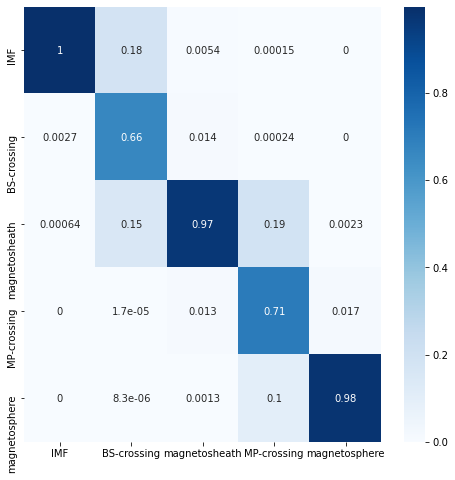

In [15]:
plot_cm(model, validation_loader)

In [16]:
def plot_field(df):
    fig = go.Figure()
    
    # Plotting components of the magnetic field B_x, B_y, B_z in MSO coordinates
    fig.add_trace(go.Scatter(x=df['DATE'], y=df['BX_MSO'], name='B_x'))
    fig.add_trace(go.Scatter(x=df['DATE'], y=df['BY_MSO'], name='B_y'))
    fig.add_trace(go.Scatter(x=df['DATE'], y=df['BZ_MSO'], name='B_z'))

    # Plotting total magnetic field magnitude B along the orbit
    fig.add_trace(go.Scatter(x=df['DATE'], y=-df['B_tot'], name='|B|', line_color = 'darkgray'))
    fig.add_trace(go.Scatter(x=df['DATE'], y=df['B_tot'], name='|B|', line_color = 'darkgray', showlegend=False))
    return fig

In [98]:
import plotly.graph_objs as go
total = correct = 0
orbit = 100
csv = f'../04-data/orbits/messenger-{orbit:04d}.csv'
csv_ = f'../03-notebooks/labelled_orbits/train/df_100.csv'
df = pd.read_csv(csv, sep = ',')
#df_ = pd.read_csv(csv_)
label = df_.LABEL
df["B_tot"] = (df["BX_MSO"]**2 + df["BY_MSO"]**2 + df["BZ_MSO"]**2)**0.5
features_list = ['X_MSO', 'Y_MSO', 'Z_MSO','BX_MSO', 'BY_MSO', 'BZ_MSO', 'VX', 'VY', 'VZ', 'EXTREMA', 'COSALPHA', 'RHO_DIPOLE']
# features = pd.read_csv(csv,  sep = ',')[features_list].values
# features = features.reshape(-1,4,3)
# features = torch.tensor(features).float().to(device)
# #features = features.reshape(len(features), 3,3)
# annotation = model(features.transpose(1,2))

# predicted = torch.argmax(annotation,1)
orbit = Magnetometer_data(csv, features_list)
annotation = []
for sample in orbit:
    coords = torch.tensor(sample['coords']).float().to(device)
    coords = torch.unsqueeze(coords,0)
    output = model(coords.transpose(1,2))
    predicted = output.argmax(1)
    annotation.append(predicted)
total = len(label)
correct = (annotation[:total] == label[:total]).sum().item()
print("Accuracy:", correct/total)
fig = plot_field(df)
df['Label'] = annotation
bowshock = df.loc[df['Label'] == 1]
magnetopause = df.loc[df['Label'] == 3]
    

for i in range(len(bowshock['DATE'])):
    fig.add_trace(go.Scatter(x=[bowshock['DATE'].iloc[i], bowshock['DATE'].iloc[i]],
                                 y=[-450, 450],
                                 mode='lines',
                                 name='Bow Shock',
                                 line_color='black',
                                 showlegend=False
        ))

for i in range(len(magnetopause['DATE'])):
        fig.add_trace(go.Scatter(x=[magnetopause['DATE'].iloc[i], magnetopause['DATE'].iloc[i]],
                                 y=[-450, 450],
                                 mode='lines',
                                 name='Magnetopause',
                                 line_color = 'purple',
                                 showlegend=False
        ))


#fig.update_layout({'title': f'Messenger orbit {orbit:04d} [learned]'})



<ipython-input-98-6f1c30ece51e>:21: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



Accuracy: 0.35228969204596744


In [99]:
total

28803

In [100]:
fig.show()

In [97]:
fig.show()

### Training RNN

In [ ]:
model = BidirectionalLSTM(3,3,5)
model.to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
train(model, optimizer, train_loader, validation_loader,epochs = 100, save = False)

In [ ]:
plot_cm(model,validation_loader)